In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import statsmodels.api as sm
import itertools
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error,mean_squared_error, r2_score
from tpot import TPOTRegressor
from sklearn.svm import LinearSVR
from sklearn import metrics
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer



In [2]:
#  PO_MSD Datei einlesen:
PO_MSD = pd.read_csv("retail_dataset.csv")


In [3]:
PO_MSD.head(10)

,date,product_category,reseller_name,reseller,sales,incident_start_date,incident_end_date,is_incident,incident_type,incident_hours,incident_days,is_holiday,holiday
0,2022-01-01,PO,CR_LI_HOL/Zalisz K,MSD,946.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,Neujahr
1,2022-01-04,PO,CR_LI_HOL/Zalisz K,MSD,624.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2022-01-07,PO,CR_LI_HOL/Zalisz K,MSD,890.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2022-02-15,PO,CR_LI_HOL/Zalisz K,MSD,1140.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2022-02-19,PO,CR_LI_HOL/Zalisz K,MSD,1283.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2022-02-22,PO,CR_LI_HOL/Zalisz K,MSD,903.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2022-02-26,PO,CR_LI_HOL/Zalisz K,MSD,1340.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2022-02-28,PO,CR_LI_HOL/Zalisz K,MSD,2002.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2022-03-02,PO,CR_LI_HOL/Zalisz K,MSD,601.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2022-03-05,PO,CR_LI_HOL/Zalisz K,MSD,1195.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
PO_MSD.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 422 entries, 0 to 421
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   date                 422 non-null    object 
 1   product_category     422 non-null    object 
 2   reseller_name        422 non-null    object 
 3   reseller             422 non-null    object 
 4   sales                422 non-null    float64
 5   incident_start_date  286 non-null    object 
 6   incident_end_date    286 non-null    object 
 7   is_incident          286 non-null    float64
 8   incident_type        286 non-null    object 
 9   incident_hours       212 non-null    float64
 10  incident_days        212 non-null    float64
 11  is_holiday           10 non-null     float64
 12  holiday              10 non-null     object 
dtypes: float64(5), object(8)
memory usage: 43.0+ KB


In [5]:
PO_MSD.isnull().sum()

date                     0
product_category         0
reseller_name            0
reseller                 0
sales                    0
incident_start_date    136
incident_end_date      136
is_incident            136
incident_type          136
incident_hours         210
incident_days          210
is_holiday             412
holiday                412
dtype: int64

In [6]:
# Replace NaN values with 0
PO_MSD["is_incident"].fillna(0, inplace=True)

# Convert the values to integers, removing decimals
PO_MSD["is_incident"] = PO_MSD["is_incident"].astype(int)

# Now you can check the value counts again
frq = PO_MSD["is_incident"].value_counts(dropna=False)
print(frq)

1    286
0    136
Name: is_incident, dtype: int64


In [7]:
#Change to datetime:
PO_MSD["date"]= pd.to_datetime(PO_MSD["date"])

# Konvertieren Sie die Spalte "date" in das gewünschte Monat-Jahr-Format und speichern Sie sie in einer neuen Spalte "Monat"
PO_MSD['Monat'] = pd.to_datetime(PO_MSD['date']).dt.to_period('M')

PO_MSD.head()

,date,product_category,reseller_name,reseller,sales,incident_start_date,incident_end_date,is_incident,incident_type,incident_hours,incident_days,is_holiday,holiday,Monat
0,2022-01-01,PO,CR_LI_HOL/Zalisz K,MSD,946.0,NaN,NaN,0,NaN,NaN,NaN,1.0,Neujahr,2022-01
1,2022-01-04,PO,CR_LI_HOL/Zalisz K,MSD,624.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,2022-01
2,2022-01-07,PO,CR_LI_HOL/Zalisz K,MSD,890.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,2022-01
3,2022-02-15,PO,CR_LI_HOL/Zalisz K,MSD,1140.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,2022-02
4,2022-02-19,PO,CR_LI_HOL/Zalisz K,MSD,1283.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,2022-02


In [8]:
# Replace NaN values with 0
PO_MSD["is_holiday"].fillna(0, inplace=True)

# Convert the values to integers, removing decimals
PO_MSD["is_holiday"] = PO_MSD["is_holiday"].astype(int)

# Now you can check the value counts again
frq = PO_MSD["is_holiday"].value_counts(dropna=False)
print(frq)

0    412
1     10
Name: is_holiday, dtype: int64


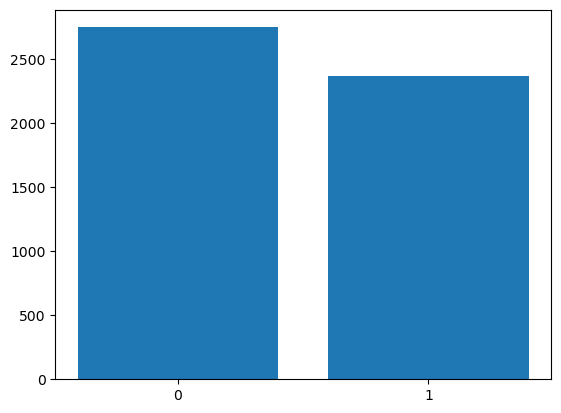

In [9]:
#  Is_incident Plot:

PO_MSD['is_incident'] = PO_MSD['is_incident'].astype(str)

plt.bar(PO_MSD['is_incident'],PO_MSD['sales'])
plt.show()

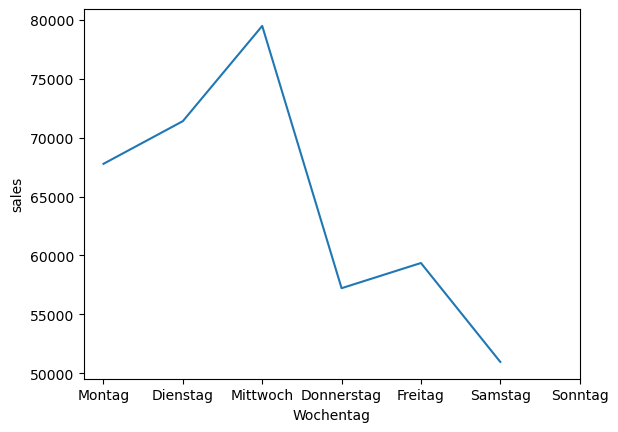

In [10]:
#PO_SC['date'] = pd.to_datetime(PO_SC['date'])

# Extrahiere die Wochentage für jede Zeile in der "Datum"-Spalte
PO_MSD['Wochentag'] = PO_MSD['date'].dt.day_name()

# Drucke den DataFrame mit der neuen "Wochentag" Spalte
#PO_MSD.head()


# Gruppieren Sie die Daten nach 'Wochentag' und berechnen Sie die Summe der Verkäufe für jeden Wochentag
Wochentag_group = PO_MSD.groupby('Wochentag')
sales = Wochentag_group['sales'].sum()
Wochentags = [Wochentag for Wochentag, _ in Wochentag_group]




# Plot der Daten
plt.plot(Wochentags, sales)
plt.ylabel('sales')
plt.xlabel('Wochentag')
#plt.xticks(rotation='vertical', size=8)

# Hinzufügen der Wochentagsnamen als X-Achsenbeschriftungen
wochentag_names = ['Montag', 'Dienstag', 'Mittwoch', 'Donnerstag', 'Freitag', 'Samstag', 'Sonntag']
plt.xticks(range(len(wochentag_names)), wochentag_names)

plt.show()

In [11]:
frq=PO_MSD["Wochentag"].value_counts(dropna=False)
frq

Saturday     71
Monday       71
Tuesday      70
Friday       70
Wednesday    70
Thursday     70
Name: Wochentag, dtype: int64

In [12]:
# Convert the "Monat" to datetime data type if it's not already
PO_MSD['Monat'] = PO_MSD['Monat'].dt.to_timestamp()

PO_MSD['Monat'] = pd.to_datetime(PO_MSD['Monat'])

# Use dt.month to extract the month number and categorize based on month number (1 to 12)
PO_MSD['Month_k'] = PO_MSD['Monat'].dt.month

# Print the DataFrame with the new "Month_k" column
PO_MSD.head()

,date,product_category,reseller_name,reseller,sales,incident_start_date,incident_end_date,is_incident,incident_type,incident_hours,incident_days,is_holiday,holiday,Monat,Wochentag,Month_k
0,2022-01-01,PO,CR_LI_HOL/Zalisz K,MSD,946.0,NaN,NaN,0,NaN,NaN,NaN,1,Neujahr,2022-01-01,Saturday,1
1,2022-01-04,PO,CR_LI_HOL/Zalisz K,MSD,624.0,NaN,NaN,0,NaN,NaN,NaN,0,NaN,2022-01-01,Tuesday,1
2,2022-01-07,PO,CR_LI_HOL/Zalisz K,MSD,890.0,NaN,NaN,0,NaN,NaN,NaN,0,NaN,2022-01-01,Friday,1
3,2022-02-15,PO,CR_LI_HOL/Zalisz K,MSD,1140.0,NaN,NaN,0,NaN,NaN,NaN,0,NaN,2022-02-01,Tuesday,2
4,2022-02-19,PO,CR_LI_HOL/Zalisz K,MSD,1283.0,NaN,NaN,0,NaN,NaN,NaN,0,NaN,2022-02-01,Saturday,2


In [13]:
frq= PO_MSD['Month_k'].value_counts(dropna=False)
frq

3     54
1     52
4     51
2     48
5     33
8     27
12    27
6     26
7     26
9     26
10    26
11    26
Name: Month_k, dtype: int64

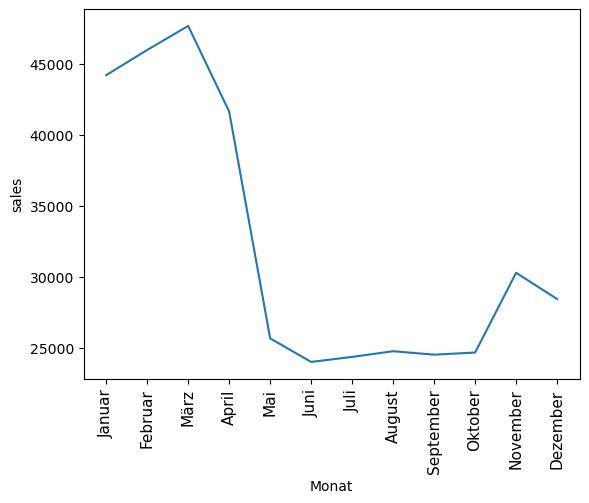

In [14]:
def get_month_name(month_num):
    months = ['Januar', 'Februar', 'März', 'April', 'Mai', 'Juni', 'Juli', 'August', 'September', 'Oktober', 'November', 'Dezember']
    return months[month_num - 1]  # Monatsnummern sind 1-basiert, daher müssen wir 1 abziehen

Monat_group = PO_MSD.groupby('Month_k')
sales = Monat_group['sales'].sum()
Monats = [get_month_name(month_num) for month_num in sales.index]

plt.plot(Monats, sales)
plt.ylabel('sales')
plt.xlabel('Monat')
plt.xticks(rotation='vertical', size=11)
plt.show()

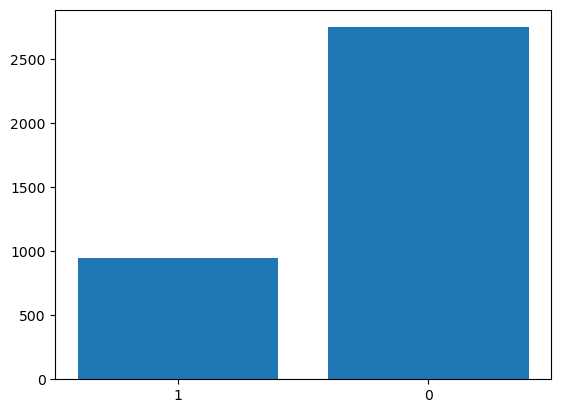

In [15]:
PO_MSD['is_holiday'] = PO_MSD['is_holiday'].astype(str)

plt.bar(PO_MSD['is_holiday'],PO_MSD['sales'])
plt.show()

In [16]:
# Erstellen Sie die Dummy-Variablen für "is_holiday"
holiday_dummies = pd.get_dummies(PO_MSD['is_holiday'], prefix='Holiday', drop_first=True)

# Erstellen Sie die Dummy-Variablen für "is_incident"
incident_dummies = pd.get_dummies(PO_MSD['is_incident'], prefix='Incident', drop_first=True)

# Erstellen Sie die Dummy-Variablen für "Wochentag"
weekday_dummies = pd.get_dummies(PO_MSD['Wochentag'], prefix='Weekdays', drop_first=True)

# Erstellen Sie die Dummy-Variablen für "Month_k"
month_dummies = pd.get_dummies(PO_MSD['Month_k'], prefix='Month', drop_first=True)

# Fügen Sie die Dummy-Variablen dem DataFrame hinzu
PO_MSD = pd.concat([PO_MSD, holiday_dummies, incident_dummies, weekday_dummies, month_dummies], axis=1)

PO_MSD.head()

,date,product_category,reseller_name,reseller,sales,incident_start_date,incident_end_date,is_incident,incident_type,incident_hours,...,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12
0,2022-01-01,PO,CR_LI_HOL/Zalisz K,MSD,946.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
1,2022-01-04,PO,CR_LI_HOL/Zalisz K,MSD,624.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
2,2022-01-07,PO,CR_LI_HOL/Zalisz K,MSD,890.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
3,2022-02-15,PO,CR_LI_HOL/Zalisz K,MSD,1140.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
4,2022-02-19,PO,CR_LI_HOL/Zalisz K,MSD,1283.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0


In [17]:
PO_MSD.columns

Index(['date', 'product_category', 'reseller_name', 'reseller', 'sales',
       'incident_start_date', 'incident_end_date', 'is_incident',
       'incident_type', 'incident_hours', 'incident_days', 'is_holiday',
       'holiday', 'Monat', 'Wochentag', 'Month_k', 'Holiday_1', 'Incident_1',
       'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday',
       'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3',
       'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9',
       'Month_10', 'Month_11', 'Month_12'],
      dtype='object')

In [18]:
PO_MSD.shape

(422, 34)

In [19]:
# Definiere die unabhängigen Variablen (X) und die abhängige Variable (y)
X = PO_MSD[['Holiday_1', 'Incident_1', 
             'Weekdays_Monday','Weekdays_Saturday','Weekdays_Thursday','Weekdays_Tuesday','Weekdays_Wednesday',
             'Month_2', 'Month_3', 'Month_4', 'Month_5','Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11','Month_12' ]]  
y = PO_MSD['sales']

# Füge eine Konstante hinzu, um den Intercept zu berücksichtigen
X = sm.add_constant(X)

# Erstelle und fitte das Regressionsmodell
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  sales   R-squared:                       0.345
Model:                            OLS   Adj. R-squared:                  0.315
Method:                 Least Squares   F-statistic:                     11.78
Date:                Tue, 25 Jul 2023   Prob (F-statistic):           1.75e-27
Time:                        04:12:36   Log-Likelihood:                -2957.6
No. Observations:                 422   AIC:                             5953.
Df Residuals:                     403   BIC:                             6030.
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                970.2206     55

In [99]:


# Define the independent variables (X) and the dependent variable (y)
X = PO_MSD[['Holiday_1', 'Incident_1', 
            'Weekdays_Monday','Weekdays_Saturday','Weekdays_Thursday','Weekdays_Tuesday','Weekdays_Wednesday',
            'Month_2', 'Month_3', 'Month_4', 'Month_5','Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11','Month_12' ]]  
y = PO_MSD['sales']

# Define the possible subsets of independent variables
subsets = []
for i in range(1, len(X.columns) + 1):
    subsets += list(itertools.combinations(X.columns, i))

# Define a function to fit and evaluate a linear regression model for a given subset of variables
def fit_and_evaluate_model(subset):
    X_subset = sm.add_constant(X[list(subset)])
    model = sm.OLS(y, X_subset).fit()
    return model.bic, model

# Perform best subset selection using the BIC score
best_models = {}
for subset in subsets:
    bic, model = fit_and_evaluate_model(subset)
    if len(best_models) == 0 or bic < min(best_models.keys()):
        best_models[bic] = model
    print(f'Subset: {subset} BIC: {bic:.2f}')

# Print the summary of the best model
best_model = best_models[min(best_models.keys())]
print(best_model.summary())

Subset: ('Holiday_1',) BIC: 6068.28
Subset: ('Incident_1',) BIC: 6095.50
Subset: ('Weekdays_Monday',) BIC: 6099.14
Subset: ('Weekdays_Saturday',) BIC: 6071.59
Subset: ('Weekdays_Thursday',) BIC: 6098.18
Subset: ('Weekdays_Tuesday',) BIC: 6102.10
Subset: ('Weekdays_Wednesday',) BIC: 6077.75
Subset: ('Month_2',) BIC: 6104.68
Subset: ('Month_3',) BIC: 6105.00
Subset: ('Month_4',) BIC: 6100.39
Subset: ('Month_5',) BIC: 6099.35
Subset: ('Month_6',) BIC: 6105.58
Subset: ('Month_7',) BIC: 6105.47
Subset: ('Month_8',) BIC: 6105.59
Subset: ('Month_9',) BIC: 6105.40
Subset: ('Month_10',) BIC: 6105.31
Subset: ('Month_11',) BIC: 6089.48
Subset: ('Month_12',) BIC: 6100.54
Subset: ('Holiday_1', 'Incident_1') BIC: 6057.00
Subset: ('Holiday_1', 'Weekdays_Monday') BIC: 6059.39
Subset: ('Holiday_1', 'Weekdays_Saturday') BIC: 6039.28
Subset: ('Holiday_1', 'Weekdays_Thursday') BIC: 6065.18
Subset: ('Holiday_1', 'Weekdays_Tuesday') BIC: 6068.59
Subset: ('Holiday_1', 'Weekdays_Wednesday') BIC: 6038.33
Subse

Subset: ('Holiday_1', 'Incident_1', 'Month_4') BIC: 6061.37
Subset: ('Holiday_1', 'Incident_1', 'Month_5') BIC: 6058.52
Subset: ('Holiday_1', 'Incident_1', 'Month_6') BIC: 6063.05
Subset: ('Holiday_1', 'Incident_1', 'Month_7') BIC: 6062.94
Subset: ('Holiday_1', 'Incident_1', 'Month_8') BIC: 6062.84
Subset: ('Holiday_1', 'Incident_1', 'Month_9') BIC: 6062.88
Subset: ('Holiday_1', 'Incident_1', 'Month_10') BIC: 6062.44
Subset: ('Holiday_1', 'Incident_1', 'Month_11') BIC: 6048.81
Subset: ('Holiday_1', 'Incident_1', 'Month_12') BIC: 6059.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday') BIC: 6016.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday') BIC: 6059.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday') BIC: 6062.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday') BIC: 6036.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2') BIC: 6065.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3') BIC: 6064.09
Subset: ('Holiday_1', 'Week

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday') BIC: 6059.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2') BIC: 6077.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3') BIC: 6078.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4') BIC: 6073.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_5') BIC: 6072.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_6') BIC: 6079.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_7') BIC: 6079.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_8') BIC: 6079.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_9') BIC: 6078.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_10') BIC: 6078.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_11') BIC: 6062.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_12') BIC: 6075.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday') BIC: 6096.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday') BIC: 6066.29
Subset: ('Inci

Subset: ('Weekdays_Monday', 'Month_7', 'Month_8') BIC: 6111.09
Subset: ('Weekdays_Monday', 'Month_7', 'Month_9') BIC: 6110.84
Subset: ('Weekdays_Monday', 'Month_7', 'Month_10') BIC: 6110.81
Subset: ('Weekdays_Monday', 'Month_7', 'Month_11') BIC: 6094.22
Subset: ('Weekdays_Monday', 'Month_7', 'Month_12') BIC: 6105.64
Subset: ('Weekdays_Monday', 'Month_8', 'Month_9') BIC: 6111.00
Subset: ('Weekdays_Monday', 'Month_8', 'Month_10') BIC: 6110.98
Subset: ('Weekdays_Monday', 'Month_8', 'Month_11') BIC: 6094.57
Subset: ('Weekdays_Monday', 'Month_8', 'Month_12') BIC: 6105.90
Subset: ('Weekdays_Monday', 'Month_9', 'Month_10') BIC: 6110.73
Subset: ('Weekdays_Monday', 'Month_9', 'Month_11') BIC: 6094.08
Subset: ('Weekdays_Monday', 'Month_9', 'Month_12') BIC: 6105.53
Subset: ('Weekdays_Monday', 'Month_10', 'Month_11') BIC: 6094.04
Subset: ('Weekdays_Monday', 'Month_10', 'Month_12') BIC: 6105.50
Subset: ('Weekdays_Monday', 'Month_11', 'Month_12') BIC: 6087.71
Subset: ('Weekdays_Saturday', 'Weekdays_

Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6') BIC: 6103.76
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_7') BIC: 6103.74
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_8') BIC: 6103.72
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_9') BIC: 6103.66
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_10') BIC: 6103.65
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_11') BIC: 6088.76
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_12') BIC: 6099.20
Subset: ('Weekdays_Thursday', 'Month_6', 'Month_7') BIC: 6110.12
Subset: ('Weekdays_Thursday', 'Month_6', 'Month_8') BIC: 6110.23
Subset: ('Weekdays_Thursday', 'Month_6', 'Month_9') BIC: 6109.97
Subset: ('Weekdays_Thursday', 'Month_6', 'Month_10') BIC: 6109.95
Subset: ('Weekdays_Thursday', 'Month_6', 'Month_11') BIC: 6093.84
Subset: ('Weekdays_Thursday', 'Month_6', 'Month_12') BIC: 6104.83
Subset: ('Weekdays_Thursday', 'Month_7', 'Month_8') BIC: 6110.16
Subset: ('Weekdays_Thursday', 'Month_7', 'Month_9') BIC: 6109.89
Subset: ('Weekdays_

Subset: ('Month_2', 'Month_3', 'Month_8') BIC: 6116.36
Subset: ('Month_2', 'Month_3', 'Month_9') BIC: 6116.14
Subset: ('Month_2', 'Month_3', 'Month_10') BIC: 6116.05
Subset: ('Month_2', 'Month_3', 'Month_11') BIC: 6099.71
Subset: ('Month_2', 'Month_3', 'Month_12') BIC: 6111.10
Subset: ('Month_2', 'Month_4', 'Month_5') BIC: 6104.64
Subset: ('Month_2', 'Month_4', 'Month_6') BIC: 6112.04
Subset: ('Month_2', 'Month_4', 'Month_7') BIC: 6112.00
Subset: ('Month_2', 'Month_4', 'Month_8') BIC: 6112.03
Subset: ('Month_2', 'Month_4', 'Month_9') BIC: 6111.95
Subset: ('Month_2', 'Month_4', 'Month_10') BIC: 6111.89
Subset: ('Month_2', 'Month_4', 'Month_11') BIC: 6096.60
Subset: ('Month_2', 'Month_4', 'Month_12') BIC: 6107.49
Subset: ('Month_2', 'Month_5', 'Month_6') BIC: 6110.95
Subset: ('Month_2', 'Month_5', 'Month_7') BIC: 6110.90
Subset: ('Month_2', 'Month_5', 'Month_8') BIC: 6110.94
Subset: ('Month_2', 'Month_5', 'Month_9') BIC: 6110.84
Subset: ('Month_2', 'Month_5', 'Month_10') BIC: 6110.77
Sub

Subset: ('Month_8', 'Month_9', 'Month_12') BIC: 6112.22
Subset: ('Month_8', 'Month_10', 'Month_11') BIC: 6100.78
Subset: ('Month_8', 'Month_10', 'Month_12') BIC: 6112.09
Subset: ('Month_8', 'Month_11', 'Month_12') BIC: 6094.71
Subset: ('Month_9', 'Month_10', 'Month_11') BIC: 6100.30
Subset: ('Month_9', 'Month_10', 'Month_12') BIC: 6111.73
Subset: ('Month_9', 'Month_11', 'Month_12') BIC: 6094.12
Subset: ('Month_10', 'Month_11', 'Month_12') BIC: 6093.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday') BIC: 6013.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday') BIC: 6049.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday') BIC: 6051.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday') BIC: 6024.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2') BIC: 6052.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3') BIC: 6052.73
Subset: ('Holiday_1', 'Inciden

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_8') BIC: 6022.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_9') BIC: 6022.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_10') BIC: 6021.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_11') BIC: 6003.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_12') BIC: 6014.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday') BIC: 6060.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday') BIC: 6026.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2') BIC: 6065.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3') BIC: 6064.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4') BIC: 6063.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5') BIC: 6060.61
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5') BIC: 6046.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_6') BIC: 6050.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_7') BIC: 6050.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_8') BIC: 6050.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_9') BIC: 6050.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_10') BIC: 6050.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_11') BIC: 6032.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_12') BIC: 6044.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4') BIC: 6046.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5') BIC: 6044.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_6') BIC: 6050.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_7') BIC: 6050.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2') BIC: 6035.08
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3') BIC: 6034.18
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4') BIC: 6032.78
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5') BIC: 6030.30
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6') BIC: 6035.33
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7') BIC: 6035.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8') BIC: 6035.50
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9') BIC: 6035.50
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10') BIC: 6035.04
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_11') BIC: 6016.38
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_12') BIC: 6029.10
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_11') BIC: 6069.34
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_12') BIC: 6078.72
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5') BIC: 6078.28
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6') BIC: 6083.74
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_7') BIC: 6083.78
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_8') BIC: 6083.67
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_9') BIC: 6083.76
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_10') BIC: 6083.40
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_11') BIC: 6068.55
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_12') BIC: 6077.92
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_6') BIC: 6081.49
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_7') BIC: 6081.51
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8') BIC: 6081.40
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_9') BIC: 6081.50
Subset: ('Holiday_1', 'Month_2', 'Month_5',

Subset: ('Holiday_1', 'Month_6', 'Month_10', 'Month_11') BIC: 6069.48
Subset: ('Holiday_1', 'Month_6', 'Month_10', 'Month_12') BIC: 6079.11
Subset: ('Holiday_1', 'Month_6', 'Month_11', 'Month_12') BIC: 6062.33
Subset: ('Holiday_1', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.31
Subset: ('Holiday_1', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.85
Subset: ('Holiday_1', 'Month_7', 'Month_8', 'Month_11') BIC: 6070.69
Subset: ('Holiday_1', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.11
Subset: ('Holiday_1', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.81
Subset: ('Holiday_1', 'Month_7', 'Month_9', 'Month_11') BIC: 6070.43
Subset: ('Holiday_1', 'Month_7', 'Month_9', 'Month_12') BIC: 6079.95
Subset: ('Holiday_1', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.66
Subset: ('Holiday_1', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.27
Subset: ('Holiday_1', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.57
Subset: ('Holiday_1', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.81
Subset: ('Holiday_1', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6') BIC: 6082.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7') BIC: 6082.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8') BIC: 6082.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9') BIC: 6082.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_10') BIC: 6082.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_11') BIC: 6065.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_12') BIC: 6078.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday') BIC: 6062.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2') BIC: 6083.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3') BIC: 6084.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4') BIC: 6078.78
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_11') BIC: 6086.95
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_12') BIC: 6098.29
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_7') BIC: 6107.49
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_8') BIC: 6107.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_9') BIC: 6107.08
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_10') BIC: 6107.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_11') BIC: 6092.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_12') BIC: 6104.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_8') BIC: 6107.48
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_9') BIC: 6107.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_10') BIC: 6107.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_11') BIC: 6092.12
Subset: ('Incident_1', 'Weekdays_Thursday', '

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4') BIC: 6107.50
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_5') BIC: 6105.86
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6') BIC: 6111.88
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_7') BIC: 6111.87
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_8') BIC: 6111.88
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_9') BIC: 6111.41
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_10') BIC: 6111.47
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_11') BIC: 6095.89
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_12') BIC: 6108.56
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_5') BIC: 6101.05
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_6') BIC: 6108.07
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_7') BIC: 6108.12
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_8') BIC: 6108.07
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_9') BIC: 6107.85
Subset: ('Incident_1', 'Month_2

Subset: ('Incident_1', 'Month_7', 'Month_8', 'Month_9') BIC: 6113.25
Subset: ('Incident_1', 'Month_7', 'Month_8', 'Month_10') BIC: 6113.30
Subset: ('Incident_1', 'Month_7', 'Month_8', 'Month_11') BIC: 6098.38
Subset: ('Incident_1', 'Month_7', 'Month_8', 'Month_12') BIC: 6110.54
Subset: ('Incident_1', 'Month_7', 'Month_9', 'Month_10') BIC: 6112.88
Subset: ('Incident_1', 'Month_7', 'Month_9', 'Month_11') BIC: 6097.62
Subset: ('Incident_1', 'Month_7', 'Month_9', 'Month_12') BIC: 6110.01
Subset: ('Incident_1', 'Month_7', 'Month_10', 'Month_11') BIC: 6097.68
Subset: ('Incident_1', 'Month_7', 'Month_10', 'Month_12') BIC: 6110.05
Subset: ('Incident_1', 'Month_7', 'Month_11', 'Month_12') BIC: 6093.87
Subset: ('Incident_1', 'Month_8', 'Month_9', 'Month_10') BIC: 6112.89
Subset: ('Incident_1', 'Month_8', 'Month_9', 'Month_11') BIC: 6097.72
Subset: ('Incident_1', 'Month_8', 'Month_9', 'Month_12') BIC: 6110.06
Subset: ('Incident_1', 'Month_8', 'Month_10', 'Month_11') BIC: 6097.78
Subset: ('Inciden

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5') BIC: 6104.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6') BIC: 6111.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7') BIC: 6111.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8') BIC: 6111.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_9') BIC: 6111.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_10') BIC: 6111.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_11') BIC: 6095.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_12') BIC: 6106.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5') BIC: 6098.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6') BIC: 6106.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7') BIC: 6106.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_8') BI

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6093.22
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_8') BIC: 6093.33
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_9') BIC: 6093.14
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_10') BIC: 6093.09
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_11') BIC: 6074.83
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_12') BIC: 6088.00
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6093.28
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_9') BIC: 6093.08
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6093.03
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6074.72
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6087.91
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_8'

Subset: ('Weekdays_Monday', 'Month_4', 'Month_10', 'Month_11') BIC: 6096.63
Subset: ('Weekdays_Monday', 'Month_4', 'Month_10', 'Month_12') BIC: 6107.49
Subset: ('Weekdays_Monday', 'Month_4', 'Month_11', 'Month_12') BIC: 6090.95
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7') BIC: 6110.44
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_8') BIC: 6110.43
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_9') BIC: 6110.40
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_10') BIC: 6110.38
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_11') BIC: 6095.08
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_12') BIC: 6105.94
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_8') BIC: 6110.41
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_9') BIC: 6110.36
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_10') BIC: 6110.34
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_11') BIC: 6094.92
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_11') BIC: 6068.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_12') BIC: 6081.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_10', 'Month_11') BIC: 6068.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_10', 'Month_12') BIC: 6081.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_11', 'Month_12') BIC: 6061.94
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2') BIC: 6066.00
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3') BIC: 6066.68
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4') BIC: 6060.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5') BIC: 6060.08
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6') BIC: 6067.00
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7')

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8') BIC: 6082.80
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9') BIC: 6082.63
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_10') BIC: 6082.67
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_11') BIC: 6065.20
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_12') BIC: 6078.00
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7') BIC: 6088.49
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8') BIC: 6088.58
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_9') BIC: 6088.23
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_10') BIC: 6088.30
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_11') BIC: 6069.30
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_12') BIC: 6082.84
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_8') BIC: 6088.54
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_9') BIC: 6088.18
Subset

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4') BIC: 6054.75
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5') BIC: 6053.87
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6') BIC: 6061.48
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7') BIC: 6061.54
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8') BIC: 6061.57
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9') BIC: 6061.37
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10') BIC: 6061.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_11') BIC: 6041.23
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_12') BIC: 6056.11
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3') BIC: 6108.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday'

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9') BIC: 6114.94
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10') BIC: 6114.91
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_11') BIC: 6097.89
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_12') BIC: 6109.36
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8') BIC: 6115.19
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9') BIC: 6114.82
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10') BIC: 6114.80
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_11') BIC: 6097.69
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_12') BIC: 6109.20
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9') BIC: 6115.02
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10') BIC: 6114.99
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_11') BIC: 6098.07
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_12') BIC: 6109.49
Sub

Subset: ('Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10') BIC: 6115.76
Subset: ('Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_11') BIC: 6099.39
Subset: ('Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_12') BIC: 6110.52
Subset: ('Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_11') BIC: 6099.35
Subset: ('Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_12') BIC: 6110.49
Subset: ('Weekdays_Thursday', 'Month_8', 'Month_11', 'Month_12') BIC: 6092.95
Subset: ('Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.77
Subset: ('Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_12') BIC: 6110.04
Subset: ('Weekdays_Thursday', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.22
Subset: ('Weekdays_Thursday', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.18
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6085.14
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6079.88
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6114.66
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6102.96
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6114.55
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_11', 'Month_12') BIC: 6097.12
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6') BIC: 6107.12
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7') BIC: 6107.23
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8') BIC: 6107.07
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6107.24
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6107.24
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_11') BIC: 6093.63
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6103.96
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6114.89
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6114.87
Subset: ('Weekd

Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6073.20
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6085.70
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6067.74
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6088.88
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6088.88
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6088.84
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6088.79
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6072.00
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6084.54
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6088.87
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6088.83
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6088.77
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') B

Subset: ('Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6113.55
Subset: ('Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6117.19
Subset: ('Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6117.28
Subset: ('Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6117.25
Subset: ('Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6103.23
Subset: ('Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6113.51
Subset: ('Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6117.18
Subset: ('Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6117.16
Subset: ('Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6103.34
Subset: ('Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6113.53
Subset: ('Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6117.24
Subset: ('Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6103.15
Subset: ('Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6113.47
Subset: ('Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6103.05
Subset: ('Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6113

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2') BIC: 6018.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3') BIC: 6018.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4') BIC: 6017.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5') BIC: 6014.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6') BIC: 6019.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7') BIC: 6019.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_8') BIC: 6019.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_9') BIC: 6019.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_10') BIC: 6019.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_11') BIC: 6001.7

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_9') BIC: 6059.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_10') BIC: 6059.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_11') BIC: 6044.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_12') BIC: 6055.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_9') BIC: 6059.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_10') BIC: 6058.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_11') BIC: 6044.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_12') BIC: 6055.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_9', 'Month_10') BIC: 6058.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_9', 'Month_11') BIC: 6044.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_9', 'Month_12') BIC: 6055.61
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_12') BIC: 6063.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_8') BIC: 6067.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_9') BIC: 6067.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_10') BIC: 6067.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_11') BIC: 6053.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_12') BIC: 6063.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_8', 'Month_9') BIC: 6067.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_8', 'Month_10') BIC: 6066.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_8', 'Month_11') BIC: 6053.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_8', 'Month_12') BIC: 6063.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_9', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_7', 'Month_8') BIC: 6073.92
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_7', 'Month_9') BIC: 6073.82
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_7', 'Month_10') BIC: 6073.33
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_7', 'Month_11') BIC: 6059.01
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_7', 'Month_12') BIC: 6070.35
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_8', 'Month_9') BIC: 6073.76
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_8', 'Month_10') BIC: 6073.27
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_8', 'Month_11') BIC: 6059.01
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_8', 'Month_12') BIC: 6070.31
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_9', 'Month_10') BIC: 6073.02
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_9', 'Month_11') BIC: 6058.35
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_9', 'Month_12') BIC: 6069.93
Subset:

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_7') BIC: 6027.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_8') BIC: 6027.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_9') BIC: 6027.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_10') BIC: 6027.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_11') BIC: 6007.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_12') BIC: 6019.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4') BIC: 6023.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5') BIC: 6020.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6') BIC: 6026.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7') BIC: 6027.09
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_10') BIC: 6070.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_11') BIC: 6055.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_12') BIC: 6064.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5') BIC: 6063.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6') BIC: 6069.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7') BIC: 6069.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_8') BIC: 6069.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_9') BIC: 6069.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_10') BIC: 6069.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_11') BIC: 6054.48
Subset: ('Holiday_1', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8') BIC: 6074.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_9') BIC: 6074.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_10') BIC: 6073.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_11') BIC: 6057.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_12') BIC: 6067.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6074.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6074.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6074.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6057.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6067.74
Subset: ('Holiday_1', 'Weekdays_Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_6') BIC: 6075.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7') BIC: 6075.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_8') BIC: 6075.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_9') BIC: 6075.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_10') BIC: 6074.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_11') BIC: 6059.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_12') BIC: 6068.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6') BIC: 6072.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7') BIC: 6072.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_8') BIC: 6071.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_9') BIC: 6072.08
Subset: ('Holiday_1', 'Weekdays_Monday',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_12') BIC: 6012.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3') BIC: 6052.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4') BIC: 6050.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5') BIC: 6048.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6') BIC: 6052.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7') BIC: 6053.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8') BIC: 6053.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9') BIC: 6052.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_10') BIC: 6052.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_11') BIC: 6034

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6') BIC: 6052.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7') BIC: 6052.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8') BIC: 6052.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_9') BIC: 6052.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_10') BIC: 6052.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_11') BIC: 6035.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_12') BIC: 6046.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6') BIC: 6050.97
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7') BIC: 6050.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8') BIC: 6050.91
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_11', 'Month_12') BIC: 6003.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4') BIC: 6052.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5') BIC: 6050.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6') BIC: 6055.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7') BIC: 6055.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8') BIC: 6055.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9') BIC: 6055.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_10') BIC: 6055.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_11') BIC: 6038.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_12') BIC: 6049.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5') BIC: 6048.12
Subse

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6') BIC: 6073.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7') BIC: 6073.23
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8') BIC: 6073.21
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9') BIC: 6073.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10') BIC: 6072.69
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_11') BIC: 6056.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_12') BIC: 6066.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4') BIC: 6069.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5') BIC: 6066.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6') BIC: 6072.29
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6036.00
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9') BIC: 6036.00
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6035.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6017.52
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6028.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6035.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_10') BIC: 6035.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_11') BIC: 6017.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_12') BIC: 6028.99
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_10') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.70
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.71
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.85
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6039.98
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6038.62
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6036.16
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6') BIC: 6040.89
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7') BIC: 6041.13
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6069.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6079.46
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6086.27
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6086.21
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6085.68
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6069.31
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6079.63
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6086.23
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6085.71
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6069.50
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6079.75
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6050.63
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6033.71
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6045.03
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6055.77
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6055.79
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6055.73
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6055.14
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6036.82
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6048.73
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6056.01
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6055.97
Subs

Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6084.28
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6084.01
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6084.32
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6084.18
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6070.56
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6079.49
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6089.79
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6089.69
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6089.77
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6089.38
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6074.31
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6083.80
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'M

Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6079.67
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6083.95
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6084.28
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6084.19
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6070.94
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6079.68
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6083.99
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6083.93
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6070.87
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6079.53
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6084.22
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6070.91
Subset: ('Holiday_1', 'Month_4', 'Month_5',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8') BIC: 6063.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_9') BIC: 6063.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_10') BIC: 6063.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_11') BIC: 6044.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_12') BIC: 6059.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3') BIC: 6075.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4') BIC: 6069.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5') BIC: 6068.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6') BIC: 6075.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_12') BIC: 6103.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4') BIC: 6103.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5') BIC: 6101.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6') BIC: 6109.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7') BIC: 6109.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8') BIC: 6109.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_9') BIC: 6108.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_10') BIC: 6108.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_11') BIC: 6093.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_12') BIC: 6105.73
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8') BIC: 6105.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_9') BIC: 6105.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_10') BIC: 6105.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_11') BIC: 6090.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_12') BIC: 6102.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7') BIC: 6112.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8') BIC: 6111.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_9') BIC: 6111.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_10') BIC: 6111.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_11') BIC: 6096.14
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6') BIC: 6111.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7') BIC: 6111.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_8') BIC: 6111.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_9') BIC: 6111.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_10') BIC: 6111.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_11') BIC: 6095.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_12') BIC: 6108.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5') BIC: 6100.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_6') BIC: 6108.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7') BIC: 6108.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_8') BIC: 6107.97
Subset: ('Incident_1', 'Weekd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6') BIC: 6087.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7') BIC: 6087.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8') BIC: 6087.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9') BIC: 6087.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_10') BIC: 6087.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_11') BIC: 6070.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_12') BIC: 6083.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2') BIC: 6062.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3') BIC: 6063.94
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7') BIC: 6089.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8') BIC: 6089.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9') BIC: 6088.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_10') BIC: 6088.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_11') BIC: 6070.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_12') BIC: 6085.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4') BIC: 6083.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5') BIC: 6083.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6') BIC: 6090.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7') BIC: 6090.42
Subset:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_11') BIC: 6053.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_12') BIC: 6068.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6072.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_9') BIC: 6071.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6071.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6053.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6068.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6071.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_10') BIC: 6071.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_1

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2') BIC: 6060.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3') BIC: 6061.63
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4') BIC: 6055.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5') BIC: 6054.18
Subset:

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6078.16
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6078.15
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9') BIC: 6077.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_10') BIC: 6077.95
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_11') BIC: 6060.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_12') BIC: 6074.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5') BIC: 6063.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6') BIC: 6072.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7') BIC: 6072.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8') 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8') BIC: 6107.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_9') BIC: 6107.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_10') BIC: 6107.86
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_11') BIC: 6094.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_12') BIC: 6105.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6') BIC: 6106.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7') BIC: 6106.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8') BIC: 6106.14
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9') BIC: 6106.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10') BIC: 6106.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_11') BIC: 6092.75
Subse

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6115.05
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6115.06
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6114.61
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6114.67
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11') BIC: 6098.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_12') BIC: 6111.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5') BIC: 6104.16
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6111.14
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6111.18
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6111.15
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6110.94
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6086.01
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6086.04
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6069.54
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6083.39
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6084.36
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6084.36
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6084.35
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6084.13
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6084.16
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6067.57
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6071.11
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6084.46
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6071.14
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6084.48
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6067.66
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6085.32
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6085.29
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6085.22
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6085.24
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6069.59
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') B

Subset: ('Incident_1', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6096.59
Subset: ('Incident_1', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6099.64
Subset: ('Incident_1', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6113.10
Subset: ('Incident_1', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6095.36
Subset: ('Incident_1', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.42
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6105.25
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6105.46
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6105.21
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6105.77
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6105.77
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6094.23
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6104.31
Subset: ('Incident_1', 'Mo

Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6116.58
Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6118.92
Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6103.60
Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6116.04
Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6103.66
Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6116.08
Subset: ('Incident_1', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6099.76
Subset: ('Incident_1', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6118.94
Subset: ('Incident_1', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6103.71
Subset: ('Incident_1', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6116.10
Subset: ('Incident_1', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6103.77
Subset: ('Incident_1', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.14
Subset: ('Incident_1', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9') BIC: 6079.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_10') BIC: 6079.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_11') BIC: 6060.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_12') BIC: 6073.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8') BIC: 6079.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_9') BIC: 6079.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_10') BIC: 6079.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_11') BIC: 6060.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_12') BIC: 6073.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9') BIC: 6066.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10') BIC: 6066.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_11') BIC: 6045.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_12') BIC: 6060.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4') BIC: 6059.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5') BIC: 6059.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6') BIC: 6067.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6067.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6067.45
Subset: ('Weekdays_Monday', 'Weekdays_Satur

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_10') BIC: 6078.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_11') BIC: 6058.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_12') BIC: 6072.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_9', 'Month_10') BIC: 6078.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_9', 'Month_11') BIC: 6057.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_9', 'Month_12') BIC: 6072.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_10', 'Month_11') BIC: 6058.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_10', 'Month_12') BIC: 6072.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_11', 'Month_12') BIC: 6050.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5') BIC: 6062.48
Subset: ('Weekdays_Monday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_9', 'Month_10') BIC: 6072.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_9', 'Month_11') BIC: 6054.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_9', 'Month_12') BIC: 6067.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_10', 'Month_11') BIC: 6054.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_10', 'Month_12') BIC: 6067.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_11', 'Month_12') BIC: 6048.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8') BIC: 6079.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_9') BIC: 6079.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_10') BIC: 6079.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_11') BIC: 6060.28
Subset: ('Weekdays_Monday', 'Weekdays_S

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10') BIC: 6113.71
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_11') BIC: 6096.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_12') BIC: 6108.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6113.87
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6113.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6113.63
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6096.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6108.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9') BIC: 6113.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8') BIC: 6110.69
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9') BIC: 6110.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10') BIC: 6110.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_11') BIC: 6094.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_12') BIC: 6105.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7') BIC: 6116.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8') BIC: 6117.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9') BIC: 6116.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10') BIC: 6116.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_11') BIC: 6099.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursda

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_11', 'Month_12') BIC: 6091.47
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7') BIC: 6111.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8') BIC: 6111.16
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9') BIC: 6111.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_10') BIC: 6111.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_11') BIC: 6095.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_12') BIC: 6106.50
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8') BIC: 6111.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9') BIC: 6111.08
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10') BIC: 6111.10
Subset: ('Weekdays_Monday', 'Weekdays_Thursd

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8') BIC: 6084.62
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9') BIC: 6084.58
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10') BIC: 6084.55
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11') BIC: 6066.80
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_12') BIC: 6080.31
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6091.63
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8') BIC: 6091.71
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9') BIC: 6091.56
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10') BIC: 6091.49
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6120.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6120.58
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6120.55
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6104.02
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6115.67
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6120.69
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6120.66
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6104.32
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6115.87
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6120.48
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6097.40
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.27
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.28
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.77
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.71
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6092.40
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6090.84
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6098.10
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6098.04
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6098.16
Subset: ('Weekdays_Monday', 'Weekdays_W

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6084.70
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6084.70
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11') BIC: 6069.62
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6081.30
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6093.71
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6093.70
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6093.68
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6093.65
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6076.89
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6089.36
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6115.14
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6115.10
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6115.11
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6115.09
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6099.74
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6110.70
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6121.82
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6122.00
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6121.73
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6121.70
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6104.54
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6',

Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6106.15
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6117.52
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6122.28
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6105.64
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6117.15
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6105.60
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.12
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6099.08
Subset: ('Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6122.42
Subset: ('Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.01
Subset: ('Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.41
Subset: ('Weekdays_Monday', 'Month_3', 'Month_8', '

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7') BIC: 6084.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8') BIC: 6084.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9') BIC: 6084.87
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_10') BIC: 6084.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_11') BIC: 6068.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_12') BIC: 6080.45
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7') BIC: 6091.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8') BIC: 6091.44
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9') BIC: 6091.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9') BIC: 6091.36
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10') BIC: 6091.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_11') BIC: 6072.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_12') BIC: 6086.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5') BIC: 6078.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6') BIC: 6085.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7') BIC: 6085.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8') BIC: 6085.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9') BIC: 6085.85
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10') BIC: 6085.91
Subset: ('Weekdays_Saturda

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9') BIC: 6086.36
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10') BIC: 6086.41
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_11') BIC: 6070.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_12') BIC: 6082.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9') BIC: 6086.34
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_10') BIC: 6086.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_11') BIC: 6070.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_12') BIC: 6082.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_10') BIC: 6086.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_11') BIC: 6069.73
Subset: ('Weekdays_Sat

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_12') BIC: 6067.84
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5') BIC: 6057.33
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6') BIC: 6066.16
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7') BIC: 6066.16
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8') BIC: 6066.15
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9') BIC: 6066.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10') BIC: 6066.12
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_11') BIC: 6047.84
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_12') BIC: 6062.04
Subset: ('Weekdays_Saturday', 'We

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6087.89
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6087.90
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8') BIC: 6087.87
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9') BIC: 6087.85
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6087.87
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_11') BIC: 6071.66
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6083.90
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6094.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6094.70
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6094.50
Subset: ('Weekdays_Saturday', 'Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6089.54
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6069.78
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6094.80
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6094.86
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6076.53
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_12') BIC: 6089.79
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6094.58
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.02
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.40
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.11
Subset: ('Weekdays_Saturday'

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6076.26
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6076.29
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6057.04
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6071.40
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6076.29
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6076.32
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6057.11
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6071.45
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6076.13
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6056.72
Subset: ('We

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11') BIC: 6056.52
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_12') BIC: 6071.19
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.95
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.08
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.85
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.42
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.50
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6079.15
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6087.91
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6087.92
Subset: ('Weekdays_Saturday', 'Month_2

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6094.09
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6094.17
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6074.78
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6088.54
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6094.19
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6094.27
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6074.97
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6088.69
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6093.88
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6074.31
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6088.17
Subset: ('Weekdays_Saturday', 'Mon

Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6072.12
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6084.71
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6072.20
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6084.77
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6066.38
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.28
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.32
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.45
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6084.93
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6089.18
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6072.06
Subset: ('Weekdays_Saturday', 

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10') BIC: 6059.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11') BIC: 6040.98
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_12') BIC: 6055.26
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6067.46
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8') BIC: 6067.50
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9') BIC: 6067.28
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10') BIC: 6067.32
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_11') BIC: 6046.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_12') BIC: 6061.90
Subset: ('Weekdays_Thursday', '

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6115.63
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6115.43
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6115.43
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6098.96
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6110.50
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6115.51
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6115.50
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6099.19
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6110.65
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6115.29
Subset: ('Weekdays_Thursday', 'We

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10', 'Month_11') BIC: 6098.64
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10', 'Month_12') BIC: 6110.43
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6092.20
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.08
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6110.00
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.51
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.50
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6078.56
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6077.26
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6084.66
Subset: ('Weekdays_

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7') BIC: 6070.36
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8') BIC: 6070.21
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6070.41
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6070.41
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11') BIC: 6055.11
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6066.85
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6079.79
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6079.77
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6079.73
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6079.73
Subset: ('Weekda

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6111.23
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6114.49
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6114.49
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6114.43
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6114.42
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6114.41
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6099.40
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6110.00
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6120.89
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6121.03
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6120.73
Subset: ('Weekdays_Thursday', 'Month_2'

Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6121.57
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6121.55
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6105.62
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6116.58
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6121.31
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6105.07
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6116.19
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6105.04
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6116.16
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6098.57
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6121.42
Subset: ('Weekdays_Thursday', 

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6091.08
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6090.97
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6070.75
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6085.68
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6091.17
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6091.06
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6070.91
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6085.80
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6090.87
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6070.59
Subset: ('Weekdays_Tue

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6081.28
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6085.39
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6067.47
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6081.17
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6067.36
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6081.09
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6061.87
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6092.32
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6092.17
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6092.08
Subset: ('Weekdays_

Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6119.56
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6119.66
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6119.63
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6105.37
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6116.03
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6119.62
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6119.71
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6119.68
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6105.27
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6116.01
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6119.62
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4

Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6120.89
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6125.59
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6108.57
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6120.55
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6108.41
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6120.42
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6102.13
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6125.74
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.87
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.78
Subset: ('Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6108.72
Subset: ('Weekdays_Tuesday', 'Month_6',

Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6091.27
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6095.00
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6079.06
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6091.21
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6078.96
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6091.16
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6073.70
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6093.94
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6093.90
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6093.93
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6093.90
Subset: ('Weekdays_We

Subset: ('Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.30
Subset: ('Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.34
Subset: ('Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.88
Subset: ('Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.81
Subset: ('Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.61
Subset: ('Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.10
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6114.34
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6114.52
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6114.20
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6114.57
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6114.60
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6

Subset: ('Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.01
Subset: ('Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.83
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6128.21
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6128.09
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6110.58
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6122.58
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6127.72
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6109.94
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6122.08
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6109.74
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6121.92
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6102.65
Subset: ('Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month

Subset: ('Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6098.83
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6116.62
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6116.63
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6103.56
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6113.42
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6116.83
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6103.47
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6113.47
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6103.40
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6113.44
Subset: ('Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6098.70
Subset: ('Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6116.64
Subset: ('Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_12') BIC: 6015.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7') BIC: 6025.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8') BIC: 6025.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_9') BIC: 6025.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_10') BIC: 6025.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_11') BIC: 6007.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_12') BIC: 6020.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8') BIC: 6025.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_9') BIC: 6025.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_11') BIC: 6042.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_12') BIC: 6053.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_7') BIC: 6061.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_8') BIC: 6061.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_9') BIC: 6061.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_10') BIC: 6061.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_11') BIC: 6046.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_12') BIC: 6057.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8') BIC: 6061

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6063.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6063.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6062.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6048.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6059.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_8', 'Month_9') BIC: 6063.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_8', 'Month_10') BIC: 6062.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_8', 'Month_11') BIC: 6048.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_8', 'Month_12') BIC: 6059.50
Subs

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_9') BIC: 6063.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_10') BIC: 6063.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_11') BIC: 6048.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_12') BIC: 6060.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5') BIC: 6058.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_6') BIC: 6063.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7') BIC: 6063.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_8') BIC: 6063.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_9') BIC: 6063.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_10')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_10', 'Month_12') BIC: 6061.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_11', 'Month_12') BIC: 6045.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_9', 'Month_10') BIC: 6064.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_9', 'Month_11') BIC: 6050.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_9', 'Month_12') BIC: 6061.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_10', 'Month_11') BIC: 6049.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_10', 'Month_12') BIC: 6061.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_11', 'Month_12') BIC: 6045.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_9', 'Month_10'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_11') BIC: 6034.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_12') BIC: 6045.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9') BIC: 6050.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_10') BIC: 6049.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_11') BIC: 6034.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_12') BIC: 6045.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_10') BIC: 6049.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_11') BIC: 6033.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_10', 'Month_11') BIC: 6034.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_10', 'Month_12') BIC: 6047.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_11', 'Month_12') BIC: 6029.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6025.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6023.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6021.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6') BIC: 6025.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7') BIC: 6025.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_11') BIC: 6032.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_12') BIC: 6044.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7') BIC: 6052.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8') BIC: 6052.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_9') BIC: 6052.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_10') BIC: 6052.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_11') BIC: 6035.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_12') BIC: 6048.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_8') BIC: 6052.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_9', 'Month_11') BIC: 6035.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_9', 'Month_12') BIC: 6047.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_10', 'Month_11') BIC: 6035.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_10', 'Month_12') BIC: 6047.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_11', 'Month_12') BIC: 6030.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7') BIC: 6048.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8') BIC: 6048.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9') BIC: 6049.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_10') BIC: 6048.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_12') BIC: 6060.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4') BIC: 6062.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5') BIC: 6059.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6') BIC: 6064.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7') BIC: 6064.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8') BIC: 6064.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9') BIC: 6064.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10') BIC: 6064.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_11') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_11') BIC: 6005.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_12') BIC: 6017.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6026.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8') BIC: 6026.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9') BIC: 6026.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_10') BIC: 6026.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_11') BIC: 6009.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_12') BIC: 6022.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8') BIC: 6072.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9') BIC: 6072.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10') BIC: 6072.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_11') BIC: 6058.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_12') BIC: 6069.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8') BIC: 6072.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9') BIC: 6072.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10') BIC: 6072.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_11') BIC: 6058.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_10', 'Month_12') BIC: 6069.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_11', 'Month_12') BIC: 6053.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9') BIC: 6073.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10') BIC: 6072.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_11') BIC: 6059.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_12') BIC: 6069.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_10') BIC: 6072.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_11') BIC: 6058.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_12') BIC: 6069.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6074.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6073.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11') BIC: 6059.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_12') BIC: 6070.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5') BIC: 6069.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6073.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6073.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6073.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6073.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6066.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6074.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6074.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6074.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6074.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6060.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6071.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6074.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6074.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11') BIC: 6026.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_12') BIC: 6039.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5') BIC: 6036.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6042.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6042.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6042.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6042.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6041.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6025.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6042.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6043.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6042.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6027.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6039.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6042.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6042.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6042.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11') BIC: 6027.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6064.05
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6074.68
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6074.64
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6074.40
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6074.22
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6074.66
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6074.38
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6061.47
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6071.93
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6079.28
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6076.96
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6079.75
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6079.42
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6066.41
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6076.86
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6079.55
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6066.09
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6076.83
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6065.49
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6076.33
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_6', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_10') BIC: 6033.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_11') BIC: 6014.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_12') BIC: 6026.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2') BIC: 6013.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3') BIC: 6012.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4') BIC: 6010.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5') BIC: 6007.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8') BIC: 6016.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9') BIC: 6016.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10') BIC: 6015.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_11') BIC: 5995.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_12') BIC: 6008.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3') BIC: 6032.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4') BIC: 6031.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5') BIC: 6028.35
Subset

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7') BIC: 6015.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8') BIC: 6015.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9') BIC: 6015.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_10') BIC: 6015.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_11') BIC: 5996.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_12') BIC: 6008.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6') BIC: 6012.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7') BIC: 6012.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7') BIC: 6029.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8') BIC: 6029.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_9') BIC: 6029.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_10') BIC: 6029.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_11') BIC: 6012.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_12') BIC: 6023.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6') BIC: 6026.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7') BIC: 6026.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8') BIC: 6026.47
Subset: ('Holiday_1', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_9') BIC: 6033.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_10') BIC: 6033.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_11') BIC: 6014.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_12') BIC: 6026.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_9') BIC: 6033.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_10') BIC: 6033.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_11') BIC: 6014.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_12') BIC: 6026.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_9', 'Month_10') BIC: 6033.50
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9') BIC: 6072.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10') BIC: 6071.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_11') BIC: 6055.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_12') BIC: 6065.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6072.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6072.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6071.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6055.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7') BIC: 6075.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8') BIC: 6075.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9') BIC: 6075.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10') BIC: 6075.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_11') BIC: 6059.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_12') BIC: 6068.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6') BIC: 6072.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7') BIC: 6072.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8') BIC: 6072.32
Subset: ('Holiday_1', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_11') BIC: 6060.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_12') BIC: 6069.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8') BIC: 6075.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9') BIC: 6075.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10') BIC: 6075.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_11') BIC: 6060.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_12') BIC: 6069.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9') BIC: 6075.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_10') BIC: 6075.42
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_11') BIC: 6022.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_12') BIC: 6035.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4') BIC: 6038.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5') BIC: 6035.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6') BIC: 6041.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6042.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6041.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9') BIC: 6042.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6079.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6062.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6072.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6080.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6079.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6062.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6073.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6079.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6062.63
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6048.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6048.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6048.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6048.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6047.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6030.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6041.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6053.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6053.46
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6045.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6051.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6051.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6051.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11') BIC: 6034.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_12') BIC: 6045.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9') BIC: 6051.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6051.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6034.59
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6062.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6071.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6061.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6071.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6054.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6082.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6082.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6082.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6065.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6075.38
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6065.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6075.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6081.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6065.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6075.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6065.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6074.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6057.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6081.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6081.03
Subset: 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6049.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9') BIC: 6056.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10') BIC: 6055.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_11') BIC: 6038.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_12') BIC: 6049.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10') BIC: 6055.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_11') BIC: 6038.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_12') BIC: 6049.32
Subset: ('Holiday_1', 'Weekdays_Saturday'

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9') BIC: 6054.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10') BIC: 6054.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_11') BIC: 6037.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_12') BIC: 6048.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7') BIC: 6058.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8') BIC: 6058.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9') BIC: 6058.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10') BIC: 6058.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_11') BIC: 6040.27
Subse

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_11') BIC: 6039.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_12') BIC: 6050.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_10') BIC: 6056.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_11') BIC: 6039.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_12') BIC: 6050.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_10', 'Month_11') BIC: 6039.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_10', 'Month_12') BIC: 6050.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_11', 'Month_12') BIC: 6032.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7') BIC: 6054.57

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5') BIC: 6023.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6') BIC: 6028.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6028.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6028.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9') BIC: 6028.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10') BIC: 6028.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_11') BIC: 6009.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_12') BIC: 6022.87
Subset: ('Holiday_1', 'Weekdays_Satur

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6042.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6054.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6060.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6042.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6054.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6041.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6053.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6033.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6049.74
Subset: 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6051.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6056.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6056.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6040.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6051.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6056.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6040.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6051.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6039.76
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6036.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6016.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6030.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6015.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6029.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6007.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6024.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6032.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7') BIC: 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6026.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6032.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6014.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6026.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6013.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6026.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6006.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6037.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC:

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6054.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6054.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6038.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6049.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6059.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6059.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6059.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6059.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6042.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 60

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6051.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6051.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6037.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6047.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6058.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6058.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6058.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6058.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6042.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 60

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6054.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6039.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6049.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6053.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6054.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6054.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6039.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6049.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6053.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6013.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9') BIC: 6013.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6013.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 5992.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6006.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6013.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10') BIC: 6013.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_11') BIC: 5992.90
Subset: ('Holiday_1', 'Weekdays_Thu

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6078.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6078.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6077.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6062.42
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6072.09
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6078.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6078.37
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6078.06
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6062.65
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6029.48
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6037.48
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7') BIC: 6037.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8') BIC: 6037.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6037.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6037.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11') BIC: 6021.13
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_12') BIC: 6031.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6034.4

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6036.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6018.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6030.01
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6018.35
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6029.58
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6010.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6041.77
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6041.73
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC:

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.37
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.01
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.67
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6077.93
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6077.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8'

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6084.37
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6084.09
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6069.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6078.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6084.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6083.94
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6069.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6078.40
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6084.06
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6044.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6044.66
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6044.33
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6025.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6038.68
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6042.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6042.19
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6042.15
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6042.21
Subset:

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6044.73
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6044.80
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6044.50
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6026.45
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6038.99
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6044.76
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6044.84
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6044.58
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11') BIC: 6026.77
Subse

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6083.16
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6086.04
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6086.00
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6085.79
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6086.03
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6085.86
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6071.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6081.02
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6091.06
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6091.00
Subset

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6071.95
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6081.25
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6071.47
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6080.90
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6065.38
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6091.21
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6091.31
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6090.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6075.69
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6085.50

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6084.21
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.64
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.90
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.02
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.73
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.41
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.24
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.83
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.23
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6057.88
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6057.72
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6057.92
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6057.74
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6041.63
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6052.62
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6055.17
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6055.13
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6054.97
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') 

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6061.75
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6061.14
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6042.60
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6054.64
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6061.77
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6061.19
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6042.77
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6054.75
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6061.09
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6049.85
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6032.57
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6061.05
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6061.12
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6060.73
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6043.66
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6054.98
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6061.06
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6060.69
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6035.22
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6059.49
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6042.97
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6054.09
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6042.31
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6053.59
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6035.37
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.16
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.53
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11'

Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6087.15
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6086.68
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6087.24
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6087.37
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6075.15
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6083.52
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6094.01
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6093.77
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6094.04
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6093.84
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6079.74
Subse

Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6078.18
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6087.68
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.47
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6087.10
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6070.39
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.14
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.32
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.72
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.64
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.17
Subset: ('Holiday_1', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.55
Subset: ('Holiday_1', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.98
Subset: ('Holiday_1', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.00
Subset: ('Holiday_1', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.23
Subset: ('Holiday_1', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.62
Subset: ('Holiday_1', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.27
Subset: ('Holiday_1', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.32
Subset: ('Holiday_1', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.86
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6089.97
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6090.32
Subset: ('Holiday_1', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3') BIC: 6080.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4') BIC: 6075.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5') BIC: 6074.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6') BIC: 6080.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7') BIC: 6080.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8') BIC: 6080.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9') BIC: 6080.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_10') BIC: 6080.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7') BIC: 6082.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8') BIC: 6082.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9') BIC: 6081.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_10') BIC: 6082.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_11') BIC: 6064.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_12') BIC: 6078.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5') BIC: 6067.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6') BIC: 6076.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_11') BIC: 6050.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_12') BIC: 6065.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6069.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_9') BIC: 6069.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6069.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6050.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6065.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6069.45
Subset: ('Incident_1', 'Weekdays_Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_10') BIC: 6082.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_11') BIC: 6063.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_12') BIC: 6078.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_9') BIC: 6082.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_10') BIC: 6082.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_11') BIC: 6064.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_8', 'Month_12') BIC: 6078.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_9', 'Month_10') BIC: 6081.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_9', 'Month_11') BIC: 6063.15
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10') BIC: 6111.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_11') BIC: 6095.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_12') BIC: 6108.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6112.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6111.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6111.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6095.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6108.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9') BIC: 6113.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10') BIC: 6113.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_11') BIC: 6097.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_12') BIC: 6109.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5') BIC: 6101.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6') BIC: 6109.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7') BIC: 6109.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8') BIC: 6109.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9') BIC: 6109.45
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_11') BIC: 6089.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_12') BIC: 6100.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7') BIC: 6110.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8') BIC: 6110.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9') BIC: 6110.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10') BIC: 6110.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_11') BIC: 6096.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_12') BIC: 6107.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8') BIC: 6110.53
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7') BIC: 6087.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8') BIC: 6087.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9') BIC: 6087.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_10') BIC: 6087.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_11') BIC: 6068.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_12') BIC: 6084.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4') BIC: 6083.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5') BIC: 6081.51
Subset: ('Incident_1', 'Weekdays_Monday', 'We

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6099.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6112.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6115.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6116.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6099.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6112.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6115.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6098.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6112.04
Subset: ('Incident_1

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6111.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6111.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6096.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6108.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6111.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6111.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6096.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6108.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6111.09
Subset: ('Incident_1'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6093.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6094.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6075.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6090.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6093.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6074.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6089.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6075.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6090.11


Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6088.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6072.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6086.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6088.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6088.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6072.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6086.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6088.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6072.37
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6095.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6106.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6106.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6106.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6106.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6106.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6092.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6104.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6114.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6113.98
Subse

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6104.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6104.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6104.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6105.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6105.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6093.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6103.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6114.02
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6097.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6109.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6098.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6109.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6094.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6112.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6097.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6109.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6098.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 610

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_12') BIC: 6089.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5') BIC: 6079.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6') BIC: 6087.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7') BIC: 6087.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8') BIC: 6087.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9') BIC: 6087.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10') BIC: 6087.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_11') BIC: 6071.58
Subset: ('Incident_1', 'Weekdays_Satu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6069.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6051.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6066.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6069.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_10') BIC: 6069.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_11') BIC: 6051.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_12') BIC: 6066.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_10') BIC: 6069.55
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_11') BIC: 6077.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_12') BIC: 6090.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9') BIC: 6094.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10') BIC: 6094.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_11') BIC: 6077.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_12') BIC: 6090.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10') BIC: 6093.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_11') BIC: 6076.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_12') BIC: 6

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_12') BIC: 6090.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_10', 'Month_12') BIC: 6090.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_11', 'Month_12') BIC: 6071.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_12') 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5') BIC: 6082.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6090.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6090.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6090.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6089.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6089.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6073.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6086.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6089.59
Subset:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6090.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6090.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6090.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6090.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6075.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6087.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6090.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6090.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6090.79
Subset

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5') BIC: 6062.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6071.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6071.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6071.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6070.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6070.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6052.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6067.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BI

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6071.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6054.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6068.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6071.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6071.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6071.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11') BIC: 6054.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_12') BIC: 6068.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9')

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6089.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6089.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6073.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6086.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6089.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6089.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6089.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6089.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6089.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_11'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6087.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6090.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6074.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6087.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6074.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6087.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6070.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6096.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6096.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6088.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6088.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6071.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.15
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_11',

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10', 'Month_12') BIC: 6063.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_11', 'Month_12') BIC: 6042.85
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6107.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6106.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6112.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6112.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6112.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6112.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_1

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6101.48
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6101.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_11') BIC: 6088.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6099.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6109.32
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6109.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6109.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6109.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6094.89
Subse

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6077.43
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6075.53
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6082.69
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6082.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6082.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6082.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6082.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11') BI

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6080.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6066.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6080.32
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_11', 'Month_12') BIC: 6061.49
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6') BIC: 6069.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7') BIC: 6069.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8') BIC: 6069.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6069.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6105.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6113.23
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6113.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6113.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6113.10
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6113.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6098.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6096.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6108.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6092.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6118.02
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6117.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6117.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6101.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6114.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6117.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Mont

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6112.15
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6098.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6109.63
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6098.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6109.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6094.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6119.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6118.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6119.00
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6100.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6111.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6096.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6114.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6100.29
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6111.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6100.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6111.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6096.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_10'

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6089.50
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6089.52
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6071.83
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6086.70
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6089.24
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6071.27
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6086.34
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6071.29
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_12') BIC:

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.13
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.16
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.42
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.03
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.52
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.34
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6112.91
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6115.18
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6099.71
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6112.48
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6099.77
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6112.52
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6096.06
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6121.28
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6120.75
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BI

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6117.85
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6103.92
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6115.62
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6117.79
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6103.47
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6115.42
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6103.51
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6115.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6100.13
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') B

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6122.14
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.38
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6119.23
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6106.43
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6119.27
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6102.48
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.61
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6118.69
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6101.57
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_10', 'Month_11', 'Month_

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6087.56
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6090.38
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6090.17
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6090.21
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11') BIC: 6073.54
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6087.55
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6090.16
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6090.20
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6073.57
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8'

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6090.60
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6075.45
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6088.43
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6090.54
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6090.56
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6075.45
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6088.40
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6090.56
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6075.07
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.04
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.56
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.71
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6092.96
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.12
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6090.51
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.15
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6090.53
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6073.60
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Mo

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.43
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.67
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.23
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.50
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.52
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.62
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6111.20
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6111.39
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6111.16
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6111.64
Subset: (

Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6117.95
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6102.77
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6115.25
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6102.84
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6115.30
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6099.05
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6117.94
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6102.86
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6115.28
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6102.93
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_1

Subset: ('Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6122.01
Subset: ('Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6105.81
Subset: ('Incident_1', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6108.84
Subset: ('Incident_1', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.45
Subset: ('Incident_1', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6104.83
Subset: ('Incident_1', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.86
Subset: ('Incident_1', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6108.96
Subset: ('Incident_1', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.51
Subset: ('Incident_1', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.02
Subset: ('Incident_1', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.06
Subset: ('Incident_1', 'Month_3', 'Month_9', 'Month_10', 'Month_11',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8') BIC: 6085.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9') BIC: 6085.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10') BIC: 6085.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_11') BIC: 6066.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_12') BIC: 6079.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5') BIC: 6069.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6') BIC: 6079.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7') BIC: 6079.

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6049.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6063.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6069.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_10') BIC: 6069.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_11') BIC: 6049.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_12') BIC: 6063.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_10') BIC: 6069.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10') BIC: 6085.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_11') BIC: 6066.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_12') BIC: 6079.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10') BIC: 6084.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_11') BIC: 6065.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_12') BIC: 6079.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_10', 'Month_11') BIC: 6066.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_10', 'Month_12') BIC: 6079.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6077.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6078.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6059.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6073.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6084.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6084.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6084.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6084.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6079.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6061.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6074.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6061.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6074.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6055.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6078.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6078.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6065.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6065.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6065.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6045.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6060.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6072.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6072.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6072.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_We

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9') BIC: 6066.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6066.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6048.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6062.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6066.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6048.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6062.24
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6048.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6077.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6077.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6059.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6072.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6084.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6084.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6084.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6084.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6064.37
Subset: ('Weekdays_Monday', 'Weekdays_Sat

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6060.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6073.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6060.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6073.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6054.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6085.71
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6085.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6085.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6066.32
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6061.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6074.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6061.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6074.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6055.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.87
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.46
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6071.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6065.47
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6064.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6') BIC: 6071.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7') BIC: 6071.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8') BIC: 6071.79
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9') BIC: 6071.53
Subset: (

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6118.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6118.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6100.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6112.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6118.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6118.50
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6118.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6100.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6113.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6113.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6113.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6097.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6108.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6113.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6113.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6113.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6090.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6090.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6070.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6084.22
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6090.50
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6090.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6090.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6070.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6084.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6083.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6083.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6083.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6066.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6079.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6084.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6083.93
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_We

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6122.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6105.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6117.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6122.31
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6104.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6116.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6104.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6116.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6097.61
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6104.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6116.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6104.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6097.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.34
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6118.08
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6106.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6118.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6100.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6106.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6099.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.51
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6101.31
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6112.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6101.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6112.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6095.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6117.02
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6101.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6112.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6101.57
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6096.30
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6076.02
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6090.89
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6096.50
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6096.42
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6076.22
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6091.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6096.20
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6090.65
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6090.61
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6090.58
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6072.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6086.29
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6090.62
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6090.59
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6072.78
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6107.83
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6120.11
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6100.90
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6113.74
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6113.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6113.64
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6113.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6113.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6099.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6099.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.60
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6111.52
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6111.70
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6111.36
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6111.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6111.76
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6099.01
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6108.93
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.19
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6102.81
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6113.81
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6113.59
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6113.83
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6113.83
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6100.06
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6110.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6098.67
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6120.54
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6104.78
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6116.08
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6104.74
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.06
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6099.01
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6104.40
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.84
Subset: ('Weekdays_Monday', 'Weekdays_Tu

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6090.62
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6090.49
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6090.64
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6090.63
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6075.01
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6087.03
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6099.25
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6099.28
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6099.20
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.07
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.94
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6088.52
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6088.59
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6088.33
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6088.65
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6088.67
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6074.73
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6085.88
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.26
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6090.66
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6090.49
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6090.68
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6090.69
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6075.66
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6087.34
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6090.54
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6090.72
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.02
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.88
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.57
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.82
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.53
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.00
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.53
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.35
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.60
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6105.76
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6116.74
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6121.07
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6105.37
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6116.53
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6105.34
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6116.51
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6099.16
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6127.86
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6127.56
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.18
Subset: ('Weekdays_Monday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6101.23
Subset: ('Weekdays_Monday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6101.17
Subset: ('Weekdays_Monday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.20
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6113.39
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6112.96
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6113.45
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6113.46
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6101.19
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6110.72
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6108.75
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6119.66
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6124.01
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6108.38
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6119.45
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6108.34
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6119.42
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6102.33
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6124.02
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.64
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.64
Subset: ('Weekdays_Monday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.80
Subset: ('Weekdays_Monday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6063.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6056.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6056.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6') BIC: 6063.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7') BIC: 6063.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6096.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6076.87
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6090.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6096.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6095.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6096.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6076.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6090.44
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6091.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6091.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6090.91
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6090.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6074.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6086.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6091.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6090.90
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6051.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6067.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6073.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6072.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6073.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6052.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6067.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6072.95
Subset: ('Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6067.00
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6048.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6062.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6067.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6066.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6067.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6048.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6062.38
Subset: ('Weekdays_Saturday', 'Weekdays_Th

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6097.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6078.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6091.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6078.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6091.63
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6070.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6084.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6084.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6083.99
Subset: ('Weekdays_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.46
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.55
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.79
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6082.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6082.03
Subset: ('Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.14
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.70
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.12
Subset: ('W

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6092.36
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6075.62
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.90
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6092.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6075.18
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6087.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6087.71
Subset: ('Weekdays

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6077.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6077.64
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6077.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6056.40
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6072.20
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6077.66
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6077.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6056.44
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', '

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6072.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6053.30
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6067.79
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6072.17
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6072.10
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6072.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6053.32
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6067.80
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6080.73
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6094.38
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6099.33
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6080.13
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6093.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6080.24
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6094.02
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6073.26
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6086.54
Subset: ('Weekdays_Saturda

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.74
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.83
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.83
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.18
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.32
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.90
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.04
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6084.38
Subset: ('Weekdays_Sa

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.42
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.28
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.49
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.89
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.77
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.12
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.25
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.36
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6086.57
Subset: ('Weekdays_Sa

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.45
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6094.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.43
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6090.20
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.50
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6090.26
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6071.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.70
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.53
Subset: ('Weekdays_Saturd

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6075.56
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6060.42
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6075.61
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6053.22
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6067.10
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6067.09
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6067.04
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6067.14
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6067.14
Subset: ('W

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.60
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.39
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.93
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.95
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.04
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6065.07
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6065.05
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6064.95
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6065.21
Subset: 

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6062.56
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.15
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.97
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.12
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.83
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.42
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.51
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6067.12
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6067.06
Subs

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6071.27
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6057.27
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6071.30
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6051.36
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.77
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.28
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6071.30
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6057.33
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6071.34
Subse

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6094.06
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6077.06
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6089.72
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6093.96
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6076.63
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6089.45
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6076.72
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6089.51
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6070.50
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6100.32
Subset: 

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.23
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6094.63
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.88
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.91
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.98
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6089.98
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6070.59
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.66
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.02
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.99
Subset:

Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6084.58
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6084.94
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6084.91
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6071.50
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6082.37
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6084.65
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6085.00
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6084.97
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6071.51
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6082.41
Subset: ('Week

Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6072.61
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.20
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.46
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.93
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.54
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.99
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.76
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.15
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.75
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.22
Sub

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8') BIC: 6057.01
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6057.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6057.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11') BIC: 6040.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6053.67
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6066.83
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6066.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6066.78
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'We

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.06
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6106.43
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6115.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6115.22
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6115.15
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6115.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6115.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6099.85
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6110.95
Subset: ('Weekdays_T

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6121.02
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6120.64
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6120.63
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6102.57
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6114.93
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6120.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6120.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6102.92
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6115.19
Subset: ('Weekdays_Thursday', '

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6121.45
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6104.80
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6116.45
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6121.53
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6121.53
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6105.05
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6116.62
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6121.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6104.54
Subset: ('Weekdays_Thursday',

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6100.94
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6112.05
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6095.23
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6100.57
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.83
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.71
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6115.73
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6115.66
Subset: ('Weekdays_Thu

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6084.56
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6067.42
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6080.11
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6083.30
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6083.31
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6083.28
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6083.24
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6083.24
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6065.78
Subset: ('Week

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6090.29
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6090.31
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6070.17
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6084.27
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6090.44
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6090.46
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6070.45
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6084.49
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6090.07
Subset: ('We

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6060.86
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6091.59
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6091.37
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6091.38
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6072.69
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6086.05
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6091.44
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6091.45
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6072.90
Subset: ('We

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.51
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.15
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6062.47
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.15
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.94
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.97
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.99
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6084.48
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6084.41
Subs

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6100.26
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6109.77
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6121.58
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6121.49
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6121.54
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6121.53
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6106.70
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6117.26
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6121.51
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6121.54
Subset: ('Weekd

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6111.07
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6114.59
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6114.80
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6114.80
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6100.98
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6111.07
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6114.61
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6114.61
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6101.05
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6111.01
Subset: ('Wee

Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6121.79
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6107.40
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6117.71
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6107.38
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.70
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.78
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6121.68
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6107.54
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.73
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6107.52
Subset

Subset: ('Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.95
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.12
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6114.54
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6114.82
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6114.82
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6101.62
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6111.38
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6114.58
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6114.58
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6101.62
Subset: (

Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.41
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.08
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6106.38
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6117.06
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6100.48
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.95
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6116.79
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6099.88
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.84
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6121.62
Su

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6083.61
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6083.54
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6083.63
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6083.63
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6067.22
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6080.25
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6091.95
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6091.97
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6091.91
Subset: ('Weekdays_Tuesda

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.92
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.58
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.35
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6081.43
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6081.48
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6081.35
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6081.55
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6081.60
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6066.94
Subset: ('Weekdays_

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.23
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.68
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.91
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.72
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6083.63
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6083.54
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6083.66
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6083.68
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6067.90
Subset: ('Weekday

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.26
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.42
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6073.32
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6087.14
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6073.21
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6087.06
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.56
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.43
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.42
Subset: ('Weekda

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6104.87
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6115.65
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6099.85
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6126.52
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6126.44
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6126.37
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6110.28
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6121.90
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6126.48
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6126.42
Subset: ('Weekdays_T

Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6111.14
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6121.95
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6106.01
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.91
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.86
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.64
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.50
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6124.92
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6124.98
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6124.95
Subset: ('Week

Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.95
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.37
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.27
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.11
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.17
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.49
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.57
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.42
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.96
Subset: ('Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6126.05
Subset: (

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6077.92
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6089.91
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6093.25
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6093.38
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6093.38
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6077.88
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6089.91
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6093.27
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6093.27
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6077.95
Sub

Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6097.25
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6084.92
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6097.19
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6079.51
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.01
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.00
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.16
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.29
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6101.05
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.9

Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.13
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.66
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.50
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.29
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.38
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.84
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.82
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.62
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.09
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BI

Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6100.79
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.54
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.38
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.42
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.29
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.57
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.82
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.71
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.47
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083

Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6115.89
Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.04
Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.68
Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.20
Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.51
Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.81
Subset: ('Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.56
Subset: ('Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.70
Subset: ('Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.89
Subset: ('Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.44
Subset: ('Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.20
Subset: 

Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6117.70
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.31
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6108.43
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.92
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6104.16
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.07
Subset: ('Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6129.21
Subset: ('Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6129.20
Subset: ('Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6115.29
Subset: ('Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6125.59
Subset: ('Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6129.29
Subset: ('Month

Subset: ('Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6124.84
Subset: ('Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.04
Subset: ('Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.45
Subset: ('Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.59
Subset: ('Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.50
Subset: ('Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.33
Subset: ('Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.72
Subset: ('Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.75
Subset: ('Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.88
Subset: ('Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.72
Subset: ('Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.16
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_10') BIC: 6025.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_11') BIC: 6009.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_12') BIC: 6021.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7') BIC: 6031.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8') BIC: 6031.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9') BIC: 6031.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_10') BIC: 6030.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6031.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6031.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6031.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6013.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6026.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_8', 'Month_9') BIC: 6031.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_8', 'Month_10') BIC: 6031.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_9', 'Month_12') BIC: 6009.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_10', 'Month_11') BIC: 5994.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_10', 'Month_12') BIC: 6008.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_11', 'Month_12') BIC: 5988.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4') BIC: 6027.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5') BIC: 6024.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6') BIC: 6030.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_12') BIC: 6025.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_9') BIC: 6030.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_10') BIC: 6030.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_11') BIC: 6013.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_12') BIC: 6025.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_9', 'Month_10') BIC: 6030.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_9', 'Month_11') BIC: 6013.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_9', 'Month_12') BIC: 6025.73
Subset: ('Holiday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_9', 'Month_12') BIC: 6025.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_10', 'Month_11') BIC: 6012.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_10', 'Month_12') BIC: 6025.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_11', 'Month_12') BIC: 6006.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_9') BIC: 6031.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_10') BIC: 6031.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_11') BIC: 6013.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_12') BIC: 6026.48
Subset: ('Holi

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_11') BIC: 6047.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_12') BIC: 6059.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8') BIC: 6062.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9') BIC: 6062.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_10') BIC: 6062.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_11') BIC: 6047.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_12') BIC: 6059.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_12') BIC: 6061.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5') BIC: 6059.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6') BIC: 6065.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7') BIC: 6065.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8') BIC: 6065.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9') BIC: 6065.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10') BIC: 6065.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_11') BIC: 6050.47
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_9') BIC: 6060.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_10') BIC: 6060.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_11') BIC: 6047.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_12') BIC: 6057.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7') BIC: 6066.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8') BIC: 6065.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9') BIC: 6066.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10') BIC: 6065.90
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6031.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6030.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6026.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6') BIC: 6031.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6049.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6060.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6068.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6068.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6068.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6067.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6052.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6064.27
Subset: ('Holiday_1', 'Inci

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6053.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6064.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6067.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6053.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6064.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6052.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6064.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6048.55
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6036.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6035.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6036.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6035.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6019.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6032.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6041.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6041.19
Subset: ('Hol

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6040.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11') BIC: 6024.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_12') BIC: 6037.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9') BIC: 6040.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6040.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6024.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6037.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6040.31
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6064.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6051.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6061.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6070.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6069.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6069.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6069.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6054.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_12')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6070.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6054.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6066.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6070.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6070.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6054.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6066.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6069.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_9', 'Month_11

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6070.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6070.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6070.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6056.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6067.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6070.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6070.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6056.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_12')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6055.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6066.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6055.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6066.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6051.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6066.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6050.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_10', 'Month_11', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6050.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2') BIC: 6002.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3') BIC: 6002.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4') BIC: 6001.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5') BIC: 5998.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4') BIC: 6017.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5') BIC: 6014.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6') BIC: 6020.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6020.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6020.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9') BIC: 6020.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_10') BIC: 6020.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8') BIC: 6055.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9') BIC: 6055.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10') BIC: 6054.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_11') BIC: 6038.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_12') BIC: 6050.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9') BIC: 6055.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10') BIC: 6054.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_11') BIC: 6038.34
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_10', 'Month_12') BIC: 6049.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_11', 'Month_12') BIC: 6032.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7') BIC: 6051.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8') BIC: 6051.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9') BIC: 6051.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_10') BIC: 6051.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_11') BIC: 6036.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_12') BIC: 6047.80
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10') BIC: 6022.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_11') BIC: 6004.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_12') BIC: 6019.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6') BIC: 6020.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7') BIC: 6019.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8') BIC: 6019.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9') BIC: 6020.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8') BIC: 6053.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6054.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6054.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_11') BIC: 6039.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_12') BIC: 6050.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6052.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6051.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8') BIC: 6051.70
Subset: ('Hol

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6037.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6049.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6037.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6049.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6032.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6058.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6057.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6057.66
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6012.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6026.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6011.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6026.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6006.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6021.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6028.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7') BIC: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6027.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6027.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6010.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6023.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6027.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6027.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6010.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_12') BIC: 60

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6041.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6053.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6057.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6040.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6053.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6040.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6053.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6035.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6053.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6040.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6053.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6035.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6057.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6040.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6053.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6040.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6037.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6058.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6058.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6043.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6054.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6058.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6042.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6054.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_7', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6039.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6051.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6054.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6054.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6039.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6051.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6054.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6039.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6006.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6006.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9') BIC: 6006.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10') BIC: 6005.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_11') BIC: 5987.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_12') BIC: 6002.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5') BIC: 5998.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6066.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6070.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6069.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6054.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6066.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6069.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6053.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6065.82
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6066.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6066.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6066.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6052.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6063.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6066.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6066.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6066.31
Subset: ('Ho

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6013.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6027.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6031.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6031.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6031.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6014.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6027.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 603

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6027.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6027.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6027.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6011.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6023.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6026.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6027.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6027

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6074.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6077.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6077.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6077.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6063.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6074.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6077.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6077.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6077.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6063.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6062.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6074.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6062.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6075.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6078.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6064.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6075.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6063.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6074.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6059.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6074.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6074.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6074.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6061.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6071.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8') BIC: 6030.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9') BIC: 6030.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6030.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 6015.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6028.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6036.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6036.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6036.43
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6036.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11') BIC: 6019.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_12') BIC: 6033.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9') BIC: 6037.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10') BIC: 6036.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11') BIC: 6019.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_12') BIC: 6033.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10') BIC: 6036.75
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6079.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6079.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6079.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6064.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6076.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6079.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6079.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6079.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6072.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6061.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6071.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6078.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6078.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6078.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6078.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6065.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6062.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6074.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6074.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6075.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6063.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6074.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6074.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6077.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6032.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6045.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6048.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6031.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6045.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6031.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6044.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6026.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_12') BIC: 6046.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6045.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6031.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6045.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6026.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6029.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6049.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6049.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6034.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6046.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6049.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6033.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6046.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6045.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6045.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6030.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6042.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6045.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6030.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6042.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6029.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6083.38
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6083.10
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6070.08
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6080.64
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6083.23
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6082.96
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6070.04
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6080.53
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6083.20
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3',

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.26
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.39
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.83
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.54
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.74
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.79
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.31
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6070.95
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.35
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.14
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.68
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.57
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.23
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.98
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.14
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.12
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.38
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.60
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 

Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.29
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.69
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.55
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.04
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.32
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.62
Subset: ('Holiday_1', 'Incident_1', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6081.96
Subset: ('Holiday_1', 'Incident_1', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6081.71
Subset: ('Holiday_1', 'Incident_1', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6069.23
Subset: ('Holiday_1', 'Incident_1', 'Month_5', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5') BIC: 6033.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6') BIC: 6039.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7') BIC: 6039.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8') BIC: 6039.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9') BIC: 6039.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10') BIC: 6038.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_11') BIC: 6019.52
Subset: ('Holiday_1', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7') BIC: 6013.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8') BIC: 6013.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9') BIC: 6013.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_10') BIC: 6013.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_11') BIC: 5994.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_12') BIC: 6006.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6019.29
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_10') BIC: 6035.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_11') BIC: 6018.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_12') BIC: 6029.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6') BIC: 6032.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7') BIC: 6032.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8') BIC: 6032.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9') BIC: 6032.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_11', 'Month_12') BIC: 6007.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8') BIC: 6039.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_9') BIC: 6039.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_10') BIC: 6039.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_11') BIC: 6020.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_12') BIC: 6031.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9') BIC: 6039.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6022.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9') BIC: 6022.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10') BIC: 6021.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_11') BIC: 6001.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_12') BIC: 6014.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9') BIC: 6022.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10') BIC: 6021.87
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6038.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6038.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6038.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6020.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6032.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6039.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6039.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_11') BIC: 6020.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_12') BIC: 6032.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_11') BIC: 6019.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6031.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6010.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6040.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6039.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_12') BIC: 6013.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6016.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6016.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8') BIC: 6016.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9') BIC: 6016.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6016.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 5998.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 5990.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6023.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6023.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6023.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11') BIC: 6003.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_12') BIC: 6016.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9') BIC: 6023.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6030.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6013.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6024.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6037.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6036.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6036.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6036.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6017.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6038.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6019.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6031.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6019.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6031.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6010.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6039.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6038.85
Subset: ('Holiday_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6034.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6034.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6034.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6016.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6027.88
Subset: ('Holiday_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6018.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6016.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6013.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6075.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6075.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6075.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6075.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6059.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6069.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6072.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6075.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6076.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6075.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6059.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6069.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6075.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6076.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10', 'Month_12') BIC: 6070.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6040.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6042.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6024.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6036.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6043.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6043.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6043.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6025.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6035.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6015.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6044.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6044.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6025.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_12') BIC: 6037.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6044.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6074.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6081.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6081.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6081.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6065.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6074.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6081.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_10') BIC: 6081.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6072.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6072.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6071.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6072.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6072.69
Subset: ('Holiday_1', 'Weekdays_Monday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6076.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6075.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6058.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.56
Subset: ('Holiday_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6078.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6078.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6063.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6072.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6078.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6063.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6072.24
Subset: ('Holiday_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6041.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6047.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6047.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6047.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6047.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6047.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11') BIC: 6028.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6028.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6041.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_11', 'Month_12') BIC: 6021.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6') BIC: 6040.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7') BIC: 6040.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8') BIC: 6040.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6040.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11') BIC: 6029.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11') BIC: 6029.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6077.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6059.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6081.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6081.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6081.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6081.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6065.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6074.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6078.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6078.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6060.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6065.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6075.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6081.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6081.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6065.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6075.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6081.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6065.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6055.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6039.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6050.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6052.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6052.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6052.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6052.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6052.35
Subset: ('Holiday_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6052.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6052.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6052.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6036.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6046.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6052.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6052.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6052.35
Subset: ('Holiday_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6028.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6057.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6057.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6057.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6040.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6051.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6057.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6057.34
Subset: ('Holiday_1', 'Weekdays_Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6059.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6059.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6041.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6052.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6059.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6041.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6052.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6040.17
Subset: ('Holiday_1', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6081.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6081.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6067.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6076.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6082.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6067.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6076.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6067.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6076.31
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6061.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.92
Subs

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.79


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4') BIC: 6008.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5') BIC: 6006.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6') BIC: 6012.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7') BIC: 6012.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8') BIC: 6012.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9') BIC: 6012.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10') BIC: 6012.32
Subset: ('Ho

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6061.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6061.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6042.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6054.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6061.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6061.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6061.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6058.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6042.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6052.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6041.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6052.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6034.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6057.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6027.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6009.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6021.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6025.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6025.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6025.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6025.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6028.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6027.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6009.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6021.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6028.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6028.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6028.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6060.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6060.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6044.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6055.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6058.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6058.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6058.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6058.85
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6054.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6042.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6053.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6035.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6064.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6064.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6046.08
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6058.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6058.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6058.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6043.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6053.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6058.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6058.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6043.43
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6056.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6062.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6045.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6056.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6045.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6055.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6037.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6062.16
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6047.15
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6023.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6034.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6034.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6034.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6034.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6015.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6028.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednes

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10') BIC: 6035.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11') BIC: 6015.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_12') BIC: 6029.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10') BIC: 6035.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_11') BIC: 6015.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_12') BIC: 6029.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_11') BIC: 6014.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6064.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6046.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6058.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6064.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6064.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6064.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6047.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6058.46
Subset: ('Holiday_1', 'Weekdays_Sa

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6041.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6051.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6062.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6062.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6062.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6062.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6046.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6057.71
Subset: ('Holiday_1', 'Weekdays_Sat

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6060.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6058.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6058.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6058.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6058.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6043.32
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6046.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6057.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6062.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6046.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6057.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6045.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6057.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6038.85
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6035.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6042.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6041.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6022.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6035.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6041.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6022.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6035.64
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6042.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6022.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_12') BIC: 6036.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6042.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6022.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6035.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6021.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6035.33
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6022.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6035.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6014.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6042.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6042.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6023.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6036.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6042.27
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6038.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6038.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6038.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6019.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6032.41
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6057.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6043.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6053.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6064.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6064.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6064.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6064.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6048.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 605

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6064.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6046.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6058.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6064.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6064.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6047.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6058.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 60

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6056.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6057.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6043.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6053.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6056.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6056.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6043.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6053.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 60

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6046.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6057.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6040.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6068.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6050.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6062.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6050.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6061.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6042.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9') BIC: 6011.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6011.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 5993.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6006.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6018.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6018.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6018.27
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 5994.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6007.38
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 5993.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6006.99
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 5985.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6019.29
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6019.26
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6077.27
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6077.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6062.76
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6072.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6082.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6082.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6082.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6082.53
Subset: ('Holiday_1', 'Weekdays_Thur

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.26
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.27
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6074.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6074.09
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.48
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6078.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6067.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6077.69
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6060.47
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.20
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.62
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.54
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.71
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6080.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6065.28
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6074.92
Subset: ('Holiday_1', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6043.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6043.51
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6043.35
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6026.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6037.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6040.42
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6040.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6040.20
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6024.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6035.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6023.46
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6035.04
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6015.43
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6047.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6047.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6046.67
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6040.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6023.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6034.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6040.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6040.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6040.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6024.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6034.92
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6022.35
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6033.04
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6021.99
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6032.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6015.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6044.99
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6045.11
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6044.83
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6047.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6028.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6040.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6047.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6028.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6040.26
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6027.72
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6088.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6074.30
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6082.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6088.30
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6074.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6083.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6073.69
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6082.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6092.51
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.21
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.23
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6086.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6092.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6086.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC:

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.51
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12')

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6074.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6083.13
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6088.37
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6074.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6083.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6074.13
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6082.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6067.42
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6073.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6081.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6086.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6073.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6081.95
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6073.03
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6081.68
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6066.68
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.97
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.92
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.97
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6050.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6050.57
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6050.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6050.24
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6031.49
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6044.44
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6050.64
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6050.70
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6052.24
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6051.93
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6033.91
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6046.39
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6051.97
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6033.81
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6046.36
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6033.04
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6048.35
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6048.08
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.09
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6042.62
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6048.30
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6048.03
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6030.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6042.61
Subset: ('Holiday_1', 'Wee

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6089.15
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6093.96
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6094.22
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6094.06
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6079.60
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6089.20
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6094.00
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6093.88
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6079.65
Subs

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6085.95
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6090.40
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6090.69
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6090.59
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6076.47
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6085.97
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6090.45
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6090.38
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6076.47
Subs

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.23
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.20
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.53
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.64
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.56
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.29
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.17
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.48
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6089.05
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6073.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6093.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.87
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6080.13
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6089.37
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6094.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6080.10

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.04
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.20
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.88
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.93
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.83
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.84
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.02
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC:

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.38
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.27
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.20
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.62
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.24
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6094.07
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.80
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6047.63
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6058.66
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6063.74
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6063.62
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6047.67
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6058.62
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6063.78
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6047.57
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6054.48
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6059.36
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6043.67
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6054.57
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6043.15
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6054.23
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6036.52
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6065.54
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6067.79
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6067.19
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6048.51
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6060.64
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6067.07
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6048.18
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6060.42
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6047.12
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6048.20
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.87
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6047.67
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6058.53
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6041.09
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6047.59
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.56
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.88
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.75
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.70
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.33
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6059.11
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6059.38
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6059.34
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6043.98
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6054.68
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Mont

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6062.79
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6046.19
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6057.37
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6062.87
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6046.07
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6057.34
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6045.37
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6056.80
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Mont

Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6099.77
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6100.05
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6099.87
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6085.70
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6094.88
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6099.80
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6099.67
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6085.78
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6094.84
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_1

Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6101.38
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.10
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.74
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.31
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.10
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.85
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.93
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.87
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.29
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11

Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.02
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6092.88
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.49
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6092.50
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.11
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.35
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.01
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.77
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.52
Subset: ('Holiday_1', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7') BIC: 6088.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8') BIC: 6088.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9') BIC: 6087.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10') BIC: 6087.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_11') BIC: 6069.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_12') BIC: 6083.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5') BIC: 6073.11
Subset: ('Incident_1', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6071.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8') BIC: 6071.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9') BIC: 6071.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_10') BIC: 6071.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_11') BIC: 6052.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_12') BIC: 6067.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8') BIC: 6071.98
Subset: ('

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_12') BIC: 6076.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7') BIC: 6088.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8') BIC: 6088.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9') BIC: 6087.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10') BIC: 6087.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_11') BIC: 6069.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_12') BIC: 6083.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10') BIC: 6087.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_11') BIC: 6068.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_12') BIC: 6083.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_10', 'Month_11') BIC: 6069.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_10', 'Month_12') BIC: 6083.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_11', 'Month_12') BIC: 6063.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9') BIC: 6087.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_11', 'Month_12') BIC: 6049.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6081.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6080.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6087.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6087.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6087.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6086.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6084.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6087.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6069.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6083.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6069.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6083.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_11', 'Month_12') BIC: 6064.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_12') BIC: 6083.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_11', 'Month_12') BIC: 6063.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6075.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6075.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6056.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6071.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6075.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6075.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6075.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednes

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6071.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6050.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6075.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6075.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6056.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_12') BIC: 6071.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6075.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_We

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6081.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_10') BIC: 6081.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_11') BIC: 6064.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_8', 'Month_12') BIC: 6077.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6081.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_9', 'Month_11') BIC: 6063.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6077.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6063.64
Subset: ('Incident_1', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6081.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6065.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6078.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6081.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6081.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6081.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6065.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6078.64
Subset: ('Incident_1', 'Weekdays_M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6070.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6073.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6073.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6073.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6058.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6070.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6073.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6073.33
Subset: ('Incident_1', 'Weekdays_Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6064.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6077.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6058.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.76
Subset: ('Incident_1', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_12') BIC: 6063.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6') BIC: 6065.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7') BIC: 6065.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8') BIC: 6065.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9') BIC: 6065.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10') BIC: 6065.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11') BIC: 6047.71
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6111.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6098.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6112.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6093.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6103.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6112.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7') BIC: 6112.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6111.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6111.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6096.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6108.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6111.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6096.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6108.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6088.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6069.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6084.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6087.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6068.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6083.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6068.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_We

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6066.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6079.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6082.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6082.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6082.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6066.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6079.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6119.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6103.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6115.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6118.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6101.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6115.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6102.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6115.35
Subset: ('Incident_1', 'Weekda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6101.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6114.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6101.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6115.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6096.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6118.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6101.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6115.08
Subset: ('Incident_1', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6117.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6120.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6104.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6117.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6105.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6100.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6120.51
Subset: ('Incident_1', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6100.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6111.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6114.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6114.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6100.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6111.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6114.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6099.61
Subset: ('Incident_1', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6089.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6089.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6088.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6088.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6071.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6086.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6087.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6089.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6089.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6073.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6087.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6089.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9') BIC: 6089.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10') BIC: 6089.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6117.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6102.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6115.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6115.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6115.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6115.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6115.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6115.81
Subset: ('Incident_1', 'Weekdays_Monday', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6113.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6096.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6122.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6121.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6122.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6105.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6118.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6121.97
Subset: ('Incident_1', 'Weekdays_Monday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6114.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6116.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6116.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6102.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6114.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6116.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6102.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6114.07
Subset: ('Incident_1', 'Weekdays_Monday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6116.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6104.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6116.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6100.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6119.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6119.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6104.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6116.78
Subset: ('Incident_1', 'Weekdays_Monda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6102.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6123.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6107.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6107.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6103.13
Subset: ('Incident_1', 'Weekdays_M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6093.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6093.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6093.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6093.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6076.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6090.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6093.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6093.57
Subset: ('Incident_1', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6093.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6096.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6080.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6093.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6080.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6093.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6077.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6094.01
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6094.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6078.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6092.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6094.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6078.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6091.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6078.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6092.01
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6119.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6104.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6116.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6119.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6119.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6104.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6116.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6119.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6104.04
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6098.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6110.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6112.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6112.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6098.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6110.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6112.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6098.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6110.11
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6101.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6113.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6123.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6123.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6106.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6120.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6122.

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6120.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6106.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6117.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6106.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6102.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6119.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.6

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6108.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6104.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6111.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6112.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6112.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6100

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5') BIC: 6050.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6') BIC: 6060.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7') BIC: 6060.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8') BIC: 6060.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9') BIC: 6060.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10') BIC: 6060.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_11') BIC: 6041.86
Subs

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6093.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6073.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6083.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6092.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7') BIC: 6092.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8') BIC: 6092.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6092.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tues

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6089.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6092.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6092.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6076.93
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6089.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6092.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6076.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6074.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6054.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6070.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6074.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6074.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6054.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6070.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6052.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6066.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6047.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6068.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6068.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6068.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6068.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6098.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6098.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6080.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6094.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6099.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6098.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6098.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6080.90
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6094.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6094.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_11', 'Month_12') BIC: 6074.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6098.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6099.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6080.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_12') BIC: 6094.86
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6100.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6083.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6096.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6100.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6100.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6083.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6096.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6100.00
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6078.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6091.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6078.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6091.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6074.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.40
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6072.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6072.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6060.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6076.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6060.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6076.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_11', 'Month_12') BIC: 6055.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6') BIC: 6065.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7') BIC: 6065.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Wee

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11') BIC: 6060.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_11', 'Month_12') BIC: 6055.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11') BIC: 6060.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6095.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6095.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6095.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6078.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6092.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6095.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6095.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6095.49
Subset: ('Incident_1', 'Week

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6093.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6076.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6095.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6095.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6095.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6095.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6080.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6092.93
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6074.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6086.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6071.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6096.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6096.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6096.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6081.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6093.88
Subset: ('Incident_1', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6098.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6084.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6098.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6079.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.64
Subset: ('Incident_1

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6077.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6076.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6076.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6058.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6073.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6076.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10') BIC: 6076.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11') BIC: 6058.90
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6076.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6077.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6060.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6074.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6076.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6076.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6076.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6060.61
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6068.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6068.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6069.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6069.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6053.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6066.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6068.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6068.97
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6059.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6076.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6073.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6055.06
Subse

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6095.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6079.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6092.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6095.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6079.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6092.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6079.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6092.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6089.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6074.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6086.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6089.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6073.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6086.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6074.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6086.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6082.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'M

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6081.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6066.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6064.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6072.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6072.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6072.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6071.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6071.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6073.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6073.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6054.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6069.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6073.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6053.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6069.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6073.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11') BIC: 6053.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_12') BIC: 6069.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11') BIC: 6053.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_12') BIC: 6069.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_11', 'Month_12') BIC: 6048.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'W

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6110.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6098.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6111.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6094.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6113.08
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6113.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6112.79
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6112.90
Subset: ('Incident_1', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6114.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6100.67
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6112.10
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6114.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6114.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6100.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6112.03
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6114.46
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6094.48
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6105.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6107.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6107.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6094.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6105.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6107.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6094.26
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6111.00
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6095.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6110.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.43
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6120.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6120.19
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6075.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6075.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6075.03
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6075.23
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6075.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6059.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6072.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6083.93
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.67
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6073.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6073.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6073.55
Subse

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.35
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6075.25
S

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.79
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6066.62
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6079.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.67
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6079.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.82
Subset

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6116.16
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6104.35
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6116.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6100.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6117.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6117.49
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6117.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6117.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_1

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6119.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6119.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6119.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6104.88
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6116.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6119.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6119.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6104.96
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12')

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6122.93
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6119.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6106.39
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6119.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6101.56
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'M

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6117.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6118.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6118.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6104.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6115.88
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6118.00
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6118.05
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6104.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12')

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6110.48
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6112.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6100.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6110.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6100.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6110.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6097.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6112.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.16
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6100.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6104.03
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.14
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6118.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6104.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', '

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6090.25
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6069.58
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6081.51
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6081.51
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6081.51
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6081.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6081.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6065.86
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.23
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.81
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.09
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6073.86
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.12
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.24
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.99
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6095.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6095.57
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.77
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6092.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6095.29
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.18
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6092.36
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.21
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.71
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6089.01
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6088.95
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6088.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6072.32
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6086.58
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6114.28
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6114.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6114.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6102.20
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6113.12
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6122.48
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6122.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6122.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6122.

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.37
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.99
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.04
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6115.86
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6115.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6115.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6115.99
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6102.70
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC:

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6105.62
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6118.50
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6105.68
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6118.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.84
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6121.22
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6105.70
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6118.53
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') B

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6109.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6120.94
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6123.01
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6109.30
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6120.89
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6109.33
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6120.91
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6106.09
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.72
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.77
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.80
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6127.94
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6112.42
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6125.15
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6112.47
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6125.18
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12'

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.21
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.36
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.38
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.01
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.21
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.47
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.49
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.75
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6097.65
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6081.53
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6095.21
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6097.60
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6097.63
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6081.56
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6095.20
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6097.50
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6090.19
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6090.20
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6075.48
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6088.27
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6090.13
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6090.14
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6075.48
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6088.23
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', '

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.25
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.98
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.18
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.79
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.12
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.15
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6102.22
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6102.27
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Mon

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6096.19
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6098.32
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.04
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.10
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.07
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.12
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6079.61
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.28
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.27
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.66
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.21
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.39
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.41
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.71
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.24
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.48
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.31
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.00
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.01
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.32
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6097.22
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6097.24
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6081.66
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6094.94
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Mont

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6125.33
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6125.36
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6125.39
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6111.28
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6123.10
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6125.28
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6125.30
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6111.34
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6123.07
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9'

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6129.03
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6112.53
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6125.89
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6112.61
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6125.95
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.15
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.37
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.09
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.76
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_10',

Subset: ('Incident_1', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.83
Subset: ('Incident_1', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.14
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6116.11
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6116.92
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6116.90
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6106.12
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6115.82
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6116.63
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6116.62
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Mont

Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6118.90
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.83
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.32
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6106.85
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6117.33
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.18
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6106.69
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.48
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.82
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_10',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6083.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6083.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6083.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10') BIC: 6083.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11') BIC: 6065.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6078.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6090.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6085.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6085.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6084.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10') BIC: 6085.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11') BIC: 6067.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_12') BIC: 6080.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8') BIC: 6085.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6074.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6074.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6052.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6068.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6074.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6074.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6052.99
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6049.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6063.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6050.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6064.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6043.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6067.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6067.92
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6090.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6089.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6090.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6069.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6084.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6090.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6089.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6089.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6090.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6069.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6083.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6089.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6090.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6069.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6079.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6083.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6083.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6066.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6079.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6083.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6066.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6067.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6080.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6067.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6080.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6061.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6084.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6078.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6058.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6073.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6078.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6078.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6078.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6058.11
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6050.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.47
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6078.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6057.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_12') BIC: 6073.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11') BIC: 6057.35
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_12') BIC: 6080.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6084.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11') BIC: 6066.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6079.71
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6066.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6079.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6059.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6084.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6067.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6080.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6084.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6084.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6084.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6067.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12')

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6076.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6076.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6076.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6060.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6072.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6076.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6076.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6091.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6063.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6063.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6063.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6063.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6063.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6046.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6059.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6048.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6061.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6061.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6073.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6051.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_10

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6067.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6046.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6072.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6072.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6053.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6067.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6072.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6079.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6084.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6066.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6079.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6066.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6079.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6059.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6083.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6059.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6072.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6059.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6072.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6054.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6085.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6084.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6085.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6090.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6090.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6069.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6084.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6067.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6067.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6061.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6084.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6066.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6084.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6079.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_12') BIC: 6065.81
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6077.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6077.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6077.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6077.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 6055.71
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6071.55
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6071.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6053.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6067.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6071.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6053.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6067.47
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6053.12
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6124.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6124.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6124.47
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6106.78
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6118.93
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6124.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6124.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') B

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6118.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6105.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6118.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11', 'Month_12') BIC: 6098.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6124.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6124.55
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6106.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6125.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6125.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6108.70
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6120.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6125.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6108.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6119.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6115.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6104.69
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6115.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6098.81
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6104.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.63
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6098.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6119.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.69
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.74
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6080.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6090.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6090.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4'

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6089.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11') BIC: 6071.10
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6084.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6089.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6089.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6071.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6084.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6089.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6089.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6089.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6089.20
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6072.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6084.85
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6089.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6074.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6086.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6091.46
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6091.47
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6074.31
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6086.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6091.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.20
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.96
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.89
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_10

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6122.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6128.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6110.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6122.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6110.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6122.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6102.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6128.48
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6101.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6107.39
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6118.78
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6122.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6122.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6122.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6114.06
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6101.78
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6111.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6113.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6114.20
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6114.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6101.79
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6111.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3'

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6107.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6117.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6101.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6107.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.70
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6101.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6101.04
Subset: ('Weekdays_Monday', 'Weekdays_Thursday',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6109.04
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6119.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6109.07
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6119.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6102.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6124.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6109.29
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.07
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.70
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.57
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6104.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.02
Subset: ('Weekdays_Monday', 'Weekdays_Tuesd

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6096.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11') BIC: 6077.19
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6091.35
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6096.09
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6096.04
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6077.33
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6091.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6078.52
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6091.81
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6095.72
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6095.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6095.73
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6078.48
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6091.79
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6093.65
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6097.74
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6079.92
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6093.54
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.84
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6093.48
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6074.18
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8'

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.07
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.87
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.12
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.80
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.30
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.28
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6131.54
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6113.53
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6126.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6113.47
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6125.95
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6106.25
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6131.72
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6131.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.89
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6126.20
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6126.08
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6126.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6109.38
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6121.19
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6126.15
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6126.13
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6117.28
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6117.70
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6117.71
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6105.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6114.97
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6117.34
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6117.36
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6104.97
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6110.50
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6121.52
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.96
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.21
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.39
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6104.51
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.47
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6132.66
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3'

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.40
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6101.17
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.87
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6116.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.90
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.87
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6128.09
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6128.07
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.19
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.42
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.79
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.37
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.86
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.12
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.99
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6089.77
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6103.85
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6082.32
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6109.83
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6109.77
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6090.28
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6104.23
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6109.50
Subset: ('Weekdays_Monday', 'Weekdays_Wednesda

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6103.64
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6103.52
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6103.48
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6085.32
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6098.60
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6103.58
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6103.55
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6085.57
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', '

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6094.56
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6094.59
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6080.77
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6091.90
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6094.29
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6094.32
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6080.72
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6091.74
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.71
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.11
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.66
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.08
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.00
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.40
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.96
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.61
Subset: ('Weekdays_Monday', 'Weekdays_Wedn

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.53
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.48
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6105.74
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6105.71
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6088.72
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6101.37
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6105.67
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6088.42
Subset: ('Weekdays_Monday', 'Weekdays_Wednesda

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.29
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.47
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6105.21
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6084.47
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.96
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.82
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.84
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.72
Subset: ('Weekdays_Monday', 'Weekdays_We

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6111.39
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6122.63
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6127.14
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6127.13
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6111.70
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6122.77
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6127.11
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6111.26
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6122.55
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6107.45
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6118.00
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6101.98
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6121.60
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6121.60
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6107.57
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6118.00
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6121.79
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6107.36
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6125.08
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6129.05
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6114.20
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6124.97
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6114.18
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6124.95
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6108.34
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6128.94
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6114.41
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.07
Subset: ('Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.89
Subset: ('Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.07
Subset: ('Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.02
Subset: ('Weekdays_Monday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.17
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.75
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.66
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.66
Subset: ('Weekdays_Monday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.61
Subset: ('Weekda

Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.61
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.18
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.14
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.51
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.15
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.46
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.88
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.84
Subset: ('Weekdays_Monday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.18
Subset: ('Weekd

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6070.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6070.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6070.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6049.75
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6065.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6070.31
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6070.39
Subset: ('Weekdays_Satu

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6064.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6041.90
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6070.48
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6070.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6049.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_12') BIC: 6065.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6070.31
Subset: ('Weekdays_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11') BIC: 6079.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_12') BIC: 6091.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6096.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11') BIC: 6078.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6091.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6078.75
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6091.63
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6080.05
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6092.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6095.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6095.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6080.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6092.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6095.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6085.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6088.76
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6073.67
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6085.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6073.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6085.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6068.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', '

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.40
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6103.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6103.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6084.59
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.87
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.87
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Mo

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6064.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6047.21
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6060.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6072.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6072.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6072.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6072.91
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.16
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6057.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.66
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6059.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6074.24
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6059.78
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6074.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6052.70
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6079.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6080.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.36
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6055.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6068.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6055.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6059.63
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6074.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.46
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6083.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6097.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6083.71
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6097.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6076.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6103.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6103.40
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6084.23
Subset: ('Weekdays_Saturday', 'Weekday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.81
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.31
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6097.96
Subset: ('Weekdays_Saturday', 'We

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.76
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.64
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.62
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6087.83
Subset: ('Weekdays_Saturday', '

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6093.45
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6097.54
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6081.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6093.24
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6081.18
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6093.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6075.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.51
Subset: ('Weekdays_Saturday', 'Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.45
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.77
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.56
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.78
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.21
Subset: ('Weekdays_Saturday', 'Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.35
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.54
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.45
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.82
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.57
Subset: ('Weekdays_Saturday', 'Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_12') BIC: 6073.23
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6077.60
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11') BIC: 6058.08
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6073.04
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6058.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6073.07
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6051.91
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6073.50
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6077.18
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6077.18
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6059.59
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6073.51
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6077.20
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6059.40
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6066.17
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6069.41
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6052.71
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6066.19
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6052.72
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6066.19
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6048.01
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6064.10
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6079.57
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6084.56
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6063.72
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6079.28
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.76
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.31
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6095.23
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6099.45
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6081.98
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6094.97
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6082.07
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6095.03
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6075.87
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6105.78
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesda

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6082.66
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6095.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6100.09
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6082.20
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.40
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6082.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6095.46
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6075.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.90
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.86
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.01
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.68
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.06
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.10
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.25
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.38
Subset: ('Weekdays_Saturday', 'Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6095.86
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6077.77
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6099.91
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6099.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6083.61
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6095.97
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6099.90
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.43
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.73
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6089.45
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6072.94
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6092.63
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.70
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.39
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.74
Subset: ('Weekdays_Saturday', 'Weekdays_Tues

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.01
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.95
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.05
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.14
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.07
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.10
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.21
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.64
Subset: ('Weekdays_Saturday', 'Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6087.16
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6066.15
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6081.57
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6087.17
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6087.22
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6066.26
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6081.65
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6086.92
Subset: ('Weekdays_Saturday', 'We

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.45
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.28
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.76
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6062.34
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.80
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.87
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.94
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.54
Subset: ('Weekdays_Saturday

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.03
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.13
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.40
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6070.88
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6070.78
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6071.06
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6071.04
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6056.31
Subset: ('Weekdays_Saturday', 

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.18
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.94
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.39
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.03
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.18
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.93
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.23
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.96
Subset: ('Weekdays_Saturday

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6057.11
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.97
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.31
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.99
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.98
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.06
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.10
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6082.06
Subset: ('Weekdays_Saturd

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.59
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.70
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.66
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.76
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.61
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.16
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.37
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.99
Subset: ('Weekdays_Saturda

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6100.16
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6100.07
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6100.11
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6082.80
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6095.66
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6100.07
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6100.11
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6082.93
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6095.72
Subset: ('Wee

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6089.67
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6093.16
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6077.62
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6089.62
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.68
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6089.65
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6072.32
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6093.06
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.06
Subset: 

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.27
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.87
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.01
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.55
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.16
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.53
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.27
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.61
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.50
Sub

Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6084.51
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6096.50
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6100.21
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.20
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.38
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6084.27
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.42
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6078.63
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.16
Subset:

Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.25
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.50
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.65
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.82
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.39
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.74
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.89
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.07
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.7

Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.50
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.45
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.20
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.31
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.63
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.53
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.38
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.50
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.8

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_12') BIC: 6067.50
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6072.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11') BIC: 6052.38
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6067.27
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6052.44
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6067.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6045.75
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mon

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6071.95
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6071.95
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6053.99
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6067.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6071.91
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6071.92
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6054.03
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4'

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6063.13
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6063.12
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6046.39
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6059.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6063.05
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6063.04
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6046.39
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5'

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.36
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6066.99
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.00
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.08
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6079.24
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6079.28
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.32
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Mo

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6104.52
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6115.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6120.36
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6120.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6104.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6115.98
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6120.30
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6104.30
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday',

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6117.11
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6105.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6117.10
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6098.98
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6122.06
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6122.05
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6105.77
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6117.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesda

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6107.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.36
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6107.71
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6100.23
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6106.93
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6119.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6099.28
Subset: ('Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6105.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6116.66
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6120.69
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6105.52
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6116.52
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6105.51
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6116.52
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6099.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6114.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6114.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6100.76
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6111.03
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6114.58
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6100.66
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6111.08
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6100.65
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday'

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6121.57
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6105.63
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6116.98
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6105.62
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.97
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6099.64
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.19
Subset: ('Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6066.36
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6078.57
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6066.37
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6078.57
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6060.80
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6091.36
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6091.24
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6091.25
Subset: ('Weekdays_Thursday', '

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.76
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.29
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.78
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.81
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6096.26
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.27
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6075.79
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.10
Subset: ('Weekdays_Thursday'

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6090.84
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6090.84
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6074.53
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6086.80
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6090.90
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6074.24
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6086.69
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6074.26
Subset: ('Weekdays_Thursday', 'W

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.63
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.36
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.30
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.33
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.28
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.27
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.82
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.29
Subset: ('Weekdays_Thursda

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.12
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.37
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.13
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.15
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.98
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.90
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.60
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.62
Subset: ('Weekdays_Thurs

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6118.21
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6118.70
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6118.71
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6106.29
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6115.80
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6118.33
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6118.34
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6106.24
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6115.60
Subset: ('Wee

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6117.03
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6106.78
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.02
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.26
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6120.65
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.90
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6117.00
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6106.88
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.99
Subse

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.10
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.06
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.37
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.72
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.60
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.55
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.70
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6132.22
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.91


Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.82
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.37
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.82
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.41
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.36
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.44
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.17
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.67
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.1

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6082.30
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6097.45
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6102.94
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6102.84
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6082.47
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6097.58
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6102.66
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6082.12
Subset: ('Weekdays_Tuesday', 'Weekdays_We

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.07
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.35
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.93
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.25
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.72
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.67
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.09
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.37
Subset: ('Weekdays_Tuesday', 'Week

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.48
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.23
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.07
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.64
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.71
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.47
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.99
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6087.28
Subset: ('Weekdays_Tuesday', 'W

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6092.78
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6096.58
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6079.22
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6092.71
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.11
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6092.64
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6073.64
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6096.60
Subset: ('Weekdays_Tuesday', 'Weekdays

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6073.89
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6086.59
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6073.83
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6086.57
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6069.17
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.60
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.62
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6073.93
Subset: ('Weekdays_Tuesday', 'Weekdays

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.11
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.42
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.97
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.98
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.13
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.97
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.46
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.25
Subset: ('Weekdays_Tuesday', 'Wee

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6116.06
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6127.42
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6115.93
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6127.34
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6110.02
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6131.49
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6131.45
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6116.20
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6127.49
Subset: ('Weekday

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6115.66
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6127.57
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.34
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.20
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.27
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.72
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.52
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.52
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.47
Subset: (

Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.16
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6127.12
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.06
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6127.06
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.71
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.79
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.94
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.29
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.14
Subset: ('W

Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.69
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.41
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6132.86
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6117.35
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.67
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.23
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.59
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.52
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.88
Subset: ('W

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.96
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.42
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.23
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6112.19
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6112.08
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6092.34
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6106.54
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6111.81
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6091.8

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.23
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6111.76
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.27
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.83
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.05
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6105.65
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.35
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.47
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 61

Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.15
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.02
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.86
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6107.04
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.97
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.27
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.86
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6103.21
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 60

Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.53
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.25
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6084.46
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.23
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6079.63
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.31
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.56
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.20
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.

Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.14
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.50
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.60
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.39
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.47
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.67
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6113.11
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.90
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.18
Subset: ('Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BI

Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.83
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.08
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.80
Subset: ('Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.78
Subset: ('Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.53
Subset: ('Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.96
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6125.60
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6125.67
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6114.44
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9') BIC: 6036.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10') BIC: 6035.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_11') BIC: 6017.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_12') BIC: 6030.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4') BIC: 6033.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5') BIC: 6030.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10') BIC: 6013.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_11') BIC: 5995.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_12') BIC: 6009.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6') BIC: 6010.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7') BIC: 6009.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8') BIC: 6009.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_10', 'Month_11') BIC: 6016.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_10', 'Month_12') BIC: 6030.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_11', 'Month_12') BIC: 6009.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5') BIC: 6026.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6') BIC: 6033.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7') BIC: 6033.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_10') BIC: 6031.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_11') BIC: 6015.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_12') BIC: 6027.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9') BIC: 6031.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_10') BIC: 6031.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_11') BIC: 6015.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6') BIC: 6012.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7') BIC: 6012.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8') BIC: 6012.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9') BIC: 6012.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10') BIC: 6012.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11') BIC: 5994.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6010.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6026.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6034.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7') BIC: 6033.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8') BIC: 6033.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6034.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6033.92
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6031.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11') BIC: 6015.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_12') BIC: 6027.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9') BIC: 6031.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6031.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6015.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6027.58


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6019.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6018.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 5999.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6014.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6019.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6019.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11') BIC: 6000.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_12') BIC: 6013.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9') BIC: 6017.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6017.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6000.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6013.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6033.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6033.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6033.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6033.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6016.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6029.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6030.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6031.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6031.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6031.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6013.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6026.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6031.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6031.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6033.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6017.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6029.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6033.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6033.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6033.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6017.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6031.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6028.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6014.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6027.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6014.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6027.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6008.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6031.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6031.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_11') BIC: 5993.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_12') BIC: 6007.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5') BIC: 6004.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6') BIC: 6010.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7') BIC: 6010.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8') BIC: 6010.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6067.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6052.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6063.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6067.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6067.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6052.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6063.76


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6067.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6052.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6063.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6052.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6063.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_11', 'Month_12') BIC: 6047.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6063.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6032.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6032.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6032.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6015.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6028.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6028.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6026.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11') BIC: 6011.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6023.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6033.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6033.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9') BIC: 6033.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6064.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6070.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6070.33
Subset: ('Holida

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6067.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6053.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6064.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6067.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6067.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6067.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_11') BIC: 6053.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6067.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6070.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6057.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6067.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6056.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6067.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6052.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6053.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6063.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6065.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6065.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6052.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6062.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6066.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6064.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6053.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6064.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8') BIC: 6037.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9') BIC: 6037.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10') BIC: 6037.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6019.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6033.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6037.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 603

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6033.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6036.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6019.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6033.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6019.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6033.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6068.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6068.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6068.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6068.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6054.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6065.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6073.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6054.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6066.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6054.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6065.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6049.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6074.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6074.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6066.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6067.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6068.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6068.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6055.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6065.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6068.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6073.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6059.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6070.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6073.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6073.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6059.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6070.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6074.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6071.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6070.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6054.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6074.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6040.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6039.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6024.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6037.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6045.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6045.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6045.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6038.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6037.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6037.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6031.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6043.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6030.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6043.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6026.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6030.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6039.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6042.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6042.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6027.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6039.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6042.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6026.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6060.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6071.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6073.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6074.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6074.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6060.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6071.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6074.18
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6070.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6070.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6056.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6067.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6069.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6070.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6069.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6056.65
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6057.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6068.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6056.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6067.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6052.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6071.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6068.25
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6071.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6074.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6074.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6061.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6071.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6074.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6061.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6071.96
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.08
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.51


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6008.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tues

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6052.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6057.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6057.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6057.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6057.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6057.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11') BIC

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6042.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6054.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6057.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6041.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6053.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6041.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6053.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6036.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6058.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6058.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6042.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_12') BIC: 6054.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6023.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11') BIC: 6007.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_12') BIC: 6020.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6020.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6020.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8') BIC: 6020.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6021.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6004.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6017.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6021.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6004.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6017.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6056.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6060.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6060.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6060.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6044.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6056.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6060.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6043.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6056.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6042.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6055.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_11', 'Month_12') BIC: 6036.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6061.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6060.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6041.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6052.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6036.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6061.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6061.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6061.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6045.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6043.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6055.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6038.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6059.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6059.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6044.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6055.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6061.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.27
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6024.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8') BIC: 6024.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9') BIC: 6024.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6024.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 6007.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6021.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6022.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6007.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6022.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6003.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6031.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6030.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6058.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6061.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6045.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6058.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6044.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6057.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6039.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6044.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6058.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6044.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6057.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_11', 'Month_12') BIC: 6038.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6063.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6062.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6054.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6042.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6054.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6038.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6062.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6063.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6062.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6061.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6046.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6058.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6061.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6045.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6057.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6045.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6047.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6059.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6046.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6059.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6041.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6063.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6013.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6026.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6035.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6035.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6035.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6035.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6017.55
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6017.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6032.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.52
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6033.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6037.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6020.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6033.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6019.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6033.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6014.90
Subset: ('Holiday_1', 'Incident_1', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6033.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6016.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6029.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6033.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6033.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6016.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6030.01
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6052.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6061.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6061.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6061.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6061.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6046.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6058.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6060

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6046.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6059.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6041.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6044.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6056.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6060.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6043.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6056.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6043.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6056.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6053.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6054.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6054.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6042.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6052.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6054.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6054.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 604

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6056.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6044.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6056.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6040.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6059.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6044.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6056.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6057.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6043.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6054.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6043.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6054.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6039.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6057.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6040.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6044.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6060.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7') BIC: 6012.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8') BIC: 6012.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9') BIC: 6011.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10') BIC: 6011.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11') BIC: 5991.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_12') BIC: 6006.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_12') BIC: 6006.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9') BIC: 6010.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6010.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 5992.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6006.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6010.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6067.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6073.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6073.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6073.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6073.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6073.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6059.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6054.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6072.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6072.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6072.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6071.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6057.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6068.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6067.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6055.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6065.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6073.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6073.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6074.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6073.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6061.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6072.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6061.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6072.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6056.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6072.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6072.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6072.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6058.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6069.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6072.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6072.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6035.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6035.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6035.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6035.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6019.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6031.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6031.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6032.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6032.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6032.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6016.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6029.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6032.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6032.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6032.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6035.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6035.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6020.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6032.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6035.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6020.20
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6027.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6029.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6030.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6029.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6015.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6027.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6029.97
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6012.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6032.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6032.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6017.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6029.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6033.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6017.33
Subset: ('Holiday_1', 'Incident_1', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6079.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6063.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6079.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6075.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6074.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6078.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6066.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6076.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6079.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6066.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6076.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6065.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6075.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6077.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6077.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6065.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6075.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6077.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6080.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6041.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6041.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6041.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6023.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6038.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6041.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6041.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6038.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6042.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6041.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6023.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6041.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6022.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tue

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6036.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6036.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6021.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6033.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6036.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6021.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6034.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tue

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6024.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6041.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6038.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6023.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6037.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6020.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6042.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6039.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6024.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6020.11
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6081.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6067.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6079.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6067.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6078.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6063.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6086.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6086.29

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6069.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6081.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6065.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 608

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 60

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 608

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6046.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6046.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6046.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6046.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6033.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6044.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6053.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6037.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6050.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6032.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6054.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6038.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6051.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6035.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6047.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6050.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6034.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6047.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6033.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6047.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6046.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6046.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6033.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6044.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6046.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6046.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6033.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6047.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6035.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6047.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6031.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6035.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6034.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6046.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6034.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6046.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6030.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6034.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6031.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6051.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6090.62
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6076.83
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.90
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6090.59
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.18
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6087.65
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.43
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6087.05
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.47
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.31
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.15
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.51
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.72
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.03
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.01
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.58
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_6', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.98
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6073.80
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.72
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.72
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.74
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.02
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.44
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.82
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.53
Subset: ('Holiday_1', 'Incident_1', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.25
Subset: ('Holiday_1', 'Incident_1', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.58
Subset: ('Holiday_1', 'Incident_1', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.23
Subset: ('Holiday_1', 'Incident_1', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.38
Subset: ('Holiday_1', 'Incident_1', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.44
Subset: ('Holiday_1', 'Incident_1', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.54
Subset: ('Holiday_1', 'Incident_1', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_12') BIC: 6009.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10', 'Month_11') BIC: 5995.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10', 'Month_12') BIC: 6008.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_11', 'Month_12') BIC: 5986.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6041.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6038.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Satu

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6037.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6044.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6044.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11') BIC: 6026.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6037.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6044.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_10') BIC: 6045.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_11') BIC: 6025.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_12') BIC: 6037.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_11') BIC: 6025.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6037.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11') BIC: 6003.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6017.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6025.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6024.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 6004.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6017.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 6002.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_12') BIC: 6015.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_11', 'Month_12') BIC: 5994.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7') BIC: 6019.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8') BIC: 6019.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9') BIC: 6019.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6032.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6044.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6044.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6044.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6043.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6024.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6036.71
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6036.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6044.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6024.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6037.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6044.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.17
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6038.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6021.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6032.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6021.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6032.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6013.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6044.53
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6035.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6023.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6035.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6015.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6042.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6042.58
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6045.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6025.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6037.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6016.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.82
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6023.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6023.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11') BIC: 6005.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_12') BIC: 6017.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6020.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6020.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10') BIC: 6022.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11') BIC: 6003.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_12') BIC: 6016.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6022.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6002.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6015.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6037.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6044.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6025.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6037.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6024.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6037.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6015.76
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6045.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6045.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6025.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_12') BIC: 6038.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6045.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6037.63
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6026.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6038.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6044.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6026.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6044.75
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6036.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6024.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6016.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.17
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6017.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.99
Subset: ('Ho

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 5997.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6023.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6023.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6023.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6023.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6003.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6017.01
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6025.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6025.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6007.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6019.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6025.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6025.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6007.46
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6019.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6019.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6020.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6020.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6002.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6014.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6019.51
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6005.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6017.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6024.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6005.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6017.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6004.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6017.53
Subs

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6041.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6024.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6035.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6041.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6023.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6035.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6023.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6019.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6030.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6036.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6036.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6019.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6030.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6036.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6021.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6033.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6021.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6033.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6035.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6041.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6035.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6023.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6035.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6015.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6044.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6025.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6037.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6016.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6036.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6024.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6036.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6015.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6020.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thur

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6024.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6024.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 6004.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6017.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6024.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6024.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11') BIC: 6004.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_12') BIC: 6017.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10') BIC: 6024.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_11') BIC: 6003.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_12') BIC: 6017.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_11') BIC: 6003.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6061.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6070.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6081.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6081.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6081.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6081.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6065.11
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6072.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6072.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6072.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6072.93
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6058.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.06
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6072.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6078.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6063.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6072.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6078.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6063.14
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6042.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6042.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6042.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6042.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6042.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6025.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6036.74
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6044.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6026.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6037.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6025.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6037.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6017.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6049.81
Subs

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6042.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6042.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6026.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6036.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6042.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6042.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6042.60
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6024.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6035.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6024.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6035.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6017.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6047.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6047.84
Subse

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6050.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6049.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6031.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6042.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6049.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6030.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6042.48
Subset:

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6067.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6076.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6082.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6082.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6082.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6068.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6077.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6081.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6067.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6075.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6066.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6075.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6059.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6087.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6081.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6088.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6081.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6079.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6063.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6043.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6050.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6050.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6050.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6050.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6050.84
Subset: ('Holiday_1', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6043.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6049.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6049.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6031.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6043.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6049.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6031.01
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6033.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6045.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6026.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6047.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6047.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6047.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6047.80
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6041.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6046.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6029.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6041.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6029.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6041.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6022.58
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6055.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6054.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6035.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6048.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6054.71
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6085.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6085.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6085.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6070.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6079.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6085.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6085.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6062.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6090.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6090.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6089.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6073.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6083.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6090.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6073.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6084.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6072.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6064.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6073.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6083.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6073.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6082.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6066.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_8',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6054.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6039.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6049.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6061.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6061.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6061.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6061.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6037.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6057.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6056.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6059.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6042.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6053.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6059.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6042.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6053.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6041.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6049.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6053.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6053.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6053.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6039.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6049.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6053.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6053.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6042.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6052.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6035.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6058.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6042.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6053.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6051.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6040.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6051.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6034.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6056.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6041.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6051.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6054.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6042.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6053.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6035.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6076.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6085.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6085.36
Subset: ('Holiday_1', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.25
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.97
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6071.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6079.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6084.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6071.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6080.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6071.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6079.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6065.24
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6073.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6082.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6066.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6073.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.43
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.76
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6015.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6016.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6016.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6016.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10') BIC: 6015.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 5995.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'W

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6') BIC: 6009.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7') BIC: 6008.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8') BIC: 6008.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6009.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6009.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11') BIC: 5990.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'W

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11') BIC: 5998.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_12') BIC: 6012.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11') BIC: 5997.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_12') BIC: 6011.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_11', 'Month_12') BIC: 5989.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11') BIC: 5997.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tues

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6062.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6063.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6062.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6045.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6056.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6063.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6063.09
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6062.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6047.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6057.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6062.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6062.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6047.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6057.88
Subset:

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6043.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6053.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6058.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6058.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6058.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6043.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6053.98
Subset: 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6057.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6046.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6057.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6038.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6063.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6046.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.37
Sub

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6036.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6036.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6036.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6016.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6029.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6036.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 603

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6036.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6036.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6015.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6029.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6036.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6015.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6030.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6030.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6013.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6024.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6030.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6012.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6033.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6015.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6027.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6034.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6015.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6027.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC:

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6030.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6016.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_12') 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6059.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6048.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6059.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6040.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6070.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6070.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6069.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Mon

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6049.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6061.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6041.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6068.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6067.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6051.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6062.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Mo

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6070.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6052.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6063.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6051.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6064.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6064.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6049.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6059.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6064.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6061.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6062.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6062.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6047.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6057.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6061.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6066.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6049.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6060.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6049.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6060.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6041.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6040.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6040.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6040.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6040.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6019.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6033.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6040.69
Sub

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6016.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6030.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6008.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6041.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6041.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6040.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6019.8

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6017.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6029.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6034.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6034.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6017.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6029.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6034.98


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6032.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6038.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6038.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6019.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6032.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6038.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6019.41


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6035.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6020.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6034.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6012.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6041.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6021.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6035

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6067.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6050.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6061.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6050.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6061.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6043.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6072.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6064.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6051.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6063.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6044.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6070.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6070.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6053.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6052.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6065.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6044.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6063.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6052.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6063.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6045.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6064.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6064.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6049.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6068.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6068.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6052.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6063.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5'

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6044.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6044.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6044.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6026.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6039.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6044.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6044.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6039.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6039.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6039.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6022.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6034.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6039.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6039.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6037.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6024.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6037.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6016.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6044.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6043.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6021.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6032.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6036.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6021.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6033.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6021.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6032.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6048.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6016.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6046.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6046.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6029.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6028.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6068.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6068.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6068.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6052.54
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6065.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6066.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6066.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6050.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6061.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6065.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6065.95
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6052.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6064.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6070.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6052.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6064.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6052.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6063.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6044.19
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6062.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6062.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6049.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6059.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6062.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6049.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6059.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6049.51
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6045.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6068.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6053.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6063.76
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6061.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6071.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6055.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6066.40
Subset: (

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6024.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6024.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6023.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6003.46
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6017.12
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6024.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6023.89
Su

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6024.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6024.26
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6002.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6016.81
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6024.13
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6002.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6016.56


Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6017.70
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 5999.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6012.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6017.92
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 5999.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6012.28
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 5999.1

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6015.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6022.18
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6002.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6015.74
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6001.73
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6015.27
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 5993

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6003.03
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6017.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 5994.01
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6024.81
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6003.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6017.67
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 600

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6079.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6069.47
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6079.11
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6062.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6090.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6090.11
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6089.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6081.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6063.68
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6088.62
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.95
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.65
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.29
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6084.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6084.92
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6084.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3',

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.81
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6082.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6083.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6083.18
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4'

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6086.51
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.32
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.93
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6086.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.13
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Mo

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6049.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6032.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6043.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6049.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6032.43
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6043.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6031.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6043.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6027.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6038.76
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6044.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6027.95
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6038.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6027.52
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6029.50
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.40
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.93
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.92
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.03
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_W

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6049.28
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6049.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6032.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6043.68
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6049.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6032.73
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6043.73
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6045.28
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6025.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6034.43
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6045.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6033.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6045.33
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.10
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6024.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.13
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.92
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.93
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.21
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6025.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.26
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6094.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6080.01
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6088.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.45
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6088.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6072.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6094.12
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6094.01
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6087.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6078.38
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6087.37
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6071.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6092.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6079.05
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.66
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.30
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.48
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.84
Subset: 

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.65
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6096.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.53
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.50
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.50
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.10
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.42
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6054.86
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6054.78
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6054.91
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6054.76
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6037.06
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6049.56
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6054.67
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.65
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.97
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.63
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.36
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6050.53
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6050.42
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6050.59
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6035.24
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6048.13
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6053.86
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6035.10
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6048.08
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6034.28
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6047.45
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6043.58
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6046.81
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6047.13
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6032.33
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6043.46
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6047.42
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6032.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6035.50
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.40
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6035.00
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.10
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.48
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.96
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6027.36
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.58
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.68
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.26
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.54
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6056.80
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6056.53
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.71
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6058.96
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6039.59
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6052.75
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6038.64
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6051.98
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.92
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.59
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.17
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.98
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.76
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.19
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.79
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.73
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.09
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.73
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.76
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.22
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.09
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.91
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.42
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.29
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.17
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.54
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.75
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.65
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6099.95
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6081.04
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6089.60
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6093.53
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6081.22
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6089.93
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6080.97
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6089.86
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6075.54
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.40
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6092.95
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.04
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.76
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.93
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.21
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.88
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.06
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.45
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.81
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.91
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.33
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.61
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6062.02
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6062.29
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6048.43
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6058.55
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6061.66
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6061.97
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6048.32
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6058.34
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6043.27
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.90
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6051.05
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6061.98
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6050.43
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6061.58
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6043.43
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.30
Sub

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6042.41
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.14
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6049.70
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6060.52
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6049.19
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6060.22
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6042.54
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.11
Sub

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.79
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.70
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.44
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.12
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.03
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.62
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.11
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.05

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6064.44
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.53
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.29
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.45
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.27
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.29
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6069.61
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.23
S

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.13
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6065.59
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.84
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.81
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.45
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.67
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6068.83
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6052.11

Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.62
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.02
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.22
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.22
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.82
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.20
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.80
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.81
Subset: ('Holiday_1', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10',

Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6087.14
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.08
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.96
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.09
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.74
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.13
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.45
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.68
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3') BIC: 6070.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4') BIC: 6065.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5') BIC: 6064.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6') BIC: 6070.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7') BIC: 6071.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8') BIC: 6071.03
Subset: ('Incident_1', 'Weekdays_M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_12') BIC: 6088.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5') BIC: 6078.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6') BIC: 6087.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7') BIC: 6087.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8') BIC: 6087.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9') BIC: 6087.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6089.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6093.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6075.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6089.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6075.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6089.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_12') BIC: 6089.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_11') BIC: 6075.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6089.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_11', 'Month_12') BIC: 6069.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6093.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6094.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6071.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6075.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_11') BIC: 6054.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_12') BIC: 6070.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11') BIC: 6055.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6071.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_12') BIC: 6068.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9') BIC: 6071.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10') BIC: 6071.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6053.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6068.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6071.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6077.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6086.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6086.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6086.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6086.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6086.8

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6085.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6086.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6068.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6082.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6086.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6085.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6086.09
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6087.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6087.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6071.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6084.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6087.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6087.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6087.40
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.46
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6086.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6086.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6087.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6069.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6083.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6086.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6086.95
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6073.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6072.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6079.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6079.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6079.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6078.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6080.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6080.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6080.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_11') BIC: 6061.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_12') BIC: 6076.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6080.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6050.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6080.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11') BIC: 6060.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_12') BIC: 6076.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6079.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6079.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6079.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6063.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6076.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6087.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6087.81
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.97
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6094.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6076.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6093.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6075.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.63
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6087.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6087.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6087.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6070.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6083.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6087.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6087.33
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6074.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6074.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6056.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_12') BIC: 6070.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6073.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6073.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6073.01
Sub

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6073.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6073.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6054.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6069.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6073.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6053.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6069.19


Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6073.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6073.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6073.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6073.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6056.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6070.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6073.62
Sub

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6050.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6063.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6046.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6075.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6075.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6075.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6057.7

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6070.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6056.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6070.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6051.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6086.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6085.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6086.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6068.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6082.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6086.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6085.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6063.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6076.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6063.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6076.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6058.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6087.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6087.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6092.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6087.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6084.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6087.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6084.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6077.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6077.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6077.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9') BIC: 6077.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10') BIC: 6077.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11') BIC: 6057.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_12') BIC: 6075.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10') BIC: 6078.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11') BIC: 6059.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_12') BIC: 6074.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11') BIC: 6059.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_12') BIC: 6075.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'We

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11') BIC: 6058.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_12') BIC: 6074.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_12') BIC: 6075.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_11', 'Month_12') BIC: 6054.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6114.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6102.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6114.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6097.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6116.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6116.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6116.16
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6118.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6118.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6118.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6104.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6115.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6118.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6118.31
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6110.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6110.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6110.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6110.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6097.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6108.70
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6102.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6114.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6117.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6102.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6114.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6102.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6114.33
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6094.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6093.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6094.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6075.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6090.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6093.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6094.07
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6064.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6094.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6093.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6094.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6074.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6090.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6093.84
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6087.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6071.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6085.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6087.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6087.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6087.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6071.97
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6080.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6066.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6078.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6081.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6066.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6078.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6066.4

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6085.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 608

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6120.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6105.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6117.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6105.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6118.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6101.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6119.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6113.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6113.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6100.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6111.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6113.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6100.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6111.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6116.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6099.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6102.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6098.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6125.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6119.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6107.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6119.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6104.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6121.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6121.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6108.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6126.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6110.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6123.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6111.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6123.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6106.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6119.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6108.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6119.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6107.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6119.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6077.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6092.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6094.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10') BIC: 6094.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11') BIC: 6077.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_12') BIC: 6092.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6094.69
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6076.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6091.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6076.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6091.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6073.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6101.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6100.88
Subse

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6078.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6093.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6075.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6095.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6095.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6079.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6093.42
Subs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6097.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.70
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6116.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6103.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6114.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6116.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6116.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6103.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6114.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6114.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6115.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6115.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6103.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6113.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6115.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6115.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6120.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6108.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6120.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6104.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6122.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6117.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6104.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6115.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6104.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6115.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6101.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6108.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6107.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6099.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6082.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6096.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6099.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6099.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6082.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6096.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6091.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6078.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6091.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6075.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6102.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6101.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6101.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6105.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6086.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6099.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6083.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6102.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6102.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6087.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6099.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6104.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6107.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6100.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6100.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6116.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6116.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6116.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6116.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6104.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6115.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6116.25
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6123.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6108.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6120.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6123.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6107.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6120.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6107.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6120.37
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6116.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6118.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6104.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6116.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6104.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6116.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6118.17
Subset: ('Incident_1'

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6107.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6107.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6103.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6106.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6119.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6102.44
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6126.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6112.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6123.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6112.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6123.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6108.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6125.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6112.14
Subset: ('Incident_1'

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.79
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6122.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6106.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.68
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6065.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6065.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11') BIC: 6047.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_12') BIC: 6062.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6') BIC: 6064.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7') BIC: 6064.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tues

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10') BIC: 6065.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 6046.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6061.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 6046.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6061.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 6041.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6103.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6103.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6085.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6099.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6103.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6084.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6098.95


Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6103.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6103.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6085.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6099.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6103.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6084.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6098.78


Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6098.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6098.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6082.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6095.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6098.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6082.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6095.13


Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6083.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6096.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6099.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6083.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6096.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6083.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6096.

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6081.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6104.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6087.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6100.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 608

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6063.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6075.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6074.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6074.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6074.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6056.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') B

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6075.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6059.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6075.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6081.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6063.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6078.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6081.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6062.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6077.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6056.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'M

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6100.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6104.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6085.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6100.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6085.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6100.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6080.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6099.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6082.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6082.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6104.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thur

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6088.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6088.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6069.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6078.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6078.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6078.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6078.68
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6075.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6078.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6078.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6078.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11') BIC: 6059.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6075.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 607

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6062.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6076.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6079.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6079.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6062.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6076.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6071.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6071.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6071.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6071.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6055.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6069.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6071

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6079.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6061.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6076.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6061.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6056.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6101.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6084.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6098.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6084.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6098.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6080.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6101.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6094.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6079.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6092.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6094.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6079.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6092.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6079.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6079.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6101.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6101.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6086.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6099.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6101.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6101.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6086.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6108.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6108.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6091.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6104.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6108.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6090.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6104.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6078.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6058.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6088.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6087.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6088.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6068.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6084.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6082.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6064.15
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6079.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6064.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6079.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6059.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6082.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6061.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6098.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6101.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6101.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6085.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6098.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6101.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6084.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6098.04
Subset: (

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6092.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6095.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6080.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6092.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6080.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6092.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6076.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6094.92
Subset

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6079.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.63


Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6091.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.26
Sub

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.52

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6077.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6057.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6073.85
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6078.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6077.79
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6077.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 60

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6077.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6057.02
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6073.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6077.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6077.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 60

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6071.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6071.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6054.16
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6068.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6071.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6071.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 60

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6061.85
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6048.03
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6061.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6044.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6073.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6073.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC:

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6053.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6068.88
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6053.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.00
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.39
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6119.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6104.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6116.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6104.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6116.93
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6100.29
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6118.53
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6112.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6113.00
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6113.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6099.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6110.84
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6112.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6113.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2'

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.15
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6111.03
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6110.77
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6111.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6111.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6099.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6109.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6116.67
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6119.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6104.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6116.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6104.86
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6116.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6101.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6112.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6100.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6111.14
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6113.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6100.29
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6111.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6100.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6105.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6117.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6119.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6104.85
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6116.96
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6104.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.05
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6072.68
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6086.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6089.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6089.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6072.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6086.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6089.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_We

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6081.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6080.95
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6081.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6081.23
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6066.01
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6078.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_We

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6069.69
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6084.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6069.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6084.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6065.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6087.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6087.84
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6078.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6079.10
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6079.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6079.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6066.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6078.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6079.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wedn

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.15
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.53
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6088.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6072.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6085.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6072.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.56
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.75
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6116.86
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6104.86
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6115.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6116.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6116.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6104.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6114.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6117.12
Subset: (

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6123.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6108.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6120.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6108.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6120.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6104.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6123.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.40
Subse

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6118.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6118.14
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6105.32
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6116.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6118.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6104.93
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6116.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6105.05
Subset: 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6123.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.63
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6108.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.76
Su

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6105.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6115.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6102.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6102.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6125.51
S

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6106.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.95
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.23
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.00
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.22

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6126.39
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6112.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6123.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6112.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6123.88
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.55
Sub

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6095.04
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6095.05
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6077.95
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6092.59
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6094.95
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6077.41
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6092.35
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6085.61
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6087.36
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6087.55
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6087.55
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6071.91
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6085.62
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6087.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.00
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6079.57
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.03
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6074.69
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.50
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.00
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednes

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6083.69
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6098.76
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6101.33
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.07
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6098.37
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.10
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6098.39
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.71
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6096.43
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.45
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6080.00
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6094.13
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6096.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6079.61
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesda

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.10
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6101.50
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.87
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.39
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.90
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.41
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.45
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6125.89
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6109.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6128.32
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.34
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6125.86
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6113.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6125.89
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.58
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.57
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.99
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.20
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.25
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.30
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.15
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.31
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.49
Subset:

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6113.26
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6126.13
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.24
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.62
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.24
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.27
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.51
Subset:

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6108.84
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6118.87
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6119.72
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6119.71
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6108.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6118.68
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6120.37
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6108.83
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6109.59
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6109.61
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6106.89
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.59
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.55
Subset: ('

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.28
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.05
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6094.26
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6094.14
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6094.65
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6094.65
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6081.11
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6093.20
Sub

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6099.11
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6080.96
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.79
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.82
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.56
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6099.40
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6101.68
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.89

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.01
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6081.52
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6094.21
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6096.22
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6081.20
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6094.23
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6081.23
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6094.2

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.83
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.86
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.01
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.78
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.24
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.84
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.27
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 60

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.06
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6104.14
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6104.15
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6089.46
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6102.19
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6104.27
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6089.07
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6102.13

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.48
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.65
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.36
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.81
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.82
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.68
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.36
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC:

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.89
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.92
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6131.28
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6131.30
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6117.31
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6129.11
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6131.27
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6116.55
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9

Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.54
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.29
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.57
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.53
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.28
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.32
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.05
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.30
Subset: ('Incident_1', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8

Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6129.84
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6118.72
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6129.86
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6115.40
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.22
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.76
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.68
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.70
Subset: ('Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 6049.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6063.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6075.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6075.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6075.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10') BIC: 6075.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6076.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6075.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6075.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11') BIC: 6054.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_12') BIC: 6070.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9') BIC: 6075.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6075.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6090.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6067.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6081.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6081.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6081.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6089.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6091.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6091.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6070.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6097.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6097.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6090.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6090.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6063.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6073.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6073.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6073.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6053.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6068.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6073.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6073.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6073.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6056.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6069.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6073.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6055.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6069.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6055.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6048.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6061.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6064.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6064.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6048.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6061.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6048.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6068.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6054.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6089.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6089.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6070.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6084.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6089.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6089.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6089.17
Subset: ('Weekdays_Monday', 'W

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6059.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6090.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6090.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6090.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6071.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6085.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6090.44
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6095.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6074.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6089.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6095.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6073.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6088.83
Subset: ('Weekdays_Monday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6090.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6072.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6085.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6073.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6085.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.01
Subset: ('Weekdays_Monda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.20
Subset: ('Weekdays_Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.88
Subset: ('Weekdays_Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6077.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6077.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6057.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6072.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6077.47
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6077.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6057.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6072.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6057.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6072.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6051.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6084.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6052.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6077.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6077.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6059.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6073.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6056.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6090.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6096.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6075.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6089.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6075.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6090.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6067.34
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.70
Subset: ('Weekdays_Monday', 'W

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.41
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6089.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6072.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6085.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6072.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6085.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6066.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.93
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6082.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6066.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6078.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6078.76
Subset: ('Weekdays_Monday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.61
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6057.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6072.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6077.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6076.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6077.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6057.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6072.27
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6078.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6078.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6078.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6058.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6073.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6078.46
Subset: ('Weekdays_Mond

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6083.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6084.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6061.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6077.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.16
Subset: ('Weekdays_Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6073.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6053.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6078.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6060.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.08
Subset: ('Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.11
Subset: ('Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.71
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.27
Subset: ('Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6080.24
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6079.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6080.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6080.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6084.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6071.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6084.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6063.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6065.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6078.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6065.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6078.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6060.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6082.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_10

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6077.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6061.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6077.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6053.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6068.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6068.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6061.03
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6077.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6063.89
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6079.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6084.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6084.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6063.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6079.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.96
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.03
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6073.49
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.06
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.89
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6056.31
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6124.37
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6104.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6130.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6130.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6112.37
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6124.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6130.03
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6108.71
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6101.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6101.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6124.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6124.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6124.61
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6115.74
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6115.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6115.84
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6109.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6120.08
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6124.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6108.87
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6119.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6108.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6119.96
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6104.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6114.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6104.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6114.55
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6099.08
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6117.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6117.91
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6103.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6108.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6102.39
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6125.08
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6108.95
Subset: ('Weekdays_Monday', 

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6091.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6072.06
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6094.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6094.87
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6094.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6094.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6077.05
Subset: ('Weekdays_Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6072.04
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6084.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6087.81
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6087.81
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6072.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6084.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6087.99
Subset: ('Weekdays_Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.98
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.57
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6090.02
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.75
Subset: ('Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6096.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6096.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6080.05
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6092.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6096.57
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6096.57
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6080.16
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6097.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6097.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6076.25
Subset: ('Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6079.79
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6092.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6079.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6092.70
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6073.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.95
Subset: ('Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.05
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.49
Subset: ('W

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6112.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6123.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6127.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6127.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6112.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6123.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6127.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.38
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6121.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6122.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6122.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6108.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6115.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6125.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.05
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.37
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.41
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.96
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6122.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6122.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6108.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6118.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6122.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6108.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6097.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6082.94
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6096.94
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6076.80
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6108.37
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6108.17
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6108.09
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6084.33
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6098.59
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6084.22
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6098.52
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6077.85
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6103.32
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6103.27
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6102.06
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6086.46
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6101.94
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6078.96
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.85
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.25
Subset: ('Weekdays_Monda

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6102.76
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6102.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.86
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6099.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.79
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6085.69
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6099.00
Subset: ('Weekdays_Monday', 

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.16
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.78
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.29
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6109.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.53
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.05
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.55
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.38
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.67
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.55
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.77
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.81
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.54
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.88
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.73
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.26
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.58
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.59
Subset: ('Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6131.56
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.15
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.03
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6131.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.20
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.11
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.58
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.53
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.83
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.99
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.17
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.09
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.02
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.38
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6120.63
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6123.50
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6111.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6120.90
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6111.04
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6120.91
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6106.69
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8'

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6127.52
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6116.29
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6127.49
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6110.48
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.60
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.52
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6127.58
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6125.79
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6111.99
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6122.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6111.96
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6122.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6107.03
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.83
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_1

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6100.61
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6100.63
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6086.40
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6097.85
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6100.33
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6100.36
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6086.40
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5'

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6084.44
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.84
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.33
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.36
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.25
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6104.31
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6084.80
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.95
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.05
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.91
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.03
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.50
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.72
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.02
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.05
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.44
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.33
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.69
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.25
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.84
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.74
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9'

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6094.25
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6106.73
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6088.36
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.71
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6094.47
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6106.82
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6094.41
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.74
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.62
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.33
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.09
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.19
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.07
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.40
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.08
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6092.52
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.48
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6092.45
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6105.43
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6086.23
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.09
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Mo

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6111.81
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6134.74
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6119.09
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6130.37
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6119.05
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6130.34
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6112.41
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.52
Subset: ('Weekdays_Monday', 'Month_2', 'Mon

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.13
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.89
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.88
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.82
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.64
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.68
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.56
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.32
Subset: ('Weekdays_Monday', 'Month_2',

Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.05
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.11
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.78
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.73
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.52
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.43
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.43
Subset: ('Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.38
Subset: ('Weekdays_Monday', 'Month_2',

Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.04
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.40
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.91
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.84
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6113.78
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.73
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.07
Subset: ('Weekdays_Monday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.56
Subset: ('Weekdays_Monday', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6058.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6068.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6068.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6068.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6068.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6068.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6063.56
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6068.54
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6068.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6048.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6063.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6068.44
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6064.57
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6044.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6068.53
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6068.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6068.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6068.53
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6042.78
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6056.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6059.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6042.66
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6056.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6042.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6049.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6064.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6043.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.27
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6042.75
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6084.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6097.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6101.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6101.73
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6101.79
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6084.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6097.24
Subset: ('Weekdays_Sat

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6091.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6073.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6102.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6102.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6102.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6084.81
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6097.76
Subset: ('Weekdays_S

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6107.81
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6107.95
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6087.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6102.00
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6107.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6087.18
Subset: ('Weekdays_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.88
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6086.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6098.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6101.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6085.76
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6097.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6085.87
Subset: ('Weekdays_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.14
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.66
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.88
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.45
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.30
Subset: ('Weekd

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.56
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.63
Subset: ('Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6067.95
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6068.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6068.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6052.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6065.24
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6078.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6078.28
Subset: ('

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.57
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.60
Su

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6073.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.35
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6078.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6058.78
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6073.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6078.21
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6058.25
Subset:

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6068.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6067.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6053.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6065.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6067.90
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6067.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6053.10
Subset: 

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6053.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6078.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6060.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.14
Subset

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6069.90
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6053.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6066.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6070.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6053.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6066.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6053.87
Subse

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.31
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6060.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.27
S

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6098.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6079.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6103.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6103.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6086.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6098.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6103.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4'

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.51
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.48
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6088.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6079.35
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.51
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Mo

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.54
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.68
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6093.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6093.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.53
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.91
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6103.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6103.62
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6087.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6099.48
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6103.59
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6092.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6076.45
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6081.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.77
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6067.42
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6083.63
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6067.47
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6083.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6059.95
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.48
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.51
Subset: ('W

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.05
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.49
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.59
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.83
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.05
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.11
Subse

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.75
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.47
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.00
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.73
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.80
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.20
Sub

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6079.40
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6083.34
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6064.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6079.27
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6064.91
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6079.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6059.16
Subset: ('

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6058.75
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6072.23
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6053.96
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6075.26
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6075.26
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.84
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6072.20
Subset: ('W

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.85
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.59
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.48
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.46
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.51
Subse

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6105.39
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6105.41
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6088.56
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6101.33
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6105.36
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6105.38
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6088.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6'

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6111.50
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6091.68
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6105.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6111.12
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6090.96
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6105.34
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6091.09
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6101.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6106.12
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6087.97
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6101.35
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6088.07
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6101.42
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6081.45
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.99
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.53
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6105.10
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.68
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.76
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.49
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.75
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', '

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.61
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.70
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.61
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.54
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6101.85
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.61
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.89
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6098.47
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6098.46
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6083.87
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6095.42
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6098.65
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.73
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.46
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.02
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.78
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.16
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.34
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.56
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6086.61
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6067.45
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6082.00
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6067.51
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6082.03
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6060.85
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.68
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6062.29
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6075.69
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6062.33
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6075.71
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6056.88
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6079.07
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6079.06
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.12
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.31
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.75
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.80
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.71
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.80
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.12
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6062.33
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6074.53
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.95
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.88
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.30
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.48
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6062.31
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4'

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.12
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.98
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.16
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.81
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.81
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.71
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.78
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.74
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.53
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.32
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.53
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.05
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.13
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.38
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Mont

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6094.32
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.13
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.32
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.25
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.99
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.44
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.86
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.95
Subset: ('Weekdays_Satur

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.12
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.70
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.85
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.90
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.21
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.94
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.09
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.28
Subset: ('Weekdays_Sa

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.76
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.91
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.11
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.63
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.00
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.16
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.32
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.02
Subset: ('Weekdays_Sa

Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.04
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.10
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.83
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6106.19
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.19
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.43
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.27
Subset: ('Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.47
Subset: ('Weekdays_Saturd

Subset: ('Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.92
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.02
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.87
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.74
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.51
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.63
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.96
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.16
Subset: ('Weekdays_

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6077.95
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6083.96
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6084.01
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6062.02
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6078.05
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6083.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6061.42
Subset: ('Week

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6058.22
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.27
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6051.28
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.26
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6058.24
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.27
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.31
Subset: (

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.44
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.25
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.52
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.09
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.62
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.03
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.33
Subset:

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.23
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6058.65
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6072.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6077.20
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6077.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6058.71
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6072.91
Subset: ('Week

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6069.05
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6069.04
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6052.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6065.71
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6069.22
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6052.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6065.75
Subset: ('Week

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.09
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6051.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6077.88
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6058.40
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.08
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.46
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6073.12
Subset: (

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6127.25
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6111.61
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6122.96
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6127.19
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6127.18
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6111.81
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6123.03
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6126.24
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6105.79
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6132.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.96
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6126.56
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6113.94
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6126.55
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Mo

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6104.30
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6127.99
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6111.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6123.13
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6111.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6123.12
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Mo

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.69
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6104.80
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6104.78
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.47
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6106.89
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.24
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.40
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.38
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8',

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6106.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6117.11
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6106.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6117.11
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6101.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6120.32
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6106.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Mon

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.03
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.44
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.76
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.74
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.83
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.32
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.06
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6090.60
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6095.23
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6077.02
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6090.33
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.04
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6090.34
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6070.10
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3',

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6088.42
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6072.31
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6084.60
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6072.32
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6084.61
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6066.56
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.21
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.44
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.87
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.46
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.73
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.30
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.08
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.98
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.29
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.41
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.30
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.41
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.72
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.30
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.63
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.43
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.17
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.15
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.18
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.61
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.18
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.70
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.89
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.91
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.32
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.35
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.72
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.94
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.94
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Mon

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6112.20
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6121.65
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6107.33
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6112.12
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.84
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.94
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.91
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6133.55
Subset: ('Weekdays_Thursd

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.37
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.10
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.05
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.38
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.55
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.61
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.57
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.68
Subset: ('Weekdays_Th

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.09
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.72
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.83
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.78
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.50
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.97
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.39
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.35
Subset: ('Weekdays_Thu

Subset: ('Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.90
Subset: ('Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.58
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6126.62
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.56
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6123.33
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6113.55
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6123.32
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.54
Subset: ('Weekdays_Thursd

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.18
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6099.10
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6103.10
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.94
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6098.99
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6084.81
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6098.91
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.30
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.04
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.54
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6087.43
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.99
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.22
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.84
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.85
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.73
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.25
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.58
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.14
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.05
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.28
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.59
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.86
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6092.91
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6093.18
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6093.25
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6079.03
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6090.96
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6102.64
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6102.62
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.27
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6098.79
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.63
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6085.09
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6098.71
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.80
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.62
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.00
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.89
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.64
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.91
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.61
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Mont

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6126.27
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6128.28
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6128.34
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6116.29
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6126.08
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6128.76
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6116.27
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6126.29
Subset: ('Weekdays_Tuesday', 'Month_2', '

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6136.64
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6120.55
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6132.29
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6120.40
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6132.19
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6114.06
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6136.64
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6120.82
Subset: ('Weekdays_Tuesday', 'Month_2

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.35
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.20
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.15
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.92
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6127.74
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.83
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6127.70
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.52
Subset: ('Weekdays_Tuesday', 'Mont

Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6116.60
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6126.32
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6112.44
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6128.22
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.56
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6126.09
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.53
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6126.11
Subset: ('Weekdays_Tuesday', 'Month

Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6137.84
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.57
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.34
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.59
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.12
Subset: ('Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.67
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.05
Subset: ('Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6117.68
Subset: ('Weekdays_Tuesday', '

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.13
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.68
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.16
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.03
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6112.85
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6112.82
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6095.69
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6108.68
Subset: ('Weekdays_W

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.97
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.96
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.75
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.19
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6117.74
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6097.16
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6111.87
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6096.92
Subset: ('Weekday

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.45
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.76
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.54
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.93
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.61
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.37
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.60
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.37
Subset: ('Wee

Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.60
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.60
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.28
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.20
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.02
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6113.07
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6096.89
Subset: ('Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6109.31
Subset: ('Weekday

Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.35
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.08
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.24
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6096.45
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.54
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.18
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.99
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.49
Subset: ('W

Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.49
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.85
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.11
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.01
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.43
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.60
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.24
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.15
Subset: ('Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_12') BIC: 6003.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7') BIC: 6013.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8') BIC: 6013.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9') BIC: 6013.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10') BIC: 6012.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6032.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6039.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7') BIC: 6039.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8') BIC: 6039.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9') BIC: 6039.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10') BIC: 6039.57
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10') BIC: 6037.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_11') BIC: 6020.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_12') BIC: 6033.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8') BIC: 6037.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9') BIC: 6037.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_10') BIC: 6037.42
Subset: ('Holiday_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11') BIC: 6000.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_12') BIC: 6014.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6') BIC: 6015.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7') BIC: 6015.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8') BIC: 6015.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9') BIC: 6015.59
Subset: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9') BIC: 6012.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10') BIC: 6012.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11') BIC: 5996.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_12') BIC: 6008.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7') BIC: 6019.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8') BIC: 6019.46
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_11') BIC: 6001.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_12') BIC: 6016.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_11', 'Month_12') BIC: 5995.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9') BIC: 6021.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10') BIC: 6021.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11') BIC: 6003.16
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6040.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6040.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6040.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6022.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6035.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6040.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6022.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6036.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6015.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6037.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6024.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6037.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6017.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6041.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Sat

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6023.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6017.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6023.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6036.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6042.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6024.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6037.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6017.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 5999.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6013.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6023.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8') BIC: 6023.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9') BIC: 6023.39
Subset: ('Hol

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 5999.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6014.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 5994.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6024.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6024.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6023.79
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6023.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6037.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6041.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11') BIC: 6023.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6036.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6022.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6037.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6041.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6022.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6036.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6022.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6036.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6036.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6020.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6032.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6036.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6020.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6032.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6041.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6024.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6036.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6041.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6040.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6024.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6015.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6021.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6033.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6020.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6033.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6024.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6024.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6024.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6005.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6020.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6024.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6025.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6024.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6005.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6020.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6025.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6024.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6015.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6018.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6018.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6018.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6002.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6015.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6000.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6013.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6000.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6013.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5995.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6023.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 5996.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6002.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6015.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 5996.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 5995.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6026.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6036.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6036.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6036.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6036.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6019.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6032.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6030.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6034.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6034.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6018.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6030.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6034.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6019.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6032.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6013.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6019.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6032.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6029.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6013.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6039.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6039.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6039.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6023.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6042.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6042.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6030.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6018.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6030.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6013.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6021.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6033.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6020.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6033.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6015.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_12') BIC: 6013.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9') BIC: 6017.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10') BIC: 6017.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11') BIC: 5997.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_12') BIC: 6013.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10') BIC: 6017.35
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 5998.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6012.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6016.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 5998.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6012.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11') BIC: 5997.74
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6071.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6071.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8') BIC: 6071.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9') BIC: 6071.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10') BIC: 6071.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11') BIC: 6057.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6069.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6069.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6054.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_12') BIC: 6065.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8') BIC: 6069.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6069.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6065.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6065.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6053.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6063.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6071.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6071.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6070.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6069.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6069.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6069.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6055.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6066.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6069.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5') BIC: 6030.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6') BIC: 6037.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7') BIC: 6037.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6014.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6034.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6034.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9') BIC: 6034.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10') BIC: 6034.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11') BIC: 6017.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6022.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6034.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6037.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6037.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6037.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6022.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6035.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6017.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6031.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6035.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6018.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6031.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6018.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6031.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6070.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6057.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6067.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6076.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6076.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6076.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6073.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6061.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6056.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6077.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6056.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6073.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6069.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6072.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6072.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6059.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6069.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6072.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6070.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6071.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6071.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6059.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6069.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6073.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6073.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6060.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6') BIC: 6037.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6037.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6037.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6037.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6037.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6021.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6038.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6038.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11') BIC: 6021.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_12') BIC: 6035.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6038.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6021.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6024.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6038.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6020.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6037.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6037.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6037.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6036.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6021.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6034.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6035.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6036.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6036.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6038.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6022.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6035.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6038.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6022.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6036.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6063.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6074.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6077.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6077.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6063.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6074.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6073.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6074.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6073.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6060.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6071.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6073.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6073

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6071.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6055.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6075.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6075.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6061.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6072.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6069.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6071.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6071.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6059.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6069.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6072.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6071.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6061.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6071.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6074.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6073.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6071.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6060.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6071.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6056.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6045.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6045.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6046.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6045.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6030.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6044.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6047.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6047.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6031.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6044.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6047.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6035.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6047.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6031.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6049.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6051.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6035.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6073.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6076.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6076.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6063.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6073.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6076.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6062.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6075.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6076.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6075.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6062.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6073.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6075.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6075.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6077.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6077.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6063.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6072.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6062.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6071.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6058.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6072.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6072.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6061.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6062.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4') BIC: 6011.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5') BIC: 6008.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6') BIC: 6014.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7') BIC: 6014.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8') BIC: 6014.11
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6014.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 5995.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6010.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9') BIC: 6014.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10') BIC: 6014.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11') BIC: 5995.76

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10') BIC: 6015.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_11') BIC: 5995.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_12') BIC: 6010.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10') BIC: 6014.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_11') BIC: 5995.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_12') BIC: 6010.4

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6058.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6040.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6056.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6056.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6056.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6056.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6063.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6046.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_12') BIC: 6059.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6063.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6046.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6059.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6055.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6039.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6063.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6063.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6048.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6062.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6046.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6058.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6046.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6058.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6041.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6064.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6048.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6060.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6064.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6047.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6060.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_12') BIC: 6027.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6012.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6026.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 6006.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6024.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6023.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6012.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6027.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6031.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6012.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6026.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6011.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6010.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6022.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6026.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6026.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6010.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6022.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6020.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6003.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6030.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6030.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6030.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6013.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6009.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6004.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6033.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6032.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6061.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6061.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6046.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6058.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6061.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6061.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6045.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6056.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6059.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6044.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6056.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6044.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6041.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6062.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6046.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6046.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6058.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6064.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6049.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6060.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6064.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6063.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6067.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6066.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6051.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6063.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6066.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6051.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6050.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6061.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6065.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6050.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6061.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6049.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6051.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6063.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6051.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6063.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6045.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_9', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6033.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6015.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6030.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6034.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10') BIC: 6033.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11') BIC: 6015.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6025.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6025.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6026.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6026.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6011.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6023.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6031.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6012.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6035.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6032.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6017.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6031.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6031.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6031.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6014.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6028.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6059.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6059.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6059.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6059.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6059.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6067.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6051.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6064.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6050.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6063.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6045.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6049.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6062.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6044.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6068.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6051.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6062.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6063.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6051.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6040.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6040.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6040.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6040.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6023.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6037.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6023.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6038.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6038.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6038.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6021.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6035.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6032.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6022.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6035.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6021.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6034.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6017.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6037.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6020.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6032.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6015.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6035.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6035.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6020.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6017.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6039.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6022.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6035.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6022.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6035.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6066.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6067.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6067.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6052.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6063.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6067.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6067.09
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6048.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6061.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6069.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6069.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6053.38
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6043.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6047.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6059.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6068.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6068.18
Subset: ('Holiday_1', 'Incident_1', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6069.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6052.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6065.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6052.02
Subset: ('Holiday_1', 'Incident_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6061.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.43
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7') BIC: 6011.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8') BIC: 6011.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9') BIC: 6011.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10') BIC: 6011.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 5993.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6008.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6008.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 5987.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6018.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6017.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6017.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 5997.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 5998.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6013.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 5993.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6017.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 5999.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6013.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6012.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 5992.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6016.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 5998.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6012.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 5997.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 5991.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6018.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 5999.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6014.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 5999.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6013.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6073.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6057.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6081.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6081.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6081.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6066.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6076.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6059.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6080.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6080.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6065.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6077.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6076.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6062.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6080.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6034.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6039.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6043.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6042.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6025.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6039.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6042.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6042.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6041.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6025.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6041.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6043.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6043.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6025.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6039.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6026.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6038.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6041.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6041.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6026.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6022.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6034.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6039.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6023.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6035.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6022.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6035.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6018.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6071.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6082.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6084.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6084.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6071.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6081.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6084.87
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6083.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6083.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6083.62
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.13
Subset: ('Holiday_1', 'Inciden

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.73
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6083.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6083.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.99
Subset: ('Holiday_1', 'Incident_1', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.34
Subset: ('Holiday_1', 'Incident_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6041.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6025.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6038.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6040.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6040.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6040.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6040.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6043.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6025.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6040.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6025.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6039.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6043.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6029.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6042.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6025.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6045.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6029.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6025.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6031.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6029.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6043.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6025.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6030.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6044.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6045.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6030.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6026.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.29
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6088.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.42
Subset: ('Holiday_1', 'Incident_1', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6090.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6090.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.02
Subset: ('Holiday_1', 'Incident_1', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.02
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6055.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6055.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6055.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6040.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6053.08
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6042.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6056.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6038.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.12
Subset: ('Holiday_1', 'Inc

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.79
Subset: ('Holiday_1', 'I

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6044.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6056.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6040.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6043.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.21
Subset: ('Holiday_1', 'Inc

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6060.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.76
Subset: ('Holiday_1', 'Incid

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6089.59
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6077.93
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6087.73
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.52
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6087.53
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6074.26
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.07
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.18
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.57
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.97
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.07
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.65
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.58
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.70
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.86
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.76
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.03
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.32
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.74
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.77
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.06
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11'

Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.60
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.91
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.13
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.30
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.38
Subset: ('Holiday_1', 'Incident_1', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.63
Subset: ('Holiday_1', 'Incident_1', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.25
Subset: ('Holiday_1', 'Incident_1', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9') BIC: 6015.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10') BIC: 6015.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_11') BIC: 5996.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_12') BIC: 6009.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7') BIC: 6021.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11') BIC: 5997.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_12') BIC: 6010.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_11') BIC: 5996.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_10', 'Month_12') BIC: 6010.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 5988.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6030.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6042.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6050.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6050.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6050.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6031.26
Subset: ('Holiday_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10') BIC: 6045.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11') BIC: 6027.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_12') BIC: 6038.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6026.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6038.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6018.24
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6044.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6044.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6044.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6027.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6038.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6043.96
Subset: ('Holiday_1', 'Weekdays_Monda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6041.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6025.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6036.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6042.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6025.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6036.47
Subset: ('Holiday_1', 'Weekdays_Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6028.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6039.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6027.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6039.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6019.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.54
Subset: ('Holiday_1', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6030.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6030.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6009.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6022.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6030.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6030.03
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6022.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6030.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6008.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6022.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6007.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6021.61
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6023.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6005.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6017.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6023.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6005.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6017.82
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6021.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6003.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6015.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6003.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6015.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5995.79
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6005.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6018.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 5996.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6025.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6025.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6006.47
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6000.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6000.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 5999.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6039.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6038.96
Subset: ('Holiday_1', 'Weekdays_Monday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6019.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6050.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6050.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6031.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6050.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6029.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6041.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6029.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6020.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6038.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6044.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6027.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6044.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6041.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6041.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6041.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6025.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6036.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6041.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6045.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6045.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6027.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6039.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6045.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11') BIC: 6007.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6020.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6032.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6032.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6032.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6032.34
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11') BIC: 6007.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6021.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 5999.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6033.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6033.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6033.01
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6007.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6020.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6026.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6026.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6026.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6008.27
Subset: ('Holiday_1', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6006.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6018.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6005.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6018.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5998.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6030.99
Subset: ('Holiday_1', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6008.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6021.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6008.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6021.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6000.16
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6029.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6041.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6021.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6044.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6044.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6044.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6042.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6025.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6036.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6042.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6042.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6025.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6039.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6018.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6027.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6039.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6027.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6047.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6047.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6047.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6041.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6047.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6027.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6019.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6026.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6037.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6025.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6018.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6042.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6028.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6040.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6028.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6028.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6009.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6022.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6028.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6028.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6007.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6020.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5999.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6032.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6032.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6032.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6029.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6010.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6023.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6029.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6010.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6023.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6007.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6018.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6007.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6018.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6000.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6031.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6022.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6010.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6022.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6002.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6010.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6022.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6020.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6008.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6020.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6008.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6020.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6023.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6002.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6010.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6002.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6001.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6040.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6019.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6047.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6030.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6041.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6047.53
Subse

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6030.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6042.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6020.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.12


Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6029.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6041.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6029.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6019.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.57
Su

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6022.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6021.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6036.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6042.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6036.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6025.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6017.99
Sub

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6030

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6021.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6007.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6021.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 5998.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7') BIC: 6025.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8') BIC: 6025.37
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6026.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6026.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6026.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6007.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6020.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6026.44
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6023.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6009.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6023.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6001.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6009.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.08
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6005.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6019.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6025.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6025.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6005.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6019.04
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6079.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6065.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6074.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6086.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6085.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6086.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6068.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6078.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6084.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6084.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6068.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6078.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6078.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6079.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6065.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6074.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6077.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6078.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6068.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6077.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6081.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6081.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6067.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6076.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6081.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6067.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6046.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6052.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6034.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6046.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6034.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6045.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6030.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6041.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6046.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6046.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6046.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6030.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6043.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6049.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6031.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6043.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6030.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6042.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6043.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6043.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6043.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6044.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6029.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6042.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6031.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6042.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6023.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6048.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6041.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6046.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6030.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6041.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6030.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6040.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6043.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6031.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6043.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6023.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6064.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6091.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6092.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6091.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6076.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6086.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6091.78
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6094.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6094.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.36
Sub

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6072.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6081.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.70
Su

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.90
S

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6091.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6086.24
Sub

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.91


Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6053.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6036.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6048.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6053.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6053.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6053.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6047.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6052.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6052.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6035.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6047.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6052.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6036.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6049.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6036.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6049.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6028.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6055.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6033.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6045.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6027.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6056.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6056.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6056.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6060.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6059.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6035.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6094.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6079.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6088.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6078.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6088.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6070.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.19
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.43
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.23
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6086.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6087.07
Subset:

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6091.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6076.86
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6085.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6068.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.93
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.34
Su

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6064.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6064.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6047.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6058.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6064.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6047.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6058.78


Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6062.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6063.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6062.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6046.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6057.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6062.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6062.73
Su

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6066.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6065.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6048.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6059.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6065

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6039.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6058.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6059.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6045.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6055.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6059.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6045.86

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6059.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6047.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6058.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6040.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6064.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6048.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6058

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6046.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6057.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6039.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6048.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6059.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Mon

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_12') BIC: 6012.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7') BIC: 6024.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8') BIC: 6024.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9') BIC: 6024.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6023.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6002.24
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9') BIC: 6019.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10') BIC: 6019.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11') BIC: 5999.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_12') BIC: 6013.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9') BIC: 6019.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10') BIC: 6019.48
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6001.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6014.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6020.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6020.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6020.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6001.81
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6004.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6017.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6003.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6017.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 5995.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6024.35
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6015.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 5993.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 5992.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6019.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6019.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6019.54
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 5993.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6062.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6061.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6061.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6062.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6062.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6054.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6066.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6053.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6065.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6045.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6072.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6069.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6069.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6065.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6061.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6061.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tues

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6051.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6062.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6051.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6061.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6044.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6067.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6064.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6049.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6060.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6049.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6059.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6042.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6051.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6062.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6044.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6069.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6052.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6063.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6038.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6020.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6032.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6020.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6032.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6012.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6027.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6032.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6033.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6033.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6016.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6028.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6018.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6031.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6037.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6018.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6031.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6018.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Week

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6015.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6026.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6015.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6026.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6008.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6038.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Wee

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6030.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6018.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6030.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6011.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6009.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6033.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6028.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6016.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6027.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6019.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6019.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6031.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6011.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6066.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6055.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6066.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6047.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6072.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6072.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6048.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6056.97
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6047.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6056.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6067.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6055.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6067.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6056.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6067.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6066.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_1

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6055.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6066.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6066.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6022.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6035.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6040.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6022.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6035.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6021.97
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6024.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6044.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6038.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6039.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6024.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6039.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6015.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6025.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6037.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6042.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6037.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6024.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6017.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6044.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Week

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6072.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6073.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6073.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6056.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6067.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6073.08


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6070.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6054.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6065.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6070.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6070.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6054.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6065.80


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6074.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6074.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6057.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6068.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6074

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6067.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6053.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6064.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6053.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6063.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6048.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6066.

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6057.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6068.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6056.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6067.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6050.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6057

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6055.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6065.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6048.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6065.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC:

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6042.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6042.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6043.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6027.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6039.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6041.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BI

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6043.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6029.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6042.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6022.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6048.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_1

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6040.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6028.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6040.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6020.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6045.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6045.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_1

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6043.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6021.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6030.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6043.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6029.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6038.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6042.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6027.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6038.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6027.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6038.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6031.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6043.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6031.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6048.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6068.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6068.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6055.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6065.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6068.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6055.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6057.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6050.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6056.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6067.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6056.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6067.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Mo

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6055.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6065.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6055.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6065.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6049.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6068.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6055.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_3

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6007.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6020.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6007.06
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6020.42
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 5998.70
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6023.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6021.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6021.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6003.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6015.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6021.21
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6021.23
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6025.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6025.33
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6005.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6019.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6025.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6005.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6013.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6018.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6002.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6014.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6002.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6014.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6018.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6005.16
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6017.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 5997.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6005.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6018.03
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6021.18
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6003.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6016.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6003.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6015.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 5996.09
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6019.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6005.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6019.06
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 5997.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6005.64
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6019.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6087.64
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.30
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6087.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6069.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6092.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6078.

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6088.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.65
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.32
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.30
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 608

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6087.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.51
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 608

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.43
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 607

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.58
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.46
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.64
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.29
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.35
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.32
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.01
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC:

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6038.43
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6049.65
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6037.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6049.23
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6029.64
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6055.21
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6058.33
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6039.79
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6051.62
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6038.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Mont

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.32
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.05
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.74
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Mo

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.67
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.38
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6031.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.54
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.62
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'M

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6034.18
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6044.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6033.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6044.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6026.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.32
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.16
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11',

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.95
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.45
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.93
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.81
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6084.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6093.67
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6098.81
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6093.77
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6084.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6093.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.64
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6088.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.30
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.47
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.28
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.29
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'M

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.52
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.71
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.98
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_4'

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6055.73
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6042.68
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6055.30
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6035.35
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.55
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.29
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12')

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6039.64
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6051.71
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6056.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6039.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6051.78
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6039.07
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.16
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.64
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.20
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.82
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.99
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6052.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9')

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.36
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.34
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6063.91
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.35
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.17
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11')

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6043.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6056.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6036.15
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6043.46
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.46
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.91
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6080.86
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6098.41
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6098.77
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6086.97
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6095.55
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6099.34
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6087.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.87
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.60
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.28
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.72
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.62
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.00
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.87
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.71
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.95
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.48
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.89
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6098.34
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.73
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.96
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.25
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.44
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.93
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.06
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.34
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_3', 'Month_5', '

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.09
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.99
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6067.41
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6067.94
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6068.27
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6054.40
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6064.60
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'M

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.88
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.80
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.34
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.61
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.08
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.03
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.65
Subset: ('Holiday_1', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.91
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.01
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.81
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.55
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.08
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.09
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.08
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.00
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.19
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.94
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.72
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6066.46
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.37
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.60
Subset: ('Holiday_1', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6087.11
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.73
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.18
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.66
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.64
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.85
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.15
Subset: ('Holiday_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.98

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_12') BIC: 6071.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_11', 'Month_12') BIC: 6048.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5') BIC: 6060.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6') BIC: 6071.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7') BIC: 6071.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11') BIC: 6053.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_12') BIC: 6068.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10') BIC: 6071.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11') BIC: 6053.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_12') BIC: 6068.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10') BIC: 6093.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11') BIC: 6074.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_12') BIC: 6089.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11') BIC: 6075.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_10', 'Month_12') BIC: 6089.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_11', 'Month_12') BIC: 6069.71
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6083.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6083.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6083.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6069.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6081.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6093.39
Subset: ('Incident_1', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6081.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6095.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6099.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6080.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6081.33
Subset: ('Incident_1', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.10
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.66
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6076.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9') BIC: 6076.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10') BIC: 6076.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11') BIC: 6057.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6072.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6076.75
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11') BIC: 6060.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.35
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6079.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6083.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6063.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6078.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6063.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6079.26
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6059.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6073.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.52
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.66
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6091.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6091.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6091.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6074.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6088.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6091.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6069.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6081.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6084.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6068.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6081.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6068.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6073.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6087.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6073.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6087.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6089.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6090.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6071.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6093.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6084.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6084.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6084.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6070.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6079.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6079.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6079.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6060.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6076.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6079.53
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6078.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6078.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6078.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6061.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6075.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6078.67
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6071.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6054.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6068.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6070.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6071.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6071.03
Subset: ('Incident_1', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6079.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6079.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6061.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6076.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6079.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6079.39
Subset: ('Incident_1', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.87
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6094.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6098.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6098.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6079.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6094.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6098.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6075.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6089.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6093.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6075.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6093.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6078.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6093.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6071.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6089.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6092.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6092.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6076.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6089.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6092.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6071.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6071.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6071.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6055.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6069.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6071.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednes

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6061.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6076.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6062.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6071.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6071.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6056.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6069.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6072.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6055.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wedn

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6092.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6091.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6092.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6074.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6088.5

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6066.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 606

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6079.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6083.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6083.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11') BIC: 6062.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_12') BIC: 6079.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10') BIC: 6082.87
Subset: ('Incident_1', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_12') BIC: 6073.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 6052.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6083.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6083.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6083.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6062.43
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6075.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6078.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6078.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6061.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6075.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6078.25
Subset: ('Incident_1', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.18
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6077.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6077.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.76
Subset: ('Incident_1

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.12
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6128.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6127.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6128.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6111.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6124.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6128.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6108.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6121.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6124.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6124.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6108.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6121.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6128.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6128.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6110.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6124.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6124.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6109.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6121.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6110.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6121.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6106.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6113.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6126.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6129.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6113.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6125.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6113.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6114.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6099.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6124.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6125.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6120.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6108.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6120.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6107.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6093.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6076.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6090.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6093.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6092.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6093.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6086.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6071.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6084.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6086.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6086.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6086.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6075.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6089.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6075.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6089.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6070.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6093.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6085.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6072.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6083.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6084.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6085.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6085.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6090.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6091.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6073.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6093.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6086.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6072.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6084.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6087.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6072.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6084.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wed

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6131.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6114.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6127.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6130.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6113.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6126.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6113.6

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6117.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6102.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6101.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6106.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6116.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6118.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6106.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6116.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6106.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6116.

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6118.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6107.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6118.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6104.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6119.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6107.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6117

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6090.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6092.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6076.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6090.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6076.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6090.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6080.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6076.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6090.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6077.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6090.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6074.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6100.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6101.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednes

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6127.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6112.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6124.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6112.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6125.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6108.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6127.73
Subs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6127.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6130.09

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6129.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.8

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6128.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6114.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6126.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6114.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6126.17
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.3

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6107.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6090.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6104.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6090.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6104.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6086.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6111.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6092.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6105.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6087.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6102.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6088.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6102.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6083.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6085.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6082.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BI

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6103.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6092.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6106.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6092.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6106.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') 

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6110.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6120.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6122.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6110.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6121.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6110.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6121.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6122.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6107.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6124.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4'

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6120.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6122.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6111.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6121.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6111.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6121.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6108.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10') BIC: 6077.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11') BIC: 6055.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_12') BIC: 6072.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8') BIC: 6077.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9') BIC: 6076.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6077.13
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6059.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6071.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6071.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6071.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6071.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6053.74
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6074.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6058.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6074.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6052.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6058.00
Subset:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6048.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.38
Sub

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.12
Subset

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6100.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6081.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6110.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6109.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6109.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6091.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_T

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6104.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6104.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6087.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6101.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6104.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6104.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tue

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6109.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6093.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6078.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6104.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6104.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6104.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6089.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_T

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6104.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6088.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6101.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6088.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6084.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6079.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6094.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6088.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Week

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6079.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6079.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6079.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6061.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6076.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6079.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6069.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6055.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6069.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6051.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6081.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6086.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6065.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6064.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6078.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6080.93
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6080.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6064.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6078.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6087.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6087.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6081.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Th

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6089.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6102.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6105.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6088.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6102.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6088.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_1

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6106.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6088.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6106.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6103.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6086.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', '

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6106.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6065.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6081.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6084.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6084.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6065.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6081.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6056.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6085.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6085.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6085.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6066.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6082.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6069.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6086.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6090.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6085.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Week

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6082.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6082.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Wee

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'We

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.15
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6098.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6098.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6098.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6098.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6085.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6097.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6098

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6090.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6103.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6085.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6106.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6107.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6090.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6098.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6100.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6085.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6098.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6085.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6098.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BI

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6103.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6089.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6103.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6084.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6107.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BI

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6082.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6098.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6098.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6096.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6098.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6091.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6104.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6091.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6104.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6087.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6107.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BI

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6078.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6078.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6087.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6069.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6084.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6087.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6087.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6069.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7',

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6065.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6077.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6078.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6065.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6077.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6088.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6085.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', '

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6080.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6085.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6097.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6099.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6085.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6097.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6085.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6097.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6085.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6107.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6104.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6098.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6098.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6086.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6098.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6086.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3',

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6105.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.02
Subset: ('Incident_1', 'Weekdays_Saturday', 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6056.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.64
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6069.64
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6077.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6077.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6058.02
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Week

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.95
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday'

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.15
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'We

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.29
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.01
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.10
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.68
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6121.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6124.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6108.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6121.35
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6108.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6121.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BI

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6116.75
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6105.24
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6116.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6101.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6118.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6118.86
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6121.67
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6104.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6107.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6103.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.49
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10'

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6115.85
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6102.77
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6116.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6102.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9')

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6106.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6110.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_1

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6112.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6124.53
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.98
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6107.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6095.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6078.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6092.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6095.32
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6095.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6078.62
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6079.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6080.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6095.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6074.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.75
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6078.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6092.69
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6095.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6092.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.48
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.08
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.72
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.15
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.29
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.41
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11'

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.84
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.64
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6086.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.43
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.69
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Mont

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6130.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.23
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.86
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.98
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6123.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6123.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6111.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Mont

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.08
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.94
Subset: ('Incident_1', 'Weekdays_Thursday', '

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6113.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.02
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6129.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Mo

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6091.95
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6077.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6090.52
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6091.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6091.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6091.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') 

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6099.55
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6082.20
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.07
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6099.42
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6081.60
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.79
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.41
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.95
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6091.59
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6093.58
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.67
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6091.60
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.49
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.23
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.80
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.55
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'M

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.27
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.00
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.72
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.72
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.46
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.89
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.22
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.16
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.80
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.24
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.23
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.62
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.14
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.80
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.14
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.62
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6134.35
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6134.37
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Mo

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6130.37
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.69
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6130.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6113.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.84
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.69
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'M

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.93
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6134.83
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6119.17
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6132.14
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6119.23
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6132.18
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6115.05
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Mo

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6124.72
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6112.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.79
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.17
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.22
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.23
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6125.96
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', '

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.48
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6136.71
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6119.09
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.10
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.96
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.19
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.93
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6099.26
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6086.97
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6099.26
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6083.86
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.61
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.94
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.18
Subset: ('Incident_1', 'Weekdays_Wednesday', 

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.13
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.90
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6105.16
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6086.74
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.09
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.76
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.76
Subset: ('Incident_1', 'Weekdays_Wednesday

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.33
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.35
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.05
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6087.25
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6100.19
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.28
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6100.20
Subset: ('Incident_1', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6093.16
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6106.35
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6093.20
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6106.37
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6089.61
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.70
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.22
Subset: ('Incident_1', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6117.36
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6127.74
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6114.43
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6128.66
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6117.29
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6127.54
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.31
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 612

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.18
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.58
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.18
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6130.53
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6117.72
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.84
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.76
Subset: ('Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 

Subset: ('Incident_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.94
Subset: ('Incident_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.97
Subset: ('Incident_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.09
Subset: ('Incident_1', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.26
Subset: ('Incident_1', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.10
Subset: ('Incident_1', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.70
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.73
Subset: ('Incident_1', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6054.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6069.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9') BIC: 6074.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10') BIC: 6074.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11') BIC: 6054.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6063.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6063.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6063.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6063.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6081.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6061.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6076.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6081.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6070.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6055.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6070.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_10', 'Month_11'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6096.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6101.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6080.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6095.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6081.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6095.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6096.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6091.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6091.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6070.59
Subset: ('Weekdays_Monday', 'Weekdays_Satur

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.20
Subset: ('Weekdays_Monday', 'Weekdays_Sa

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6095.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6095.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6095.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6078.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6091.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6095.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6087.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6087.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6087.85
Subset: ('Weekdays_Monday', 'Weekdays_Satur

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.76
Subset: ('Weekdays_Monday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6069.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6053.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6066.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6079.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6079.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6079.56
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6055.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.58
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6079.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6079.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6079.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6059.08
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6068.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6068.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6069.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6068.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6053.64
Subset: ('Weekdays_Monday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6079.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6060.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6079.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6074.60
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6067.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6070.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6054.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6067.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6054.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6067.40
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6075.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.72
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6091.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6070.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6095.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6095.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6078.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6091.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6095.24
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6071.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6101.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6090.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6077.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6091.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.47
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6087.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6087.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6089.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6089.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6067.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6083.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6089.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6089.26
Subset: ('Weekdays_Monday', 'Weekdays_Satu

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6063.24
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6078.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6056.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6083.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6083.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6063.54
Subset: ('Weekdays_Monday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.71
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.61
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.82
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.90
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6086.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6085.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6086.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6086.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6071.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6083.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6076.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6090.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6076.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6090.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6069.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6095.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6085.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6073.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6073.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6073.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6073.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6057.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6082.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6062.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6077.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6063.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6078.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6056.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6058.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6071.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6075.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6057.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6071.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6057.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6062.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6062.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6078.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6055.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6072.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6070.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6073.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6057.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6070.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6083.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6065.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6083.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6086.37
Subset: ('Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.30
Subset: ('Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.47
Subset: ('We

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.47
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.92
Subset: ('Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.84
Subset: ('

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6082.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6063.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6078.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6063.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6078.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 6057.04
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6070.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6074.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6074.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6074.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6057.02
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6070.82
Subset: ('Weekdays_Monday', 'Weekdays_Thur

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.78
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6062.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6077.77
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6062.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.50
Subset: ('Weekdays_Monday', 'Weekdays_Th

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6056.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6069.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6072.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6056.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6069.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6056.91
Subset: ('Weekdays_Monday', 'Weekdays_T

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.92
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6052.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6074.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6057.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6071.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6057.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6071.09
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.62
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6131.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6131.16
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6115.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6126.78
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6131.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6114.92
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6130.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.74
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.62
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.63
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6'

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6126.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6115.06
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6126.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.37
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.16
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.85
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.89
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.16
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.22
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6120.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6124.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6110.10
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6120.59
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6110.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6120.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6107.81
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.63
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6131.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6096.02
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6100.85
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6100.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6083.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6096.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6100.79
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6078.06
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6090.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6094.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6077.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6090.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6077.87
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6082.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.79
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6082.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6095.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6074.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6101.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5'

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.48
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6077.87
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6089.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', '

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.85
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.49
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6113.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6123.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6108.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6125.69
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6125.67
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6113.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6123.00
Subset: ('Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6133.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6117.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6129.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6129.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.07
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.32
Subset: ('Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.93
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6124.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6113.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6124.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6124.28
Subset: ('Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6113.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6123.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6113.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6123.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6109.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6125.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.71
Subset: ('Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.49
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.74
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6135.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.41
Subset: ('

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6108.56
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6108.53
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6090.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6104.39
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6108.54
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6108.51
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6113.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6092.56
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6108.10
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6092.40
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6107.98
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6084.64
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6109.22
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6089.96
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6104.47
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6089.84
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6104.38
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6083.14
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.34
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.14
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.59
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.48
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6105.04
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.60
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6105.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.93
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.39
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.29
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6100.73
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6100.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.14
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.71
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.34
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.91
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.01
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.74
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.61
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.23
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.48
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.41
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6138.73
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6122.59
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6134.33
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6122.54
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6134.30
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6136.77
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.22
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.13
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.02
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.84
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6131.65
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6131.65
Subset: ('Weekdays_M

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6113.62
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.01
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.42
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.44
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.71
Subset: ('Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.85
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6135.01
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6117.93
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.87
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.28
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.67
Subset: ('Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6121.97
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6133.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.55
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.49
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.31
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.96
Subset: ('Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.22
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.09
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.60
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.89
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.66
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.54
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.87
Sub

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6108.71
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6092.82
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6105.12
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6092.77
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6105.10
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6087.04
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.56
Subset: ('

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6114.13
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.39
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.23
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.31
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.94
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.68
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6105.84
Subs

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6110.93
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.78
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.69
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.27
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.02
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.11
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.02
Subs

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.78
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.78
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6113.43
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.39
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.10
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6118.84
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.64
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'M

Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6113.53
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.07
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.96
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.92
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.88
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.29
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.97
Subset: ('Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8',

Subset: ('Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.30
Subset: ('Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.72
Subset: ('Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.69
Subset: ('Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.23
Subset: ('Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.56
Subset: ('Weekdays_Monday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.34
Subset: ('Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.22
Subset: ('Weekdays_Monday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6058.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6074.83
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6049.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6081.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10') BIC: 6081.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.81
Subset: ('Weekdays_Saturda

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6074.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6054.59
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6070.05
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.66
Subset: ('Weekdays_Saturd

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.87
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.14
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.19
Subset: ('Weekdays_S

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6055.51
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6070.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6074.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6074.56
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6055.53
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6070.23
Subset: ('Weekdays_Saturday',

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6065.70
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6065.88
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6065.85
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6048.79
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6062.53
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6065.84
Subset: ('Weekdays_Saturday', '

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6075.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6075.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6055.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6070.55
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6075.16
Subset: ('Weekdays_Saturday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6095.82
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6098.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6098.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6084.55
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6095.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6098.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6103.05
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6083.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6107.70
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3'

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6097.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6100.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.95
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6097.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6085.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6097.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4',

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.77
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.31
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.90
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.79
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.87
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.14
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.14
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.55
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.63
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.36
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.59
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6074.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6058.73
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6071.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6073.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6073.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6058.73
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2',

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.53
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.67
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6072.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.35
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6084.57
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6067.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6084.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.76
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3'

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.40
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.54
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mo

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.05
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.00
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.85
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6109.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6109.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6092.41
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6104.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6109.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6091.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6104.67
Subset:

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6114.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6094.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6108.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6094.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6108.72


Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.62
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.24
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.55
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.95
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.05
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.74
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6109.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6093.41

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.81
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6105.76
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.51
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.71
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 608

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.62
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.63
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.06
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.12
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6089.03
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6088.97
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.31
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.35
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.04
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.36
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.71
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.43
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.49
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.31
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.78
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.48
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.53
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6063.98
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6076.75
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6063.99
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6076.75
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6059.64
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.85
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Mo

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6085.31
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6064.85
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.38
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.80
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.31
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.83
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.74
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.79
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.24
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.80
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.24
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', '

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6102.23
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6102.19
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6088.54
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6099.80
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6102.04
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6102.00
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6088.53
Subset: ('Weekd

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.01
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.14
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.38
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6111.61
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6111.64
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6094.01
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6107.19
Subset: (

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.05
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.18
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.59
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.78
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.11
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.20
Subse

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.58
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.69
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.72
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6088.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6099.63
Subset: 

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.81
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.92
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.31
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.89
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.71
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.71
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.82
Sub

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.70
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6067.96
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.38
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.03
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6067.86
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.50
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6067.8

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.02
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.25
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.80
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.74
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.61
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.71
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.13
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.70
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.36
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.43
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.17
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.69
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC:

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6063.93
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.62
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.35
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.43
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.36
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.42
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 606

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.92
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.02
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.64
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.19
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.91
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.02
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6100.30
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6084.11
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.00
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.45
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.65
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.75
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.03
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Mont

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.65
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.37
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.48
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.43
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.65
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.54
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.65
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Mon

Subset: ('Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.79
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.91
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.85
Subset: ('Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.48
Subset: ('Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.75
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6073.02
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6072.89
Subset: ('Weekdays_Thursday'

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6077.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6062.75
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6077.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6055.60
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6082.83
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.85
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mo

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6057.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6071.46
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6075.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6057.50
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6071.44
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6057.54
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mon

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6062.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.80
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6062.38
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6077.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6055.01
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'M

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6072.64
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6057.65
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6070.19
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6073.00
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6057.66
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6070.39
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Mont

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.04
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.10
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.68
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.56
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.64
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.22
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3',

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.77
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.96
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.01
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.74
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.02
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4'

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6111.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6121.51
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6111.40
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6121.51
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6106.42
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6123.87
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6123.87
Subset: ('W

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.10
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6127.78
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.45
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.55
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.46
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.65
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.63
Subse

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6105.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6105.85
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.71
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6106.13
Subse

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6111.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6121.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6111.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6121.31
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6107.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.76
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6121.59
Subset: 

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6113.64
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.62
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.65
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.18
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6126.30
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6112.74
Subs

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.92
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.39
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.93
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.39
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.71
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.82
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 60

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.40
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.78
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.42
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.07
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.98
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.01
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC:

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.44
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6091.67
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.66
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6078.36
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6089.31
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6092.16
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6078.3

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.01
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.26
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.16
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.71
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.73
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.09
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.83
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.82
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.79
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6130.12
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6118.24
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6127.66
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6118.23
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5

Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6118.84
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6129.08
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6118.82
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6129.07
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6113.04
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.48
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.00
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6

Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.13
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.65
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.92
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.78
Subset: ('Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.46
Subset: ('Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.04
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6098.93
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6104.92
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6084.04
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.32
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.78
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.63
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.41
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.4

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.53
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.55
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.24
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6098.37
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6101.67
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6085.11
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6098.37
Subset:

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.07
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.60
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.65
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.62
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.39
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.94
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 608

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.96
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.63
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.80
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.66
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.03
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.75
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.91

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.90
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.79
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.13
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6134.02
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6134.10
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6122.33
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6132.08
Subset: ('Weekdays_Tuesday', 'Month_2', 'Mont

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6125.75
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6137.92
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.87
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.64
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6126.09
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6138.11
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6119.37
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'M

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.13
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.71
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.91
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.77
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.18
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.59
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.10
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.58
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.93
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.84
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.67
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.25
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.52
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.92
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_

Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.10
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.01
Subset: ('Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.99
Subset: ('Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.45
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6137.40
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6126.21
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6135.57
Subset: ('Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8') BIC: 6018.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9') BIC: 6018.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10') BIC: 6018.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_11') BIC: 5999.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_12') BIC: 6013.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_11', 'Month_12') BIC: 5988.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8') BIC: 6019.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9') BIC: 6019.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10') BIC: 6018.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_11') BIC: 5999.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6040.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6024.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6036.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6046.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6046.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6047.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6029.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6042.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6048.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6047.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6030.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6043.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6030.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6043.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6023.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6026.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6039.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6026.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6038.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6020.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6024.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6018.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 6001.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6014.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7') BIC: 6025.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8') BIC: 6024.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6020.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_11', 'Month_12') BIC: 5998.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9') BIC: 6026.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10') BIC: 6026.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11') BIC: 6007.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6016.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6020.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6003.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6016.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6003.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6014.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5996.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6025.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6025.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6025.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6017.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6003.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6017.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 5998.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6021.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6045.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6045.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6045.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6028.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6040.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6044.79
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6042.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6021.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6028.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6028.70
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6041.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6021.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6045.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6028.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6041.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6027.98
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6028.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6041.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6020.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6028.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.14
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6041.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6023.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6044.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6044.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6029.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6041.27
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6040.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6024.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6036.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6039.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6039.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6024.83
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6023.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6027.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6027.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6027.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6008.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_12') BIC: 6022.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6023.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6008.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6023.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_11', 'Month_12') BIC: 6001.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10') BIC: 6028.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6022.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6022.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6005.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6019.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6022.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6021.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6021.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6004.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6017.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6020.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6006.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6020.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6024.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6006.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6020.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6003.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6038.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6037.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6047.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6047.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6029.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6042.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6047.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6028.78
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6028.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6041.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6046.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6028.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6041.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6027.85
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6048.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6029.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6047.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6028.71
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6041.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6045.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6045.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6029.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6041.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6045.96
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.21
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6040.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6036.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6025.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6019.84
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6039.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6026.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6039.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6020.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6026.96
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6010.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6025.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6009.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_12') BIC: 6025.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_11', 'Month_12') BIC: 6003.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9') BIC: 6030

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6010.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6024.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6029.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6010.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6024.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6009.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6025.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6002.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6030.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6010.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6025.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 600

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6011.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6024.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6005.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6028.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6028.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6011

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6001.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6031.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6031.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6013.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6026.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6031.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6019.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6001.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6006.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6019.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6002.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6007.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6021.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6001.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6035.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6023.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6035.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6018.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6045.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6045.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6025.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6037.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6019.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6041.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6023.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6036.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6018.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6039.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6039.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6024.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6025.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6038.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6025.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6038.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6018.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6038.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6024.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6035.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6024.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6035.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6019.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6039.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6039.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6026.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6039.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6020.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8') BIC: 6015.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9') BIC: 6015.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10') BIC: 6015.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11') BIC: 5998.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_12') BIC: 6012.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_12') BIC: 6018.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9') BIC: 6023.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10') BIC: 6023.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11') BIC: 6003.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_12') BIC: 6018.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6014.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6016.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6017.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6017.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6000.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6015.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 5999.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6012.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6016.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 5999.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6000.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6014.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 5995.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6018.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6001.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6077.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6063.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6074.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6077.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6062.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6074.16
Subset: ('

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6073.23
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6075.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6075.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6060.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6071.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6075.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6060.00
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6071.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6059.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6069.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6069.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6070.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6070.91
Subset: ('Ho

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6071.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6060.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6071.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6056.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6073.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6073.48
Subset: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6072.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6073.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6073.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6060.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6070.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6073.10
Subset: ('Hol

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.49
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.41
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6027.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6041.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6045.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6027.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6040.98

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6044.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6027.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6040.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6044.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6027.05

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6045.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6045.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6028.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6040.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6043.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6043.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6028.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6040.37

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6039.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6024.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6036.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6024.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6036.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 601

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6035.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6023.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6034.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6018.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6059.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6081.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6082.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6082.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6068.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6078.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6075.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6074.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6077.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6074.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6077.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6077.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6065.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6075.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6065.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6074.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6077.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6065.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6075.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6064.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6074.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6040.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6026.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6040.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6021.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6048.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6048.98
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6030.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6044.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6047.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6029.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6044.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6029.04
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6045.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6030.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6045.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6029.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6044.49
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6044.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6030.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6044.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6026.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6046.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6046.73
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6046.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6031.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6045.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6027.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6032.34
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6048.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6032.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6045.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6031.79
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6080.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6083.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6063.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6040.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6053.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6039.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6053.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6034.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6056.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6058.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6057.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6041.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6054.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6057.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6031.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6051.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6036.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6047.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6032.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6033.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6033.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6033.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6079.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6067.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6077.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6080.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6067.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6079.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6064.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6013.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6018.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6018.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6018.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 5998.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_12') BIC: 6015.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_11') BIC: 5998.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_10', 'Month_12') BIC: 6014.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_11', 'Month_12') BIC: 5992.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11') BIC: 5998.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6001.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6016.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6020.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6020.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6001.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6014.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 5993.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6018.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6018.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6000.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6020.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6001.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6016.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6000.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6015.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6064.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6064.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6049.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6061.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6064.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6064.45
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6047.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6059.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6061.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6062.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6062.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6047.72


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6065.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6048.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6061.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6048.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6061.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 604

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6051.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6064.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6045.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6063.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6066.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6052.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6063.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6051.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6063

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6053.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6065.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6053.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6065.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6048.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 60

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6062.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6045.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6050.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6062.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 605

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6034.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6018.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6031.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6035.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6034.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BIC: 6032.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6033.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6015.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6029.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6033.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6014.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6025.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6026.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6027.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6027.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6013.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6016.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6028.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6032.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6016.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6028.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6027.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6013.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6026.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6009.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6029.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6029.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6010.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6033.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6029.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6069.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6069.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6069.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6054.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6066.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6069.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6052.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6063.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6051.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6062.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6045.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6050.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6062.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6050.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Sat

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6064.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6046.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6051.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6045.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6063.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6050.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6060.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6050.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6060.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6046.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Sat

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6048.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6048.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6067.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6062.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6051.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6062.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6051.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6029.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6038.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6038.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6039.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6038.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6015.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6041.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6021.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6037.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_12'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6035.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6036.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6036.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6023.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6022.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6036.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6022.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6036.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6064.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6064.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6065.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6065.61
Subset: ('Holiday_1', 'Incident_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6054.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6066.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6069.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6054.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6066.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6053.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6067.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6067.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6067.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6052.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6064.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6050.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6063.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6064.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6056.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6071.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6028.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6042.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6023.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6046.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6045.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6029.63
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6044.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6029.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6044.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6029.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6044.04
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6047.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6029.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6047.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6029.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.11
Subset: ('Holiday_1', 'Incident_1', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6046.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6046.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6030.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6046.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.47
Subset: ('Holiday_1', 'Incident_1', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6030.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6044.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6030.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6025.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.03
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6064.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6053.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6064.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6049.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6053.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6067.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6050.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6049.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6065.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6053.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6064.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6050.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6064.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6020.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6020.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6020.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6002.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6017.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 5996.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6023.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6003.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_12') BIC: 6018.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11') BIC: 6002.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6017.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 5996.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6021.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6002.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6017.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6018.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6001.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6018.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 5995.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6001.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6021.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6003.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6017.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6003.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6017.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6005.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6019.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6004.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6019.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 5998.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6012.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 5994.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 5993.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6022.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6022.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6000.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6015.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 5995.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6000.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6015.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6082.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6070.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6081.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6065.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6084.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6083.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6087.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6083.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6070.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6064.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6077.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6078.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6067.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6076.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6079.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6079.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6047.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6043.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6047.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6046.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6030.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6039.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6022.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6027.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6040.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6027.12
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6044.51
Subset: ('Holiday_1', 'Incident_1', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6037.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6039.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6039.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6026.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6037.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6040.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6026.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6043.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6043.06
Subset: ('Holiday_1', 'Incident_1', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6041.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6041.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6027.34
Subset: ('Holiday_1', 'Incident_1', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6044.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6029.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6041.62
Subset: ('Holiday_1', 'Incident_1', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6085.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6075.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6084.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6087.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6044.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6044.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6045.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6045.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6030.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6048.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6048.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6031.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6045.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6048.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6031.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6046.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6046.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6044.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6044.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6042.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6044.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6044.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6047.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6032.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6045.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tue

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6046.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6031.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6044.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6031.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6044.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6027.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tue

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.99
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6092.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6044.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6056.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6044.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6056.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6041.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6044.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6058.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6042.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6049.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6062.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6056.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6056.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6042.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.14
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.12
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.60
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.76
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.28
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.70
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.30
Subset: ('Holiday_1', 'Incide

Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.31
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.51
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.99
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.83
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.59
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6094.81
Subset: ('Holiday_1', 'Incident_1', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.11
Subset: ('Holiday_1', 'Inci

Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.64
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.80
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.07
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.32
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.39
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.61
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.70
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11') BIC: 6005.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_12') BIC: 6019.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_11', 'Month_12') BIC: 5996.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6') BIC: 6018.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7') BIC: 6018.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10') BIC: 6027.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11') BIC: 6005.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_12') BIC: 6019.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11') BIC: 6004.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_12') BIC: 6019.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6021.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6021.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11') BIC: 6002.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_12') BIC: 6015.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9') BIC: 6021.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6013.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 5999.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6012.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5992.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6025.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6022.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6003.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6016.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6002.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6016.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6035.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6046.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6053.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6035.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6046.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6047.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6048.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6048.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6030.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6042.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6051.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6051.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6033.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6044.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6051.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6045.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6045.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6030.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6040.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6044.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6033.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6044.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6032.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6044.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6024.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6047.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6047.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6031.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6042.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6048.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6051.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6051.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6033.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6032.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6032.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9') BIC: 6032.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10') BIC: 6032.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6013.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6015.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6028.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6014.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6028.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6005.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6034.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6014.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6027.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6013.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6026.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6002.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6001.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6036.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6015.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6036.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6016.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6029.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6036.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6015.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6021.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6001.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6009.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6021.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6024.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6011.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6024.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6003.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6011.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6034.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6046.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6034.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6046.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6025.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6052.87
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6048.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6035.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6047.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6025.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6055.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.12
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6054.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6054.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6035.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6047.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6054.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6034.99
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6023.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.69
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6040.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6030.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6040.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6023.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.66
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6033.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6044.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6033.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.25
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6024.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6031.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6031.25
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10') BIC: 6027.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11') BIC: 6010.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_12') BIC: 6022.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7') BIC: 6035.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8') BIC: 6035.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6017.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6031.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6007.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6038.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6030.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6016.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6039.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6017.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6031.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6008.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6008.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6038.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6019.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6032.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6018.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6031.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6036.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6035.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6027.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.09
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6049.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6027.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.08
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6054.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.11
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.94
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.37
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.04
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6033.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6045.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6025.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.72
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6018.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6031.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6018.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6031.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6009.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.33
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6032.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6008.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.82
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6031.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6007.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6038.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6018.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6017.66
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6032.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6018.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6032.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.91
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6010.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.25
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6010.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.81
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.91
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6040.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6045.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6030.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6041.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6030.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6041.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6050.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6050.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6033.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6044.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6050.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6042.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6022.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6031.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6031.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6035.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6014.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6028.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6035.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6014.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6034.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6034.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6014.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6027.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6034.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6036.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6014.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6028.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6013.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6027.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6014.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6027.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6013.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6026.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6006.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6028.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6028.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6027.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6005.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6034.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6014.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6027.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6005.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6028.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.03
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.66
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6075.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6086.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.94
Subset: ('Holiday_1', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.07
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6086.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.49
Subset: ('Holiday_1', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.48
Subset: ('Holiday_1', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.58
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6058.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6040.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6051.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6039.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6051.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6030.82
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6029.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6054.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.37
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6047.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6052.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6036.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6047.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6035.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6046.95
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.50
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6044.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6049.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6035.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6045.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6035.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6045.32
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6054.30
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.00
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6077.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6086.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6089.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6089.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6077.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6085.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_5',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6057.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6036.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6062.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6044.62
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6046.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6059.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6058.59
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6043.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6064.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.63
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.59
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6057.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6038.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.99
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6057.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6057.98
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6092.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6080.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6093.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6080.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6051.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6061.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6051.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6061.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6044.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6070.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6064.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6063.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6045.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6065.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6051.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6061.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6051.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6061.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6045.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6076.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 607

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 5998.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6023.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6023.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6024.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6024.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 5998.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 5997.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6021.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6021.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6021.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6004.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6018.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6025.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6004.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6018.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6017.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6017.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6018.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6018.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6001.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6005.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6018.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6024.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6023.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6005.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5'

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6009.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6000.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 5999.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6021.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6007.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6021.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 5998.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6006.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6009.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6023.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6008.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6023.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 5999.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6050.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6074.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6074.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6069.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6074.98
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6071.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6071.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6071.10
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6057.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6068.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6056.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6068.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6048.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6074.76
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6067.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6067.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6054.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6063.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6068.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6054.15
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6073.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6073.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6057.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6068.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6073.46
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6065.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6070.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6055.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6066.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6055.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6065.85
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6058.16
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6057.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6050.18
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6038.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6044.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6025.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6038.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6025.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6038.18
Su

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6023.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.88


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6021.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6033.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6014.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6039.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6022.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6034.03
S

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6024.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6024.10


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6032.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6014.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6035.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6035.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6021.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6031.82
Sub

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6024.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6036.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6016.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6042.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6024.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6036.63
S

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6022.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6033.97
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6014.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6039.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6022.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6034.09
S

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6037.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6016.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6078.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6062.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6073.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6062.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6051.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6070.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6043.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6048.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6048.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6030.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6043.55
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6052.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6052.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6031.63
Subset:

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6030.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6022.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6021.67
Subs

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.82
Sub

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6028.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6021.71
Subs

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.14
Sub

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6072.59
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.87
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6047.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6048.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6048.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6039.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6053.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6038.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6052.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6051.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6051.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednes

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6027.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_We

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6071.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6029.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6029.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6029.74
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6010.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6023.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6029.77
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6014.31
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6028.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6004.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.93
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6028.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6004.28
Subs

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6002.99
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6033.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6013.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6027.11
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6012.38
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6026.53
Subset:

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6024.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6000.71
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6010.57
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6024.42
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.73
Sub

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.84
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.81
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.90
Sub

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.38
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6003.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6015.52
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.67
Su

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.50
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6004.73
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6003.79
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.25
Sub

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.58
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.00
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.10
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.94
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.95
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.12
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.40
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.19
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.90
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.88
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.54
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.92
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.63
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6038.62
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6048.99
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6031.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.61
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6038.76
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.79
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6050.70
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6056.16
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6039.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6050.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6039.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6050.46
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.21
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.40
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.46
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wedn

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6055.74
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6044.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6055.39
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6036.35
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6044.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.36
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednes

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.65
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.38
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.02
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.18
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.58
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6094.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.35
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.25
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.33
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.28
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11',

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6066.65
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6049.06
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6061.63
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6066.78
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6048.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6061.63
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.92
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.83
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.56
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6069.59
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6049.84
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6063.38
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.88
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.58
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.25
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6059.77
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.61
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.85
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.77
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6061.56
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.88
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.33
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.40
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.50
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.71
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.63
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.53
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.25
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6096.52
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.68
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.92
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_1

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.89
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.67
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.16
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.70
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.01
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.21
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.19
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.00
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.96
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.56
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.98
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Mont

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.79
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.85
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.73
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.73
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.37
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.59
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.08
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6093.61
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.98
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.73
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.89
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.03
Subset: ('Holiday_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.03
Subset: ('Holiday_1', 'Month_3', 'Month_5',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_12') BIC: 6073.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8') BIC: 6077.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9') BIC: 6076.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10') BIC: 6077.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_11') BIC: 6057.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11') BIC: 6060.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_12') BIC: 6077.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11') BIC: 6060.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_12') BIC: 6077.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6076.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6058.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6073.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6076.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6057.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6065.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6067.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6068.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6068.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6051.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6076.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6076.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6058.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6073.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6076.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6089.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7') BIC: 6089.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8') BIC: 6089.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9') BIC: 6089.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6099.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6103.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6083.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6098.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11') BIC: 6084.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6093.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6073.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6097.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6098.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6088.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6088.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6089.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6089.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11') BIC: 6063.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_12') BIC: 6078.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8') BIC: 6082.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9') BIC: 6082.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6082.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6082.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6082.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6073.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6073.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6057.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6071.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6073.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6063.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6078.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6078.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6088.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6089.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6089.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6074.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6086.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6089.08
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6097.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6079.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6093.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6079.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6093.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6073.78
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6075.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6087.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6090.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6090.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6075.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6087.91
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.11
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.95
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.77
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.68
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6081.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.95
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10') BIC: 6084.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11') BIC: 6065.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_12') BIC: 6080.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10') BIC: 6083.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11') BIC: 6064.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6055.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6085.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6085.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6085.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6066.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6073.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6060.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6073.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6056.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6085.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6074.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6077.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6060.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6074.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6060.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6095.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6075.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6099.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6099.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6081.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6095.78
Subset: ('Incident_1'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6074.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.77
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6075.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6075.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6088.30
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.49
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6078.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.63
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6101.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.83
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.05
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6076.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6060.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6074.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6076.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6076.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6060.81
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6084.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6085.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6066.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6081.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6084.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6065.46
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.06
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.35
Subset

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.97
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.73
Subs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6073.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.05
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.88
Subse

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6081.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6063.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6079.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6058.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6089.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6089.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6082.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6082.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6081.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6067.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6084.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6081.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6119.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6120.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6120.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6108.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6119.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6121.28
Subset: ('Incident_1', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6129.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.98
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6129.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.75
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6108.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.66
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6115.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6127.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6116.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6127.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6112.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6130.12
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6113.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6125.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6114.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6125.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6110.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.58
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6131.47
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6078.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.94
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.61
Subse

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.46
Subse

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.48
Su

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6085.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.38
Subset

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.38
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.23
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6122.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6111.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6122.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6108.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6111.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6122.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6127.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6115.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6111.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6114.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6133.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6119.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6131.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6119.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6131.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6123.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6109.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6113.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6106.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6106.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6089.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6103.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6106.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6088.64
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6107.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6110.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6090.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6107.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6090.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6107.32
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6096.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6082.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6096.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6079.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.83
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6086.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.45
Subset: ('

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6083.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6095.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6080.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6096.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6083.48
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6089.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6103.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6085.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.13
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.99
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.13
Subset:

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6135.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6120.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6133.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6135.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6134.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6125.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6136.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6115.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6087.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6113.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6111.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6094.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6129.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6119.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6121.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6056.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6072.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 6051.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6083.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6082.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6073.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6077.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6077.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6057.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6073.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6050.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6055.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6047.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6077.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6077.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6059.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6058.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6058.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6068.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6068.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6052.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6066.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6068.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6077.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6077.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5',

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6101.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6100.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6101.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6101.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6087.71


Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6109.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6092.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6106.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6092.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6106.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6087.33
Subset:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6102.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6102.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6088.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6100.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6102.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6102.90
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6110.03
Subs

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6100.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6101.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6100.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6088.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6099.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6100.87
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6107.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6090.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.98
Subs

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6112.50
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.82
S

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6094.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6107.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6094.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6107.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6089.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.92
Subset

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6086.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6067.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6082.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 606

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6067.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 608

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 60

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6084.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 607

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6089.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6100.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6089.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6100.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6085.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6093.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6107.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.72
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6089.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6100.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6089.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6100.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6089.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.52
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Th

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6079.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6081.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6081.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6081.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6066.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6079.64
Subset

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6086.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6071.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6086.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6066.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6090.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6090.17
Su

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6066.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6080.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6082.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6082.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6066.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6080.77
Subse

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6088.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6069.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.15
S

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 606

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6104.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6104.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6091.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6102.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6104.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6091.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6112.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6095.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6109.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6095.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6109.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6090.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6104.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6091.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6104.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6087.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6106.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6091.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6109.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6090.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6113.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6098.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6111.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6098.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6111.30
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6094.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6093.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6091.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6070.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6083.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6083.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6067.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_W

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6103.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6088.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6081.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6084.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6065.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6080.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6065.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6081.05
Su

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6058.47
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.68
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.52
S

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6058.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6073.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6058.93
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6054.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6075.78
S

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.75


Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.54
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6056.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.77
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.67
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.42


Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.05
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6056

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6122.79
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6110.96
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6121.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6123.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6110.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6121.75
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6130.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6115.44
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6127.77
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6130.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6114.62
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6127.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6111.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6122.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6107.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6124.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6111.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6122.68
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6108.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6116.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6131.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6110.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.02
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6109.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6130.93
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6116.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.56
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6116.93
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.63
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6111.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6090.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6091.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednes

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.85
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6092.79
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6078.09
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6093.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6090.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wedn

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.83
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.55
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.79
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.53
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.18
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.77
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.25
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.11
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.39
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Mo

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.12
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.52
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.28
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6126.94
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.58
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.22
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Mont

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.81
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.81
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6107.03
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6107.04
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6089.86
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6104.68
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.34
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.35
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.81
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.50
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.34
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.35
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.33
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.21
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.65
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.64
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.32
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.21
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.28
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6096.47
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.29
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.47
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.70
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.28
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6099.38
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.99
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.93
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.00
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.93
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.07
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesda

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.97
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.64
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.66
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.96
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6140.30
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6125.22
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Mon

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.64
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.66
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.86
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6120.06
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6132.00
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.52
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.63
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.16
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.22
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.16
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.26
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.74
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6111.20
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6092.31
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.87
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6110.77
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.23
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.26
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.81
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6105.24
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.14
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.14
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.77
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6105.13
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 

Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6140.50
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6122.58
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.63
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.99
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.35
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.00
Subset: ('Incident_1', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6125.76
Subset: ('Incident_1', 'Month_2', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6059.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_12') BIC: 6074.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8') BIC: 6079.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9') BIC: 6079.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10') BIC: 6079.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6053.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6067.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6053.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6067.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6047.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'W

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6059.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6074.71
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6051.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6080.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6061.71
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6076.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6087.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6087.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6066.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6067.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6048.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6071.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6054.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6067.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6075.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.24
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6092.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6076.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6088.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6077.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6088.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6082.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6096.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6101.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6082.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6093.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6077.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6090.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6093.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6077.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6091.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6077.52
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6088.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6091.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6091.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6101.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6101.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6093.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6078.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6090.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6093.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6078.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6080.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6066.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6080.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6058.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6068.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6084.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6085.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6073.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6071.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6074.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6072.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6066.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6066.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6073.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6097.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.61
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.06
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.93
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.60
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6102.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.86
Subset: ('Weekdays_Monday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.06
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6069.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6084.24
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6062.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6088.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6063.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6069.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6070.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6089.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6070.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6084.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_1

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.54
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.33
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.04
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.20
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.77
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.37
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.13
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.07
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6070.50
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.25
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.94
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.19
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6062.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.21
Subset: ('Weekdays_Monda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.88
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.65
Subset: ('Weekdays_M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.21
Subset: ('Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6075.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6078.31
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6078.29
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6062.52
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6075.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6061.05
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6068.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6083.61
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6076.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6080.37
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6080.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6062.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6076.85
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.52
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.60
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.89
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6077.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6078.21
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6078.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.55
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.31
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.58
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.77
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.50
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6124.87
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6128.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6114.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6125.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6114.84
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6125.09
Subset: ('Weekdays_Monday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6131.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6119.50
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6131.22
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6112.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.88
Subset: ('Weekdays_Monday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6129.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6115.37
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6126.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6115.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6126.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6109.64
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6115.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6125.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6115.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6125.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6110.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6127.24
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.16
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.44
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6124.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6137.15
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6097.51
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6083.54
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6094.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6097.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6083.46
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.10
Subset: ('Weekdays_Monday', 

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6101.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6088.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6101.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6080.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6106.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6088.39
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.98
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.46
Subset: ('Weekdays_Mon

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.95
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6097.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6097.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6083.91
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6094.88
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.07
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.67
Subset: ('Weekdays_M

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6119.42
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6119.43
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6114.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5'

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6122.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6134.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.39
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.46
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.89
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.72
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6129.00
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6115.02
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.05
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.72
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6102.19
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6084.76
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6104.49
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.80
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.09
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.76
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6108.92
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6087.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.21
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.74
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.35
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.19
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.47
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.27
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6103.45
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6084.78
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.10
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.43
Subset: ('Weekdays_Monday', '

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.78
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.59
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.08
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.71
Subset: ('Weekdays_Monday'

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.66
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.68
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.55
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.94
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.71
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.88
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6134.79
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6134.82
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6122.77
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6132.65
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6135.40
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6122.71
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6'

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.89
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6125.75
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6138.37
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.21
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.14
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.19
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8',

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6109.89
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6093.04
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6111.97
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6098.43
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6109.72
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6098.40
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6111.70
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6098.83
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6109.67
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6098.82
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6109.69
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6094.32
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'M

Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.75
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6124.74
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6134.68
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6119.11
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.07
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.42
Subset: ('Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.91
Su

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6067.16
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6048.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.40
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6080.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6080.40
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6'

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.58
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6075.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6059.75
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6075.27
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6052.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6053.91
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6068.22
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6054.00
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6068.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6048.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6075.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6080.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6059.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6075.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6059.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6069.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6069.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6069.62
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6054.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6067.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.44
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.35
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6076.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.40
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.21
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6113.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6113.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6096.70
Subset: ('Weekdays_Saturd

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6095.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6108.95
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6109.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6088.84
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.23
Subset: ('Weekdays_Satur

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.98
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6091.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6103.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.41
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.76
Subset: ('Weekdays_Satur

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6090.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6101.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6104.24
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6090.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6101.85
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6090.98
Subset: ('Weekdays_Saturday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.78
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.71
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.90
Subset: ('Weekdays_S

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6077.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6080.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6064.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6077.31
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6064.69
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6077.31
Subset: ('Week

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.94
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6090.00
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6070.54
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6089.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.95
Subset: ('Weekday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6065.06
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6078.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6059.07
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.99
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.37
Subset: ('Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.62
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.64
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.00
Subset:

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.08
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.27
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.63
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.75
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.37
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.86
Subset: (

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.89
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.51
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.79
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.93
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.12
Subset

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6115.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6096.96
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6110.27
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6097.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6110.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6089.66
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.48
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6092.61
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6092.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Mon

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6069.60
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.60
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.14
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.51
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6082.70
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.53
Subset: ('Weekdays_Sa

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.89
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.34
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.94
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.36
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.95
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.55
Subset: ('Weekdays

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.77
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.95
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.06
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.10
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.28
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.96
Subset: ('Weekday

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.84
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.27
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.32
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.50
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.90
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.80
Subset: ('Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.95
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.54
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.02
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.47
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.94
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.99
Subset: ('Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.43
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.98
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.03
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.07
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.17
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.41
Subset: ('We

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.36
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.48
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6099.38
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6112.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.05
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.21
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.33
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.50
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.88
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6112.93
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.45
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.23
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.85
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.15
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.39
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.35
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mo

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6078.82
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.92
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.29
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.29
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.60
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.57
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.33
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.40
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.32
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.95
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.37
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.52
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4

Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.00
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.18
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6099.56
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6113.38
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.45
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.65
Subset: ('Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6057.80
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.19
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6076.27
Subset: ('Weekdays_

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.03
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.04
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.57
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.45
Subset: ('Weekd

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6063.63
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.48
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6057.72
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.46
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.30
Subset: ('Weekda

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6078.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6063.70
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6076.38
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6063.71
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6076.37
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6058.91
Subset: ('Weekdays_

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.76
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.41
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.49
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.95
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.07
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.53
Subset: ('Wee

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.42
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6127.32
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6112.43
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.33
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6127.55
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6111.99
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.40
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.38
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6137.01
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6114.36
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.34
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.86
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.00
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6124.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6135.42
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6117.84
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.83
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.30
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.81
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.65
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6090.15
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.82
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6090.17
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.84
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.87
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.26
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.16
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.61
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.91
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.47
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.49
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.06
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.23
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.29
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.61
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'M

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6090.64
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6102.98
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6090.58
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6103.00
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6085.55
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6104.92
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.11
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.74
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.62
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.59
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.35
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.87
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.06
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.01
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.66
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.56
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.05
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.89
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'M

Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.31
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.65
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6132.67
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6145.04
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6125.17
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6124.89
Subset: ('Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 612

Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.69
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.40
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.63
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.12
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.90
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.62
Subset: ('Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10') BIC: 6023.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_11') BIC: 6003.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_12') BIC: 6018.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9') BIC: 6023.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10') BIC: 6023.43
Subset: ('Holida

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_11', 'Month_12') BIC: 5992.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8') BIC: 6024.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9') BIC: 6024.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10') BIC: 6023.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11') BIC: 6003.06
Subset: ('Holida

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_12') BIC: 6017.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11') BIC: 6003.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_12') BIC: 6017.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_11', 'Month_12') BIC: 5997.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7') BIC: 6017.72
Subset: ('Hol

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6015.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6016.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6015.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 5998.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6012.37
Subset: ('Holiday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6000.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6015.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6019.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6019.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6000.71
Subset: ('Holida

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6019.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 5997.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 5997.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 5996.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6') BIC: 6044.18
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6035.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6048.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6053.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11') BIC: 6034.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_12') BIC: 6047.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Satur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6047.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6052.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6033.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6047.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6033.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6025.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6029.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6041.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6029.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6041.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6024.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6032.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6047.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Satur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6046.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6042.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6045.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6045.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6032.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6012.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_12') BIC: 6027.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6032.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6032.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6030.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6011.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6026.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6030.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6011.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6000.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6032.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6032.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6012.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6030.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6013.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6026.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6030.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6030.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6009.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6022.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6009.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6022.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6003.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6024.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6024.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6007.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6020.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6024.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6027.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6043.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6043.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6044.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10') BIC: 6044.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6029.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6043.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6047.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6047.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6031.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6043.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6026.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6026.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6048.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6031.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6044.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6031.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6040.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6029.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6040.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6024.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6032.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6044.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6045.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6045.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10') BIC: 6032.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11') BIC: 6014.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_12') BIC: 6028.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9') BIC: 6032.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6032.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_12') BIC: 6030.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10') BIC: 6034.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11') BIC: 6014.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_12') BIC: 6029.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11') BIC: 6014.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6028.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6032.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6013.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6028.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6013.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6029.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6013.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6029.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6006.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6034.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6028.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6032.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6014.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6028.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6014.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6035.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6034.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6016.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6030.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6005.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6026.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6010.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6023.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6009.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6026.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6011.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6026.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6011.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6041.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6029.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6041.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6024.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6051.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6047.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6031.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6044.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6031.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6030.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6042.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6046.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6046.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6030.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6034.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6027.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6026.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6042.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6049.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6033.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6045.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6032.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6034.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6015.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6030.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6015.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_12') BIC: 6029.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6017.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6031.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6036.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6016.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6031.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6011.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6025.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6011.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6025.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6005.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6011.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6024.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6006.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6025.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6025.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6011.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6030.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6014.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6027.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6013.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6027.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6025.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6012.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6025.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6007.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6028.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6031.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6044.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6048.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6031.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6044.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6031.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6029.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6042.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6023.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6030.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 604

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_12') BIC: 6019.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11') BIC: 6004.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_12') BIC: 6019.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 5999.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6029.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6023.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6028.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6027.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6008.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6023.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 5999.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6004.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6019.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 5998.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 5998.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6017.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 5999.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6026.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6027.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6027.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6001.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6023.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6006.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6020.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6006.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6004.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6018.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 5999.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6020.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6020.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6006.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6021.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6006.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6020.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6001.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6074.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6076.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6076.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6064.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6074.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6060.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6079.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6079.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6066.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6076.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6079.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6079.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6065.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6076.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6078.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6065.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6027.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6039.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6023.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6049.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6049.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6041.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6028.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6041.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6023.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6045.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6040.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6022.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6043.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6043.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6028.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6046.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6046.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6029.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6042.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6041.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6041.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6028.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6039.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6041.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6033.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6045.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6030.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6043.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6030.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6042.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6025.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 607

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6081.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6070.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 607

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6070.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6080.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6080.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 608

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6031.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_12') BIC: 6044.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6027.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6052.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6053.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6046.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6049.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6046.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6032.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6048.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6032.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6045.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6031.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6045.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6050.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6050.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6033.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6044.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6045.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6050.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6075.72
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.92
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.26

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6041.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6053.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6056.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6041.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6053.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6058.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6058.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6057.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6042.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6054.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6057.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6042.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6059.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6043.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6056.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6062.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6059.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6047.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6054.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_11', 'Month_12') BIC: 5995.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8') BIC: 6025.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9') BIC: 6025.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10') BIC: 6025.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11') BIC: 6005.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6004.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6019.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6024.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6024.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6004.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6016.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6001.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6016.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 5995.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6021.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6015.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6015.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 5999.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6012.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6015.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6016.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6002.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6016.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 5996.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6019.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6014.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6017.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6017.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6000.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6014.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 5999.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6005.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6020.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 5999.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 5999.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 5998.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 5998.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6065.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8') BIC: 6065.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9') BIC: 6066.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6055.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6067.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6070.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6054.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6066.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6050.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6067.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6050.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6064.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6065.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6065.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6053.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6071.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6056.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6068.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6016.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6040.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6040.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6024.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6037.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6038.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6023.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6038.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6017.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6042.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6041.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6023.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6037.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6041.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednes

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6040.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6034.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6021.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6034.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6017.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednes

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6066.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6068.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6068.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6056.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6066.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6073.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6073.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6070.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6071.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6056.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6068.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6056.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6068.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6041.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6042.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6041.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6027.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6042.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6026.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6041.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6044.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6043.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6068.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6053.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6059.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6071.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6070.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6078.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11')

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6068.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6054.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6070.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6058.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6068.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6060.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6025.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6044.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6044.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6030.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6042.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6049.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6032.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6046.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6032.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6046.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6044.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6026.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6031.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6044.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6026.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6073.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6061.39
Subset: ('Holiday_1', 'Incident_1', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6071.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6059.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.75
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6016.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6019.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11') BIC: 6003.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_12') BIC: 6017.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11') BIC: 6003.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6005.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6019.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 5999.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6023.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6005.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6018.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6021.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6004.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6018.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6003.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6024.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6005.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6020.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6004.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6020.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6003.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6015.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6018.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6004.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6016.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6006.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6020.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6006.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6020.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6001.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 5999.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6021.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6005.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6018.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6004.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6009.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6025.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6003.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6036.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6049.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6052.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6036.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6049.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6043.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6032.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6043.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6078.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6092.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6081.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.05
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.65
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.74
Subset: ('Holiday_1', 'Incident_1', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6035.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6050.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6049.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6036.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6047.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6051.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6034.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6094.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6084.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6093.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6095.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6084.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6094.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6081.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6062.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6046.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.42
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6047.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.75
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6065.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.70
Subset: ('Holiday_1', 'Incident

Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.16
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.74
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.55
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.51
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.53
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.33
Subset: ('Holiday_1', 'Incident_1', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9') BIC: 6033.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10') BIC: 6033.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_11') BIC: 6011.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_12') BIC: 6025.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10') BIC: 6033.04
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6024.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6031.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6009.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6024.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11') BIC: 6009.29
Subset: ('Holiday_1', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6034.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6033.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6011.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6025.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6033.59
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6029.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6010.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6024.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6029.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6029.86
Subset: ('Holiday_1', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6021.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6008.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6021.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6007.98
Subset: ('Holiday_1', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6006.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6018.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6024.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6006.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6019.04
Subset: ('Holiday_1', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6022.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6008.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6021.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 5999.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6028.71
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6050.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6050.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11') BIC: 6035.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_12') BIC: 6046.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10') BIC: 6051.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6055.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6039.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6050.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6056.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6038.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6048.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6036.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6048.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6028.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6053.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6057.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6039.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6050.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6057.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6038.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6046.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6050.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6050.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6036.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6046.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6033.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6053.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6053.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6037.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6048.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6032.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6019.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6032.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_11', 'Month_12') BIC: 6010.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6038.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6008.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6042.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6039.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6019.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6032.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6018.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6032.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_T

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6042.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6020.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6033.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6020.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6032.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6038.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6020.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6032.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6020.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6033.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6049.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6050.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6050.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6052.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6038.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6038.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6038.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6019.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6044.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6023.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6023.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6042.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6042.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6022.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6035.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6042.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6019.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tues

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6016.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6028.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6016.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6028.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6010.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6020.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6032.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6038.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6019.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6032.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6030.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6036.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6018.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6030.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6017.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6020.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6033.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6011.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6059.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6059.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6041.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6053.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6056.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6039.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6050.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6033.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6033.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6018.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6030.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6018.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6030.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6011.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6021.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6019.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6032.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6019.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6032.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6059.33
Subset: (

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6054.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.56
Subset: ('Ho

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.16
Subset:

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6006.70
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6038.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6038.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6038.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11') BIC: 6019.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6030.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6016.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6029.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6008.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6035.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6014.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6027.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6006.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6032.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6033.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6008.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_T

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6011.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_T

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6086.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6070.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.03
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6057.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6057.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6036.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6051.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6034.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6047.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.57
Subset: ('Ho

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.09
Subset:

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.75
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6060.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6045.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6056.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6060.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6046.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6042.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6065.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6065.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6063.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6064.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6047.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6059.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6064.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6067.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6048.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6061.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6039.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6051.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6095.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6086.12
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6095.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6079.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6086.27
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6079.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.98
Subset: ('Holid

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6050.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.51
Sub

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6074.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.83
S

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6057.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.54
Su

Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_12') BIC: 6026.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9') BIC: 6032.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10') BIC: 6032.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6012.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6026.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6023.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6001.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6010.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6001.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6021.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6007.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6021.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 5999.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6026.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Wee

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6012.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6003.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6024.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6007.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6019.83
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6023.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6023.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6026.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6002.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6069.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6073.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6059.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6069.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6062.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6073.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6054.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6079.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6062.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6053.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6060.97
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6071.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6054.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6031.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6044.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6031.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6044.22
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6033.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6046.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6032.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6046.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6022.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6021.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6041.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6027.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Mo

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6076.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6072.94


Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.94
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 605

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.93
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 606

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.08
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6054.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6054.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6036.17
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6034.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6033.99
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.44
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6026.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6045.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6046.47
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6031.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6046.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6031.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6047.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6027.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.02
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6065.72
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6075.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6079.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6065.79
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6075.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6065.55
Subset: (

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.78
Sub

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.71
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6075.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.81
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.96
Subs

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6033.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.48
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.82
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6033.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.18
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.57
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2',

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.20
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.89
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6038.46
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6038.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6027.58
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.10
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.01
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.14
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.27
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.50
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.66
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6035.56
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.26
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6030.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6'

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.00
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.16
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6096.67
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6097.05
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.97
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.17
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.58
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.87
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.84
S

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.29
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6057.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6058.23
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6044.67

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.16
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.50
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6046.51
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6058.07
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6037.91
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 60

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.95
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.29
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.53
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6058.11
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.73
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.37
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.55
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.80
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.04
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.94
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6061.69
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6043.33
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.39
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6064.08
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6050.29

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.42
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.11
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.25
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.12
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.32
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 604

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6061.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.35
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.66
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.54
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.22
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6061

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.43
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.86
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6100.47
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6110.62
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.81
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.57
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3

Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.52
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.13
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.54
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.91
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.73
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.34
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10') BIC: 6082.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11') BIC: 6063.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_12') BIC: 6079.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10') BIC: 6082.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_11') BIC: 6063.03
Subset: ('Incident_1', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6073.86
Subset: ('Incident_1'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6081.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6082.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6062.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6078.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6081.86
Subset: ('Incident_1', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.17
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.97
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.69
Subset: ('Incident_1',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.46
Subset: ('Incident_1', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.51
Subset: ('Incident_1'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6104.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6086.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6100.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6087.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_12') BIC: 6101.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6105.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6082.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6109.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6104.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6105.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6105.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6087.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6100.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6079.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Th

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6081.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6081.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thurs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6100.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6101.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6082.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Th

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6069.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6084.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Week

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Week

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6085.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6088.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6085.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6095.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6080.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6092.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6080.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6093.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6103.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6103.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6085.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6100.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6103.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6096.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6081.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6093.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6096.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6080.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6085.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6099.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6078.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6088.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6102.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6087.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11') BIC: 6072.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_T

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6096.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6088.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tu

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6066.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6062.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'We

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6105.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6104.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6080.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6062.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6081.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6081.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6066.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6090.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6091.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6072.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6081.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6066.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.54
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.37


Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6079.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6079.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6079.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6064.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6077.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tues

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6069.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6085.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6088.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6068.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6084.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6080.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6081.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Week

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.29
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Week

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6126.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6114.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6125.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6114.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6125.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6130.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6113.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6117.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6130.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6110.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6128.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6114.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6126.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6114.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6113.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6125.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6125.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6120.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6131.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6120.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6131.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6116.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6106.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6103.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.53
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6114.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6129.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6117.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6128.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6117.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6128.36
Subset

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6118.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6129.38
Subs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6121.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.18


Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6112.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6112.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6095.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6110.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6112.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6089.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6101.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6102.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6089.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6101.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6091.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6132.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6132.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6120.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6131.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6132.89
Subs

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6137.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6119.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6136.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.62
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6131.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6121.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6131.15
Subset: ('

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6096.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6108.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6096.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6108.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6093.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6096.03


Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6114.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6099.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6114

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.

Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6126.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6140.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6121.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6120.25
Subset: ('Incident_1', 'Weekdays_Monday', 'Month_2', 'Month_3

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11') BIC: 6063.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_12') BIC: 6079.61
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10') BIC: 6082.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11') BIC: 6063.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_12') BIC: 6079.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6061.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6071.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6057.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6071.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6052.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6074.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6056.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6082.23
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6061.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6062.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6057.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6071.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6057.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6071.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6053.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6082.75
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6082.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6064.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6079.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6082.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6074.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6074.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6058.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6072.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.43
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.12
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6116.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6116.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6099.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6112.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6098.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6112.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6092.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6089.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.59
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6088.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6094.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6104.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6106.93
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6094.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6105.39
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'M

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6099.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6113.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6095.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6067.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6080.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6082.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6082.24
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6067.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'M

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.79
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.09
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.68
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.47
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6095.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6106.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6106.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6091.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 60

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6095.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6107.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 61

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6101.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6114.42
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6077.87
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6093.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6078.05
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6093.74
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6072.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6101.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'M

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.29
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Mo

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6072.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.67
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6072.85
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6085.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.64
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Mon

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.78
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.19
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.54
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6108.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6097.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6108.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6093.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6097.14
S

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6095.14
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.45
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6100.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6115

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.37
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_1

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_1

Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6095.63
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.51
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.55
Subset: ('Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6101.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.59
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6078.38
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.70
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6078.39
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.71
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.05
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.84
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.76
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6069.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mo

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6081.60
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6064.84
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6079.27
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6064.98
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Mon

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.02
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.01
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.69
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.65
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.23
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.10
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.05
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.19
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.80
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.95
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.33
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.77
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.98
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6121.48
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6134.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.42
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.63
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6115.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6121

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6128.68
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6112.82
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.97
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.05
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6112.20
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 612

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.36
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.54
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.43
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6118.21
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 61

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.37
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.91
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.26
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_1

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.61
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.78
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.96
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_

Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6132.57
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6119.49
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6122.46
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6133.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.73
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.87
Subset: ('Incident_1', 'Weekdays_Thursday', 'Month_

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.37
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.33
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.32
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6111.48
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6093.35
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.96
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.34
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.54
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.44
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BI

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6123.18
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6125.87
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6136.85
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6122.56
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.58
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6125.87
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Mo

Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.04
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6095.31
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.33
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.58
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.78
Subset: ('Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.07
Subset: ('Incident_1', 'Weekdays_Wednesday',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6074.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6075.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6075.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6059.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6072.48
Subset: ('Weekdays_Monday', 'Weekdays_Satu

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6080.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6064.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6080.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6057.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6085.49
Subset: ('Weekdays_Monday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.00
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6077.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6077.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6077.25
Subset: ('Weekdays_Monday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6081.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6058.52
Subset: ('Weekdays_Monday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.98
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6061.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.19
Subset: ('Weekdays_Monday', 'Weekday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.04
Subset: ('Weekdays_Monday', 'Weekda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.29
Subset: ('Weekdays_Monday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6094.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6083.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6094.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6077.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.61
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6101.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6088.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6102.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6080.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.55
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6096.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.47
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6090.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_W

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6080.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6065.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6077.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wed

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6105.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.07
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.32
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.54
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.11
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_1

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6094.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6073.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.71
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.83
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.80
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.93
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.01
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6083.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6083.65
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6068.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesda

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.43
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.81
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6080.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.03
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.16
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6069.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6082.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.49
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6082.56
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.48
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.05
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.94
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.39
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6103.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6079.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.76
Subset: ('Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6068.50
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6081.70
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6063.18
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6084.23
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.48
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesda

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6089.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6066.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.22
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6073.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6089.29
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6082.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6062.88
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.40
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.83
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.25
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.64
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.22
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6089.11
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6076.48
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.03
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.49
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wedn

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.05
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.79
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6126.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6138.29
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.49
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.65
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.33
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6124.09
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6136.68
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6100.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6103.80
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6089.46
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6101.12
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6089.48
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6086.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.36
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.16
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.24
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6100.90
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6085.15
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.94
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.20
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.85
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.78
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.26
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6130.29
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6142.35
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6121.75
Subset: ('Weekdays_

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.23
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6095.83
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6108.08
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.78
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6108.10
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'M

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.62
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.85
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.28
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.05
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6112.77
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.61
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.18
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6116.99
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.84
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.69
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_1

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6123.56
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6123.00
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.12
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6128.96
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6140.18
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6122.67
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.12
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6098.14
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.04
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.45
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.85
Subset: ('Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.69
Subset: ('We

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6073.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.23
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.81
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6056.91
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.16
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6065.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Week

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6074.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6074.28
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.10
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.78
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Week

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.03
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.50
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6075.24
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'W

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6086.59
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6067.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.15
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.38
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.59
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.97
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6101.60
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.27
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6093.21
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.49
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.43
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6083.11
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.81
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6070.65
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6083.29
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6070.72
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.44
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.85
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.14
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.26
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.18
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6083.13
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.21
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6083.09
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Mont

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.92
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.25
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.39
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.56
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.87
Subset:

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.63
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.57
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.63
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.42
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.46
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7',

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.74
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.77
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.86
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.23
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.91
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.32
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.34
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.84
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.49
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.39
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6100.67
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6113.19
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.42
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.54
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.86
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.06
Subset: ('Wee

Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.27
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.71
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.78
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.41
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.32
Subset: ('Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.70
S

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.49
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.06
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.75
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.45
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.96
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7',

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.82
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.90
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.33
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.48
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.93
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.13
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.27
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.48
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.27
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.33
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Mont

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6117.09
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6123.78
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6133.28
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6119.17
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.16
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.81
Subset: ('Wee

Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.19
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.24
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.42
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.76
Subset: ('Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.97
Subset: ('Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6130.18
Subset: ('

Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.79
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6092.65
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.54
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.36
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.45
Subset: ('Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.40
Subset

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8') BIC: 6023.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9') BIC: 6023.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10') BIC: 6023.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11') BIC: 6005.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_11', 'Month_12') BIC: 6000.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_10', 'Month_11', 'Month_12') BIC: 6000.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7') BIC: 6021.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_10', 'Month_12') BIC: 6022.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_9', 'Month_11', 'Month_12') BIC: 6000.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_10', 'Month_11', 'Month_12') BIC: 5999.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6024.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6023.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 5999.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 5998.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6029.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6023.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6027.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6009.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6023.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6025.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6029.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6010.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6025.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6021.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6004.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6018.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6004.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6006.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6020.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6005.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6049.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11') BIC: 6035.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_12') BIC: 6046.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9') BIC: 6049.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10') BIC: 6049.37
Subset: ('Holida

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6036.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6049.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6036.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6049.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6030.41
Subset: ('Ho

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.74
Subset: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6039.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6052.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.37
Subset: ('

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6030.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6048.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6035.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6046.03
Subset: ('Holid

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6038.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6050.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6038.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6050.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6032.34
Subset: ('Ho

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6036.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6048.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6031.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6051.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6036.70
Subset: ('Ho

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.85
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6018.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6031.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6035.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6017.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6031.58
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6017.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6032.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6017.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6032.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6010.00
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6026.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6012.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6026.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6012.45
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6014.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6028.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6013.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6028.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.29
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6025.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6012.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6025.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6007.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6026.51
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6031.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6031.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6015.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6028.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6032.42
Subset

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6013.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6026.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6030.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6013.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6026.78
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6009.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6015.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6008.90


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6030.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6051.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6035.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6047.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6035.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6020.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6034.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10') BIC: 6038.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11') BIC: 6019.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_12') BIC: 6034.12
Subset: ('

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6035.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6019.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6035.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6012.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.16
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6029.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6015.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6009.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.74
Subset

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6009.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6035.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6016.10
Subset: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6028.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6015.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6028.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6010.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6029.11
Subset: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6031.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6034.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6017.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6031.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6017.38
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6029.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6032.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6016.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6029.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6015.94
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6017.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6032.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.95
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6057.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6057.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6040.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6053.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6057.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6031.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6030.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6021.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6035.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6014.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6014.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6017.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mond

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6048.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6049.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6046.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6031.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6035.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_11', 'Month_12') BIC: 6007.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9') BIC: 6032.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10') BIC: 6032.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11') BIC: 6014.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_12') BIC: 6029.00
Subset: ('

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6008.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.64
Subs

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6014.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6029.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6033.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6014.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6029.43
Subset: ('

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6025.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6004.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6010.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6025.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6004.01
Subse

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6023.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6023.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6009.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6021.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6024.90
Subset: ('H

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6025.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6029.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6012.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6026.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6012.03
Subset: (

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6026.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6010.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6024.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6027.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6010.99
Subset: ('

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6012.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6027.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6012.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6026.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.18
Subset:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6080.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6082.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6081.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11') BIC: 6033.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6045.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6033.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6045.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6028.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6093.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_5', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6042.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6055.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6058.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6041.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6055.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6038.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6052.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6038.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6051.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6034.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6053.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6038.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6051.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6050.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6075.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6051.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6050.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6065.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6045.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6060.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6045.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_4', 'Month_5'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10') BIC: 6029.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11') BIC: 6010.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_12') BIC: 6025.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11') BIC: 6009.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_12') BIC: 6024.9

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6010.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6026.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6003.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6031.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6010.

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_12') BIC: 6020.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6005.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6020.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6005

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6006.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6022.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6000.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6006.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 602

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6005.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6019.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6001.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6020.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6020.1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6025.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6025.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6008.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6022.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6026.19
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6023.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6006.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6020.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6023.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6006.85


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6023.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6008.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6023.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6003.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6008

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6069.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6060.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6072.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6055.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6059.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6072.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6071.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6054.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6071.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6053.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6053.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6062.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6075.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6046.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6046.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6029.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6043.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6046.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6040.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6026.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6040.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.12
Subset: ('Holiday_1', 'Incident_1', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6020.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.50
Subset: ('Holiday_1', 'Incident_1', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6037.93
Subset: ('Holiday_1', 'Incident_1', 'W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6025.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.93
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.34
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6073.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6057.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6031.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6025.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6050.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6033.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.92
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6025.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.06
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6047.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6029.04
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6033.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6048.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.61
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6080.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6067.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6066.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6057.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6041.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6054.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6040.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6050.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6050.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6032.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6023.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6009.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6021.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6025.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6009.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6029.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6011.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6025.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6010.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6025.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Th

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6028.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6012.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6028.73
Subset: ('Holiday_1', 'Incident_1', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6023.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6009.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6021.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6009.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_T

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6015.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.91
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6088.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6074.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6037.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6049.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6049.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6033.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6033.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6037.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6034.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6038.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6041.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6054.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6038.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6054.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6042.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6053.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6042.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6053.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6039.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6052.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11') BIC: 6010.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6023.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6026.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6027.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'M

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6026.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6033.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6033.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6013.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6007.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_10', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6029.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6004.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6015.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6030.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6005.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6015.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6016.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6030.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6035.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6016.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6027.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6027.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6011.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6024.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6004.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6011.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6064.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.42
Subset: ('Holiday_1', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6060.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6047.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6059.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6036.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.49
Subset: ('Holiday_1', 'Wee

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6046.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6059.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6046.55
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6052.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6042.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6052.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6035.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6056.47
Subset: ('Holiday_1', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.08
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6036.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6019.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6031.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6035.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6035.74
Subset: ('Holiday_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6038.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6025.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6016.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.12
Subset: ('Holida

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.90
Subset: ('Holi

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.64
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6035.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6020.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6020.01
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.10
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6052.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6041.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6052.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6034.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6043.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6042.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6052.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6042.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6052.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6035.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6022.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6034.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6014.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6037.83
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10') BIC: 6038.13
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.08
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.98
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.19
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.67
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6022.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6034.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6016.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.74
Subset: ('Holiday_1'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6041.69
Subset: ('Holiday

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6056.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6044.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_T

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6035.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6053.17
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.51
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6039.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6024.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6036.25
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'W

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.30
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6019.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6031.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6035.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6020.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6032.01
Subset: ('Holiday_1', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6041.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6022.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6035.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6021.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6035.35
Subset: ('Holiday_1', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6020.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6033.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6020.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6033.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6012.02
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.14
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6026.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6038.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6025.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6017.13
Subset: ('Holiday_1', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.20
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.81
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.60
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.40
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.62
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_T

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6083.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6077.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6083.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tue

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6057.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6046.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6057.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6039.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6061.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6066.35
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6049.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6060.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6048.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6060.14
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekd

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.48
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.42
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6048.39
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6060.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6048.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.08
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.82
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6052.45
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6064.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6044.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6056.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6069.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.54
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.93
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.18
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6056.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6055.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6054.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6026.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6013.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6026.01
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_11', 'Month_12') BIC: 6005.50
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9') BIC: 6028.78
Subset: ('Hol

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.32
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6035.85
Subset: ('

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.33
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.26
Subset: 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6017.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.48
Subset: (

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6025.78
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6013.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6025.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6013.39
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6008.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.40
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6008.12
Subset: (

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6006.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.49
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6078.48
Subset: ('Holiday_1

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.98
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.66
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.04
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.21
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.62
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.39
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6060.05
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6047.03
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.09
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.46
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.19
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.64
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.74
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6026.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.96
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.60
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekday

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6078.95
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.75
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.30
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.13
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.63
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.77
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.53
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6031.61
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.37
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.84
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.65
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.28
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.85
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.51
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.24
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.36
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6059.29
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6045.56
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.73
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.20
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.14
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.58
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.70
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'M

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6024.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6038.12
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6014.62
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6023.86
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.00
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.60
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.59
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.65
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.15
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.75
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.16
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.96
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.82
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.22
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.32
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.78
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.41
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.54
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.08
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.45
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.12
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.24
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.85
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Mo

Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.37
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.91
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.51
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.69
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.63
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_12') BIC: 6076.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8') BIC: 6077.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9') BIC: 6078.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10') BIC: 6078.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6067.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6083.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11') BIC: 6067.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_12') BIC: 6083.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6079.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6068.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6085.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6086.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6071.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6086.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6066.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6077.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6063.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6100.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6101.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6100.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6086.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6098.95
Subset: ('Incident_1', 'Wee

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6110.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6092.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6106.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6093.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6107.28
Subset: ('Incident_1', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6111.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6087.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.64
Subset: ('Incident_1

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.99
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6087.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6099.22
Subset: ('Incident_1

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6087.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.10
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11') BIC: 6068.63
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_12') BIC: 6081.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10') BIC: 6084.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11') BIC: 6068.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_12') BIC: 6081.90
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.22
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6094.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.81
Subset: ('

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.52
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6069.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6081.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6081.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.44
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6090.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.12
Subset: ('

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6100.31
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6091.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.85
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6083.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6078.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6093.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6072.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.70
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6070.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.75
Subset: ('Incide

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6086.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6071.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.26
Subset: ('Incident

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.94
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.75
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.76
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.61
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.14
Subset: ('I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.68
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6086.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Week

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.93
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.38
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Satur

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.98
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6092.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6095.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6076.31
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6092.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6076.51
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.26
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.66
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.21
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6087.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6070.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.77
Subset: ('Inciden

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.38
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6084.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.15
Subset: ('Inc

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.48
Subset: ('Inci

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6131.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6116.00
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6116.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6119.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6131.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekd

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6134.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6120.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6132.04
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6120.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6132.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6123.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6123.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.41
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'We

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6112.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6095.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6109.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6084.46
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.67
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6088.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6102.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6124.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6099.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6115.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6094.57
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6096.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6109.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6122.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6121.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6099.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6114.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6',

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6088.89
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6088.97
Subset:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6083.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6060.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.01
Subse

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6057.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6058.01
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6080.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6063.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6077.74
Subset:

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.04
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.40
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.55
Sub

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.08
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.32
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6088.78
Sub

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6059.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.60
Sub

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6104.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6118.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6098.26
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.66
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thur

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6094.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.13
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6112.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.84
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.53
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thu

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6097.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6078.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Week

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.10
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6070.56
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.98
Subset: ('Incident_1', 'Weekdays_Saturday', 'Wee

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6097.15
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6100.95
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6112.70
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6096.38
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6091.31
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6092.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6078.03
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6091.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6078.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6082.49
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6098.83
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6082.69
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6098.94
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6076.99
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tue

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.81
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.71
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.82
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6092.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekday

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6103.02
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6114.92
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6098.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.97
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.20
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.88
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.25
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.76
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6084.01
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6085.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6070.63
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6084.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6070.74
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesd

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.54
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.31
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.32
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6091.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.17
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_T

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.30
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.99
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6085.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6071.45
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6084.06
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tu

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6118.96
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6122.66
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6133.51
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6118.92
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6119.07
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.34
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6101.81
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6085.13
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.32
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.40
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6108.06
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6092.21
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.27
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.43
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.68
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6127.59
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6127.76
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6127.56
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6128.40
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6127.50
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12')

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6091.96
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6071.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_12'

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6070.84
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6086.57
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6063.18
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6059.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.60
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6058.92
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6062.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.46
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.22
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6091.98
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6071.87
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6108.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.86
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.58
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.05
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.76
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.23
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.15
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.78
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6107.45
Subset: ('Weekdays_Monday', 'Wee

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6086.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6086.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6071.27
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6083.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6086.73
Subset: ('Weekdays_Monday', 'We

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6091.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.29
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.62
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6067.91
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.99
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.84
Subset: ('Weekdays_Mond

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6088.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6100.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6089.10
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6100.69
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6083.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', '

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6089.75
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6089.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6074.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6087.50
Subset: ('Weekdays_Monday', 'Weekdays_Saturd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.17
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6079.14
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6095.02
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6079.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6095.18
Subset: ('Weekdays_Monday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.82
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6094.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.85
Subset: ('Weekdays_Monday', 

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.90
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.31
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6089.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6101.26
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesd

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.64
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.38
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.42
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6088.59
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.30
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.21
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.89
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.12
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.45
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.13
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.49
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.82
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.92
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.53
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.07
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.14
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.73
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.92
Subset: ('Weekdays_Monday',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.81
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.86
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.99
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.39
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.08
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.28
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.17
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.10
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6124.56
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.10
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2'

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.97
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6093.19
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.45
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6131.34
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6141.01
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', '

Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.85
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.54
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6102.29
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6113.96
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6097.72
Subset: ('Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6079.01
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.12
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6065.51
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6079.17
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.69
Subset: ('Weekdays_S

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.42
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.27
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6083.75
Subset: ('Weekday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6061.20
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.30
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.02
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6061.04
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.44
Subset: ('Weekday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.00
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6106.33
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.47
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6097.88
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.19
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'M

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.32
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.52
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.86
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.70
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.91
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_W

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.86
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.95
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.21
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.25
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.33
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednes

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6075.23
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.21
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.26
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6088.19
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6069.35
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.59
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6123.04
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.80
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.83
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6122.08
Subset: ('Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_11', 'Month_12') BIC: 6003.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8') BIC: 6032.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9') BIC: 6033.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10') BIC: 6032.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_11') BIC: 6011.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6025.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6029.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6011.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6009.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_12') BIC: 6023.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9') BIC: 6027.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10') BIC: 6027.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6033.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6014.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6029.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6013.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6029.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6006.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6012.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6032.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6015.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6029.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6033.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6012.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6025.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6011.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6025.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Week

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6010.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6023.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6005.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6010.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6006.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6045.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6058.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6038.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6065.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6046.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6063.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6054.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6054.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6059.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6046.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6059.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6023.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6037.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6041.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6023.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6020.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6033.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6037.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6013.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.2

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6057.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6041.85

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6041.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6052.1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6033.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11') BIC: 6020.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_12') BIC: 6033.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_11', 'Month_12') BIC: 6015.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6022.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6036.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6040.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6022.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6044.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6025.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6032.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6036.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6021.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6033.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6037.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6023.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6037.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6037.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.53
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6054.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.61
Su

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.27


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 60

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6054.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_M

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6038.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6038.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6020.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6034.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6034.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6032.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6086.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.70
Subs

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.95
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6077.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6087.86
Subset

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6076.73
Sub

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6051.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6034.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6055.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 60

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6039.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6050.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6035.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6084.34
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6038.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.77
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6056.63
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6043.24
S

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6044.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.7

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6055.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6040.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6043.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.23


Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6048.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6064.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6049.38
Subset: ('Holiday_1', 'Incident_1', 'Weekda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8') BIC: 6025.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9') BIC: 6027.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10') BIC: 6027.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11') BIC: 6011.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6030.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6007.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6007.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6034.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6037.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6032.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6026.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6005.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6005.33
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6004.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6026.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6011.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6024.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6027.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6014.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6028.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6014.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6028.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6032.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_8

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6068.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6080.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6062.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6067.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 608

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6060.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6064.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6076.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6059.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 60

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.09
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC:

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6052.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6035.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6049.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6034.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6025.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.40
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6036.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6063.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.32
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.63
Subset: ('Holiday_1', 'Incident_1', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6034.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6046.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6029.99
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6028.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6029.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6030.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') B

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.86
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.67
Subset: ('Holiday_1', 'Incident_1', 'Weekd

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6060.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.48
Subset: ('Holiday_1', 'Incident_1

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6028.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6015.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6028.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6010.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6016.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6031.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6011.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6016.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.88
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6013.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.43
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6095.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6094.16
Subset: ('Holiday_1', 'I

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.99
Subset: ('Holiday_1', 'Incident_1', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.64
Subset: ('Holiday_1', 'Inciden

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.01
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.76
Subset: ('Holiday_1', 'Incident_1',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_12') BIC: 6028.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10') BIC: 6033.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11') BIC: 6016.75
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_12') BIC: 6029.02
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9') BIC: 6039.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6038.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6019.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6036.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.34
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.37
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6009.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6008.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6032.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6010.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6020.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6047.86
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6058.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6040.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6062.33
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6049.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6061.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.88
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6038.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Mo

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6041.04
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6025.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6037.24
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6041.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.79
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6047.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6028.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6019.09
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.26
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.44
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.80
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6058.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6040.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.25
Subset: ('Ho

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6032.72
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.59
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.99
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6031.43
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.29
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6039.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.95
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6048.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6060.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6039.72
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.16
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.13
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6031.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6044.15
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6022.02
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6026.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6037.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6025.81
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.47
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.92
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6019.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.94
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6018.90
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.49
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.85
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6089.50
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6082.60
Subset: ('Holiday_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6052.73
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6063.11
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.39
Subset: 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.27
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.01
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.31
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday',

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6051.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.87
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.67
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6050.78
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6051.24
Subset: ('H

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6019.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6031.54
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6012.25
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Mon

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6023.68
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6039.34
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.59
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.31
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.89
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6019.38
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6031.80
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.42
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'M

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.35
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6087.15
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.13
Subset: 

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.67
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6030.76
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6042.69
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6056.11
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6032.5

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6055.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6036.27
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6043.07
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6055.45
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6036.00
Subse

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.23
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.00
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.86
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.43
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tu

Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.44
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.72
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.83
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6017.49
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.32


Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.53
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.78
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6055.44
Subset: ('Holiday_1', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6102.26
Subset: ('Holiday_1', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekda

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6074.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6091.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6068.76
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.12
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.90
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6100.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6094.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6062.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6094.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6090.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6082.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6069.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_12') BIC: 6082.34
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6065.39
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Mo

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.74
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.35
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6091.03
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6091.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.17
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.77
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.94
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6097.59
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6094.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6093.89
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6089.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.95
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6096.11
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6069.02
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.54
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6074.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.18
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.60
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6092.56
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6105.88
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6086.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6087.38
Subset: 

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6103.19
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6083.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6099.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6092.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6077.92
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6092.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6073.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9'

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.28
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6085.64
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.40
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6089.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6096.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.68
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.62
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.22
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.36
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.00
S

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11') BIC: 6076.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_12') BIC: 6089.80
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6072.05
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6075.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.69
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.96
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.78
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6090.51
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6076.87
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6136.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6122.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6125.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6137.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6121.92
Subset: ('Incid

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6123.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6108.13
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6095.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6107.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6095.19
Subset: (

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.27
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6092.33
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6129.70
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6140.09
Subset: ('Incident_1', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.86
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6095.83
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6098.10
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.57
Subse

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6064.41
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6068.62
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6063.80
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6065.36
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6073.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6090.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.46
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6082.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6066.00
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6069.60
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6082.86
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7'

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6100.91
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6101.18
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6100.33
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6105.44
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6117.27
Sub

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.35
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.58
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.48
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.77
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6103.96
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6098.27
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6084.07
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6097.34
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6084.15
Subset: ('In

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.57
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.22
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6109.06
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6120.68
Subset: ('Incident_

Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.50
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6073.89
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6079.90
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6097.04
Subset: ('Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6073.1

Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.73
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.70
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.35
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.38
Subset: ('Incident_1', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6096.36
Subset: ('Incident_1', 'Weekdays_Tuesday', 'W

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6068.35
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6068.73
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.79
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.63
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6064.68
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.91
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.34
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.09
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6072.08
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6085.95
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6066.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Mont

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6095.51
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6106.74
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6090.28
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6090.53
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Mo

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.97
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.37
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6077.70
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Mon

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6075.04
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.47
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.40
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.67
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_1

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6080.39
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6093.75
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6074.27
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.32
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10',

Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.66
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6125.76
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.30
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.03
Subset: ('Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.04
Subset: ('Weekdays_Monday

Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6067.44
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6067.79
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.76
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6066.80
Subset: ('Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10'

Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6087.48
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6100.56
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6081.29
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.35
Subset: ('Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.83
Subset: ('Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_11') BIC: 6014.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_10', 'Month_12') BIC: 6028.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_11', 'Month_12') BIC: 6009.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_9', 'Month_10', 'Month_11') BIC: 6014.61
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_11', 'Month_12') BIC: 6009.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10') BIC: 6035.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11') BIC: 6016.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_12') BIC: 6031.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6033.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6015.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_12') BIC: 6029.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11') BIC: 6015.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6014.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6027.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6010.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6015.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6012.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6011.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6047.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6058.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6061.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11') BIC: 6047.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6044.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6059.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6041.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6041.10
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.12
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.69
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6043.41
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6028.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6043.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.65
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednes

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6018.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6024.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6038.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wedne

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6042.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_11', 'Month_12') BIC: 6021.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6027.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6020.94
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.27
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6040.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6026.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6038.98
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6060.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6047.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6058.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6047.36
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6042.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.13
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.73
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.06
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6016.15
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6041.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.02
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.81
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.67
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6092.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.93
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6056.48
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6040.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6045.19
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6057.28
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.29
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6046.20
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.46
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.24
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6032.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.23
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_W

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6011.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.92
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6009.84
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6018.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekday

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6010.49
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6031.78
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6017.57
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6029.97
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_We

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6065.45
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6064.96
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6070.38
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6081.47
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6'

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6048.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6036.35
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6048.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6031.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', '

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.22
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6031.83
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6032.18
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.62
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6033.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6040.39
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6054.80
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.07
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6034.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.68
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Mon

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.21
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6084.66
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12'

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6015.22
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.57
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.05
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6014.91
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.52
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6026.96
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'We

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6022.56
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6034.68
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6015.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6022.65
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Week

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6045.63
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.19
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.36
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6053.89
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Mont

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6031.69
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.06
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.46
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.74
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.64
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.07
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.00
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Mon

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.84
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6034.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6046.41
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6027.66
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.61
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.53
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.38
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6085.76
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6088.32
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6058.77
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6068.97
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Mont

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.90
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.92
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6029.12
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6043.91
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', '

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.06
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.52
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6037.41
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.88
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_10', 'Month_11', 'Month_12') BIC: 6069.49
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6089.81
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6074.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.16
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'W

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.72
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6078.55
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6071.79
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6088.07
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6075.15
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6087.99
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6071.43
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', '

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11', 'Month_12') BIC: 6094.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11') BIC: 6098.48
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_12') BIC: 6111.01
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_11', 'Month_12') BIC: 6093.14
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'M

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6080.45
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6093.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6080.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC: 6093.52
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Mont

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.97
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6081.65
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.08
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.82
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4',

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.24
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6078.09
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.44
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6081.91
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6095.84
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6077.32
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6077.50
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6127.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6126.73
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6129.58
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'M

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.16
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6072.65
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.28
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6071.17
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month

Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.73
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6078.90
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.11
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6082.21
Subset: ('Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6070.44
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6082.13
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6098.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6072.72
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Week

Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.36
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.41
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.66
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6075.85
Subset: ('Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Mo

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10') BIC: 6035.60
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_11') BIC: 6020.75
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_12') BIC: 6033.53
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10') BIC: 6036.76
Subset: ('Holiday_1', 'Incident_1', 

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6014.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6025.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.38
Subset: ('Holiday_1', 'Inciden

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6012.82
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6021.04
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6035.42
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6015.17
Subset: ('Holiday_1', 'Incident

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6023.50
Subset: ('Holiday_1', 'Incide

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.79
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6054.17
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6067.25
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6047.05
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday',

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6030.00
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6042.31
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6024.50
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.11
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Sa

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.89
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6047.87
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10') BIC: 6046.72
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6032.56
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesda

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6028.26
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.91
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6027.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Satu

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6023.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6022.55
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.03
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6020.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thur

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.30
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.58
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6043.85
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6044.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11', 'Month_12') BIC: 6017.59
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6016.70
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6015.37
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Wee

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.08
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6036.14
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6035.16
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6034.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesda

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6019.21
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6018.58
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6028.55
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6040.64
Subset: ('Holiday_1', 'Weekdays_Monday', '

Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6049.23
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6052.10
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11') BIC: 6037.71
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_12') BIC: 6049.28
Subset: ('Holiday_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday',

Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6023.55
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.26
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6040.10
Subset: ('Holiday_1', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6045.34
Subset: ('Holiday_1', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.20
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6074.42
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6076.51
Subset: ('Incident_1', 'Weekdays_Mon

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.06
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6086.21
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Tuesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6097.71
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6083.47
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wed

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_11') BIC: 6026.74
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_12') BIC: 6039.51
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11') BIC: 6026.52
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_12') BIC

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.44
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6021.90
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6024.54
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12

Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.76
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.71
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6025.64
Subset: ('Holiday_1', 'Incident_1', 'Weekdays_Monday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6026.83
Subset: ('Holiday_1', 'I

Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.30
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_4', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6080.23
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 6079.37
Subset: ('Incident_1', 'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12') BIC: 

In [21]:

# Step 3: Split the dataset into training and testing sets
X = PO_MSD[['Holiday_1', 'Incident_1', 
            'Weekdays_Monday','Weekdays_Saturday','Weekdays_Thursday','Weekdays_Tuesday','Weekdays_Wednesday',
            'Month_2', 'Month_3', 'Month_4', 'Month_5','Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11','Month_12' ]]  
y = PO_MSD['sales']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Define a list of models for the ensemble
models = [
    LinearRegression(),
    RandomForestRegressor(n_estimators=100, max_depth=10),
    GradientBoostingRegressor(n_estimators=100, max_depth=5)
]

# Step 5: Define a function to fit and predict on each individual model
def fit_and_predict(model, X_train, y_train, X_test):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    return y_pred

# Step 6: Define a function to aggregate the predictions from all models into an ensemble prediction
def ensemble_predict(X_train, y_train, X_test, models):
    y_preds = []
    for model in models:
        y_pred = fit_and_predict(model, X_train, y_train, X_test)
        y_preds.append(y_pred)
    ensemble_pred = sum(y_preds) / len(y_preds)
    return ensemble_pred

# Step 7: Evaluate the performance of the ensemble model
ensemble_pred = ensemble_predict(X_train, y_train, X_test, models)
ensemble_mae = mean_absolute_error(y_test, ensemble_pred)
ensemble_r2 = r2_score(y_test, ensemble_pred)
print(f'Ensemble MAE: {ensemble_mae:.2f}')
print(f'Ensemble R^2: {ensemble_r2:.2f}')

Ensemble MAE: 194.61
Ensemble R^2: 0.29


In [22]:
# Automated machine learning
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and fit the TPOTRegressor
tpot = TPOTRegressor(generations=5, population_size=50, verbosity=2, random_state=42)
tpot.fit(X_train, y_train)

# Print the best pipeline found by TPOT
print("Best pipeline:")
print(tpot.fitted_pipeline_)

# Evaluate the TPOT model on the test set
test_score = tpot.score(X_test, y_test)
print(f"Test score: {test_score}")




Optimization Progress:   0%|          | 0/300 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -86167.37751242152

Generation 2 - Current best internal CV score: -86167.37751242152

Generation 3 - Current best internal CV score: -86140.46048187745

Generation 4 - Current best internal CV score: -85490.92588625793

Generation 5 - Current best internal CV score: -85490.92588625793

Best pipeline: LinearSVR(input_matrix, C=15.0, dual=True, epsilon=1.0, loss=squared_epsilon_insensitive, tol=0.1)
Best pipeline:
Pipeline(steps=[('linearsvr',
                 LinearSVR(C=15.0, epsilon=1.0,
                           loss='squared_epsilon_insensitive', random_state=42,
                           tol=0.1))])
Test score: -66478.86502010652


In [28]:
# Assuming you have defined X and y as provided
X = PO_MSD[['Holiday_1', 'Incident_1', 
            'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday', 'Weekdays_Tuesday', 'Weekdays_Wednesday',
            'Month_2', 'Month_3', 'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9', 'Month_10', 'Month_11', 'Month_12']]

y = PO_MSD['sales']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the LinearSVR with the best hyperparameters
# Replace the hyperparameters with the ones from the best pipeline
linear_svr = LinearSVR(C=15.0, epsilon=1.0, loss='squared_epsilon_insensitive', tol=0.1, random_state=42)

# Fit the model to the training data
linear_svr.fit(X_train, y_train)

# Make predictions on the test set
y_pred = linear_svr.predict(X_test)

# Evaluate the model using Mean Squared Error (MSE)
mse = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mse)


Mean Absolute Error (MAE): 192.32809284510364


In [25]:
# Calculate R-squared (R2)
r2 = r2_score(y_test, y_pred)
print("R-squared (R2):", r2)

# Calculate the number of features in the model
num_features = X_train.shape[1]

# Calculate the total number of data points
total_data_points = X_train.shape[0] + X_test.shape[0]

# Calculate adjusted R-squared (adjusted R2)
adjusted_r2 = 1 - (1 - r2) * (total_data_points - 1) / (total_data_points - num_features - 1)
print("Adjusted R-squared (adjusted R2):", adjusted_r2)

R-squared (R2): 0.29917064386103076
Adjusted R-squared (adjusted R2): 0.26786809197393036


In [4]:

# Read the data
df = pd.read_csv('PO_MSD.csv')

# Define y and X
y = df['sales']
X = df.drop('sales', axis=1)

# Lists of numeric and categorical variables
numerical_vars = ['incident_hours', 'incident_days', 'Month_k']
categorical_vars = [col for col in X.columns if col not in numerical_vars]

# Define preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', Pipeline(steps=[('imputer', SimpleImputer(strategy='mean')),
                                ('scaler', StandardScaler())]), numerical_vars),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_vars)])

# Split data into test and train datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define regression model
model = LinearRegression()

# Create a pipeline that preprocesses the data and fits the model
pipe = Pipeline(steps=[('preprocessor', preprocessor),
                       ('model', model)])

# Fit the model
pipe.fit(X_train, y_train)

# Make predictions on the test set
y_pred = pipe.predict(X_test)

# Evaluate the model using Mean Absolute Error (MAE)
mse = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mse)

# Calculate R-squared (R2)
r2 = r2_score(y_test, y_pred)
print("R-squared (R2):", r2)

# Calculate the number of features in the model
num_features = X_train.shape[1]

# Calculate the total number of data points
total_data_points = X_train.shape[0] + X_test.shape[0]

# Calculate adjusted R-squared (adjusted R2)
adjusted_r2 = 1 - (1 - r2) * (total_data_points - 1) / (total_data_points - num_features - 1)
print("Adjusted R-squared (adjusted R2):", adjusted_r2)


Mean Absolute Error (MAE): 190.09458785346766
R-squared (R2): 0.19372618790890728
Adjusted R-squared (adjusted R2): 0.12515135337538652


In [3]:
data = pd.read_csv("PO_MSD.csv")
data.head(10)

,date,product_category,reseller_name,reseller,sales,incident_start_date,incident_end_date,is_incident,incident_type,incident_hours,...,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12
0,2022-01-01,PO,CR_LI_HOL/Zalisz K,MSD,946.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
1,2022-01-04,PO,CR_LI_HOL/Zalisz K,MSD,624.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
2,2022-01-07,PO,CR_LI_HOL/Zalisz K,MSD,890.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
3,2022-02-15,PO,CR_LI_HOL/Zalisz K,MSD,1140.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
4,2022-02-19,PO,CR_LI_HOL/Zalisz K,MSD,1283.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
5,2022-02-22,PO,CR_LI_HOL/Zalisz K,MSD,903.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
6,2022-02-26,PO,CR_LI_HOL/Zalisz K,MSD,1340.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
7,2022-02-28,PO,CR_LI_HOL/Zalisz K,MSD,2002.0,NaN,NaN,0,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
8,2022-03-02,PO,CR_LI_HOL/Zalisz K,MSD,601.0,NaN,NaN,0,NaN,NaN,...,1,0,0,0,0,0,0,0,0,0
9,2022-03-05,PO,CR_LI_HOL/Zalisz K,MSD,1195.0,NaN,NaN,0,NaN,NaN,...,1,0,0,0,0,0,0,0,0,0


In [4]:
data['is_incident'].value_counts()

1    286
0    136
Name: is_incident, dtype: int64

In [5]:
data.columns

Index(['date', 'product_category', 'reseller_name', 'reseller', 'sales',
       'incident_start_date', 'incident_end_date', 'is_incident',
       'incident_type', 'incident_hours', 'incident_days', 'is_holiday',
       'holiday', 'Monat', 'Wochentag', 'Month_k', 'Holiday_1', 'Incident_1',
       'Weekdays_Monday', 'Weekdays_Saturday', 'Weekdays_Thursday',
       'Weekdays_Tuesday', 'Weekdays_Wednesday', 'Month_2', 'Month_3',
       'Month_4', 'Month_5', 'Month_6', 'Month_7', 'Month_8', 'Month_9',
       'Month_10', 'Month_11', 'Month_12'],
      dtype='object')

In [7]:
data['Incident_1'].value_counts()

1    286
0    136
Name: Incident_1, dtype: int64